# Translational mapping

In this notebook we explicitely model the link between the regulatory and structural embeddings of the U2OS cells and evaluate their generalizability.

---


## 0. Enviromental setup

We first load the required packages and define a number of helper functions.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch import nn
from torch.optim import Adam
import sys
from tqdm.notebook import tqdm
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import KElbowVisualizer
from torch.utils.data import DataLoader
import matplotlib as mpl
from sklearn.preprocessing import normalize

sys.path.append("../../..")

from src.utils.notebooks.translation.analysis import *
from src.data.datasets import IndexedTensorDataset
from src.utils.basic.io import get_genesets_from_gmt_file


seed = 1234

device = "cuda:0"

%load_ext nb_black

<IPython.core.display.Javascript object>

In [2]:
def get_struct_nn_mean_translation_dict(img_embs, node_embs):
    nn_pred_dict = {}
    struct_nn = NearestNeighbors(n_neighbors=2)
    struct_samples = np.array(list(img_embs.index))
    struct_nn.fit(np.array(img_embs))

    reg_nn = NearestNeighbors(n_neighbors=len(node_embs))
    reg_samples = np.array(list(node_embs.index))
    reg_nn.fit(np.array(node_embs))

    for target in struct_samples:
        struct_pred_input = np.array(img_embs.loc[target]).reshape(1, -1)
        struct_1nn = struct_samples[
            struct_nn.kneighbors(struct_pred_input, return_distance=False)[0]
        ]
        reg_pred_input = np.array(node_embs.loc[struct_1nn[1]]).reshape(1, -1)
        reg_nns = reg_samples[
            reg_nn.kneighbors(reg_pred_input, return_distance=False)[0]
        ]
        nn_pred_dict[target] = reg_nns
    return nn_pred_dict

<IPython.core.display.Javascript object>

In [3]:
def get_topk_acc_from_nn_dict(nn_dict, ks=list(range(50))):
    idc = []
    topk_dict = {}
    for target, nns in nn_dict.items():
        idc.append(target)
        for k in ks:
            if "top-{}".format(k) not in topk_dict:
                topk_dict["top-{}".format(k)] = []
            topk_dict["top-{}".format(k)].append(int(target in list(nns)[:k]))
    topk_result = pd.DataFrame(topk_dict, index=idc)
    return topk_result

<IPython.core.display.Javascript object>

In [4]:
def get_knn_hit_data(nn_dict):
    idc = []
    hits = []
    for k, v in nn_dict.items():
        idc.append(k)
        hits.append(np.where(v == k)[0])
    hit_results = pd.DataFrame(np.array(hits), columns=["knn_hit"], index=idc)
    return hit_results

<IPython.core.display.Javascript object>

In [21]:
def get_linear_comb_translation_dict(img_embs, node_embs, n_neighbors=5):
    nn_pred_dict = {}
    struct_samples = list(img_embs.index)
    struct_samples = np.array([cl_label.split("_")[0] for cl_label in struct_samples])
    reg_nn = NearestNeighbors(n_neighbors=len(node_embs))
    reg_samples = np.array(list(node_embs.index))
    reg_nn.fit(np.array(node_embs))
    struct_nn_dict = get_mean_knn_dict(img_embs, k=len(img_embs) - 1)

    for target in np.unique(struct_samples):
        print(target)
        print(list(struct_nn_dict[target][:5]))
        struct_neighbors = struct_nn_dict[target][:n_neighbors]

        X = img_embs.loc[img_embs.index.isin(struct_neighbors)]
        x = img_embs.loc[struct_samples == target]
        alpha = np.matmul(np.array(x), np.linalg.pinv(np.array(X)))

        Y = node_embs.loc[X.index]
        print(sorted(list(Y.index)))
        y = np.matmul(alpha, np.array(Y))

        reg_nns = reg_samples[reg_nn.kneighbors(y, return_distance=False)][0]
        print(reg_nns[:5])
        nn_pred_dict[target] = reg_nns
    return nn_pred_dict

<IPython.core.display.Javascript object>

In [6]:
def get_struct_nn_centroid_translation_dict(img_embs, node_embs):
    nn_pred_dict = {}
    struct_nn = NearestNeighbors(n_neighbors=2)
    struct_samples = list(img_embs.index)
    struct_samples = np.array([cl_label.split("_")[0] for cl_label in struct_samples])

    reg_nn = NearestNeighbors(n_neighbors=len(node_embs))
    reg_samples = np.array(list(node_embs.index))
    reg_nn.fit(np.array(node_embs))

    for target in np.unique(struct_samples):
        struct_nn.fit(np.array(img_embs.loc[struct_samples != target]))
        struct_pred_input = np.array(img_embs.loc[struct_samples == target])
        struct_1nn = struct_samples[
            struct_nn.kneighbors(struct_pred_input, return_distance=False)[:, 1]
        ]
        reg_pred_input = np.array(node_embs.loc[struct_1nn]).mean(axis=0).reshape(1, -1)
        reg_nns = reg_samples[reg_nn.kneighbors(reg_pred_input, return_distance=False)][
            0
        ]
        nn_pred_dict[target] = reg_nns
    return nn_pred_dict

<IPython.core.display.Javascript object>

---

## 1. Read in data

Next, we read in the different data sets that we will use for the modelling and evaluation of the translational mappings. The first data set includes the regulatory embeddings of the 244 genes that are part of the inferred interactome.

In [7]:
node_embs = pd.read_csv(
    "../../../data/ppi/embedding/lm_old_interactome/node_embs_a1_b1_g1_phy.csv",
    index_col=0,
)
node_embs = pd.DataFrame(
    normalize(node_embs),
    columns=node_embs.columns,
    index=node_embs.index,
)
node_embs.head()

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
PTN,0.005123,-0.031379,-0.032352,-0.016855,0.044159,0.040226,-0.044507,0.036723,0.047096,-0.025431,...,0.011996,-0.011190,0.030291,-0.015375,0.011694,-0.026146,0.047687,0.020255,-0.051783,0.047238
KLK6,0.031297,0.017691,0.013091,0.006770,0.015709,-0.026277,-0.047499,0.006462,0.019590,0.068465,...,-0.008245,0.017529,0.062803,-0.016377,-0.012811,-0.048117,0.015576,-0.005271,0.011398,0.007009
AURKB,0.002431,-0.022421,0.042207,-0.034635,0.008915,-0.001656,0.029444,-0.044239,-0.057724,-0.021252,...,0.018628,0.046013,-0.026579,-0.009307,0.052067,0.023080,-0.031959,0.010669,0.032633,0.008453
TRAF2,-0.037507,0.055628,0.026904,0.050104,-0.013821,-0.013565,0.029367,-0.023755,-0.025013,-0.053619,...,0.040586,-0.026520,-0.030846,-0.053742,-0.015759,0.011364,-0.003003,-0.039020,-0.032932,-0.000436
TNNC1,0.007577,-0.015312,0.024040,-0.077384,-0.028645,-0.005150,-0.003356,0.057175,-0.033043,0.030048,...,-0.050094,0.020256,0.000186,0.012487,-0.009533,0.019785,-0.005918,0.087150,0.016446,-0.006530


<IPython.core.display.Javascript object>

After having loaded the regulatory embeddings, we will now load the structural embeddings defined by the embeddings of the images held-out during the different folds of the cross-validation. In particular we load a version, where in addition to the structural embeddings the corresponding gene labels are given indicating the respective experimental condition the encoded cell images come from as well as a cluster label. The latter was obtained by clustering the structural embeddings for each held-out fold individually using 4-means clustering on euclidean distances to capture the frequently observed multimodal distribution of the cell states in the different overexpression settings.

In [8]:
img_embs = pd.read_hdf(
    "../../../data/experiments/image_embeddings/specificity_target_emb_cv_strat/final_1024/all_test_latents_k3.h5"
)

<IPython.core.display.Javascript object>

Finally, we also load a number of pathway database information that we will use later for validation.

In [9]:
kegg_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.kegg.v7.5.1.symbols.gmt"
)
pid_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.pid.v7.5.1.symbols.gmt"
)
wiki_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.wikipathways.v7.5.1.symbols.gmt"
)
bc_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.biocarta.v7.5.1.symbols.gmt"
)
h_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/h.all.v7.4.symbols.gmt"
)

<IPython.core.display.Javascript object>

In [10]:
inv_kegg_gs_dict = get_inv_gs_dict(sorted(list(node_embs.index)), kegg_gs_dict)
inv_pid_gs_dict = get_inv_gs_dict(sorted(list(node_embs.index)), pid_gs_dict)
inv_wiki_gs_dict = get_inv_gs_dict(sorted(list(node_embs.index)), wiki_gs_dict)
inv_bc_gs_dict = get_inv_gs_dict(sorted(list(node_embs.index)), bc_gs_dict)
inv_h_gs_dict = get_inv_gs_dict(sorted(list(node_embs.index)), h_gs_dict)

<IPython.core.display.Javascript object>

We aim to establish the translational mapping on three different levels defining the level of pooling in the structural space. First, we describe the structural embedding for given overexpression condition the mean of the embeddings for all cells from the corresponding condition. Second, each overexpression condition is described in the structural space by the means of the four different clusters identified using 4-means. This aims to better capture the multimodal cell state distribution induced by the overexpression settings. Finally, we compare the previous two approaches to the setting where we do not pool cells but describe each overexpression by the overall distribution of all structural embeddings of cells from the corresponding condition. All three approaches have certain advantages and disadvantages. To this end, assume a condition that gives rise to highly variable cell state population that spans the large parts of structural space as e.g. seen for the BRAF overexpression condition. An inferred map would thus map from large parts of the structural space to the corresponding regulatory embedding of BRAF. Such a mapping would be unspecific, prone to noise and subject to high variance which is unlikely to capture the causal links between the two spaces. To obtain more specific embeddings which is less affected by the noise in the single-cell embeddings, we propose to pool those and represent the structural phenotype of cells in the different conditions by the mean of the structural embeddings of the corresponding cells or the means of the four identified clusters. Note that this however, will drastically reduce the sample size that is available to infer the translational map. The effects of those different characteristics will described in the corresponding sections.

In [11]:
img_node_embs_dict = {}
shared_targets = set(node_embs.index).intersection(np.unique(img_embs.labels))
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    filtered_img_embs = filtered_img_embs.loc[
        filtered_img_embs.labels.isin(shared_targets)
    ]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    labels = np.array(filtered_img_embs.labels)
    filtered_img_embs = filtered_img_embs._get_numeric_data()
    img_node_embs_dict["fold{}".format(i)] = (
        filtered_img_embs,
        filtered_node_embs,
        labels,
    )

<IPython.core.display.Javascript object>

In [12]:
cl_img_node_embs_dict = {}
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    mean_img_embs = filtered_img_embs.groupby("cluster").median()
    labels = []
    for idx in list(mean_img_embs.index):
        labels.append(idx.split("_")[0])
    mean_img_embs["labels"] = np.array(labels)
    filtered_img_embs = mean_img_embs.loc[mean_img_embs.labels.isin(shared_targets)]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    labels = filtered_img_embs.iloc[:, -1]
    filtered_img_embs = filtered_img_embs.iloc[:, :-1]
    cl_img_node_embs_dict["fold{}".format(i)] = (
        filtered_img_embs,
        filtered_node_embs,
        np.array(labels),
    )

<IPython.core.display.Javascript object>

In [13]:
mean_img_node_embs_dict = {}
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    mean_img_embs = filtered_img_embs.groupby("labels").mean()
    mean_img_embs["labels"] = np.array(mean_img_embs.index)
    filtered_img_embs = mean_img_embs.loc[mean_img_embs.labels.isin(shared_targets)]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    filtered_img_embs = filtered_img_embs.iloc[:, :-1]
    mean_img_node_embs_dict["fold{}".format(i)] = filtered_img_embs, filtered_node_embs

<IPython.core.display.Javascript object>

---

---

## 2. Translational analyses


We will now built translational maps in order to show that we can add additional value by translating to the regulatory space. To this end, we will compare the performance of different model and prediction approaches:

1. As a baseline we will consider the inference purely based on the structural space. To this end, we compute the weighted sum of the $k$ nearest neighbors for each target in the physical space and take the same combination of the corresponding neighbors in the regulatory space to obtain a prediction of the corresponding location in the regulatory space. We choose $k \in [1,3,5,10,20,N-1]$, where $N$ corresponds to the total number of covered regulators.
2. We fit a simple linear and non-linear model using the corresponding physical and regulatory embeddings.

We use both the population means as well as the cluster centroid data to establish the mapping. In the later case the prediction is given by the mean embedding of the translated regulatory embeddings.

All models are assessed using the top-k accuracy metric in a leave-one-condition out scheme.

---

### 2.1. Structural NN mean translation

As discussed earlier we will start by identifying the nearest neighbor for each of the 38 target genes covered in both the regulatory and physical space. We then look at the neighborhood of the corresponding gene in the regulatory space and assess the top-k accuracy of the prediction.

In [22]:
get_linear_comb_translation_dict(img_embs_fold0, node_embs, n_neighbors=1)

AKT1S1
['PRKCE', 'FOXO1', 'TRAF2', 'SREBF1', 'RHOA']
['PRKCE']
['PRKCE' 'KRT18' 'RAF1' 'HK2' 'PIK3R2']
ATF4
['SMAD4', 'IRAK4', 'BAX', 'PIK3R2', 'CREB1']
['SMAD4']
['SMAD4' 'FHL2' 'TENM3' 'FOXO1' 'TSC2']
BAX
['TSC2', 'IRAK4', 'CREB1', 'ATF4', 'SMAD4']
['TSC2']
['TSC2' 'FHL2' 'SMAD4' 'FOXO1' 'GSK3B']
BCL2L11
['CASP8', 'ELK1', 'RHOA', 'PRKCE', 'BRAF']
['CASP8']
['CASP8' 'MAGEA11' 'BCL2L11' 'CD40' 'TRAF2']
BRAF
['RAF1', 'RHOA', 'DIABLO', 'PRKCE', 'MYD88']
['RAF1']
['RAF1' 'BRAF' 'PAK2' 'KRT18' 'PRKCE']
CASP8
['BCL2L11', 'ELK1', 'BRAF', 'MAP3K2', 'RHOA']
['BCL2L11']
['BCL2L11' 'MAGEA11' 'CASP8' 'BAX' 'MAPK8']
CDC42
['BRAF', 'MAP3K2', 'PRKCE', 'RHOA', 'ELK1']
['BRAF']
['BRAF' 'RAF1' 'PAK2' 'HSP90AB1' 'NCF2']
CDKN1A
['ATF4', 'BAX', 'SMAD4', 'MAPK7', 'MAP3K5']
['ATF4']
['ATF4' 'CLU' 'FOS' 'TRIB3' 'MDC1']
CEBPA
['ERG', 'JUN', 'FGFR3', 'PRKACA', 'E2F1']
['ERG']
['ERG' 'EEF1A2' 'JUN' 'FOS' 'AQP1']
CREB1
['IRAK4', 'TSC2', 'SMAD4', 'BAX', 'PIK3R2']
['IRAK4']
['IRAK4' 'MBP' 'TENM3' 'MYD88' 'GSK3B']


{'AKT1S1': array(['PRKCE', 'KRT18', 'RAF1', 'HK2', 'PIK3R2', 'PDGFRB', 'BRAF', 'DSP',
        'AXL', 'AKT1S1', 'PLCG1', 'PAK2', 'SRC', 'FGFR3', 'KRT15',
        'HSP90AB1', 'MAGEA12', 'UCHL5', 'FGFR2', 'YWHAQ', 'TRAF2', 'FKBP4',
        'NCF2', 'FGF1', 'CDK14', 'CD40', 'HRAS', 'SFN', 'TNNT1', 'CYBA',
        'CDC42EP1', 'EFEMP1', 'KRT8', 'MAP3K9', 'MYL2', 'ATXN7', 'NCAM1',
        'VIM', 'HSPA1B', 'KRT80', 'MDFI', 'CDC42', 'MCM5', 'MAP3K2',
        'MAP3K5', 'MDK', 'BCR', 'KRT81', 'THRA', 'NEFL', 'S100A2', 'KPNA2',
        'LDOC1', 'MAP2K3', 'RHOA', 'LGALS1', 'THY1', 'GIT1', 'MAGEA1',
        'TUBB', 'LRP1', 'CDCA3', 'PCLO', 'DIABLO', 'WEE1', 'MYC', 'MCM3',
        'MAGED1', 'MYH9', 'HSPB1', 'TPM1', 'TONSL', 'CNN1', 'YES1',
        'MAPK8', 'DUSP6', 'SPARC', 'SERPINE1', 'AURKB', 'LZTS2', 'BEX1',
        'MCM4', 'TNNT2', 'CDCA8', 'PLCB2', 'TPM2', 'EXO1', 'TSC2', 'BIRC5',
        'COL5A1', 'THBS1', 'SUV39H1', 'STAC', 'PLAT', 'COL1A1', 'EPB41L3',
        'KIF23', 'MCM7', 'TINAGL1', 'KIF2C

<IPython.core.display.Javascript object>

In [16]:
img_embs_fold0, node_embs_fold0 = mean_img_node_embs_dict["fold0"]

<IPython.core.display.Javascript object>

In [80]:
lin_comb_results = {"topk_acc": [], "k": [], "n": []}
for n in [1, 2, 3, 5, 10, 20, len(img_embs_fold0) - 1]:
    lin_comb_nn_dict = get_linear_comb_translation_dict(
        img_embs_fold0, node_embs, n_neighbors=n
    )
    ks = list(range(50))
    lin_comb_nn_topk = get_topk_acc_from_nn_dict(lin_comb_nn_dict, ks=ks)
    lin_comb_result = lin_comb_nn_topk.mean()
    for k in ks:
        lin_comb_results["topk_acc"].append(lin_comb_result.loc["top-{}".format(k)])
        lin_comb_results["k"].append(k)
        lin_comb_results["n"].append(str(n))
lin_comb_results = pd.DataFrame(lin_comb_results)

<IPython.core.display.Javascript object>

In [81]:
np.random.seed(seed)
random_lin_comb_results = {"topk_acc": [], "k": [], "n": []}
for b in tqdm(range(100)):
    for n in [1, 2, 3, 5, 10, 20, len(img_embs_fold0) - 1]:
        permuted_node_embs = pd.DataFrame(
            np.random.permutation(np.array(node_embs)),
            index=node_embs.index,
            columns=node_embs.columns,
        )
        permuted_img_embs = pd.DataFrame(
            np.random.permutation(np.array(img_embs_fold0)),
            index=img_embs_fold0.index,
            columns=img_embs_fold0.columns,
        )
        lin_comb_nn_dict = get_linear_comb_translation_dict(
            permuted_img_embs, permuted_node_embs, n_neighbors=n
        )
        ks = list(range(50))
        lin_comb_nn_topk = get_topk_acc_from_nn_dict(lin_comb_nn_dict, ks=ks)
        lin_comb_result = lin_comb_nn_topk.mean()
        for k in ks:
            random_lin_comb_results["topk_acc"].append(
                lin_comb_result.loc["top-{}".format(k)]
            )
            random_lin_comb_results["k"].append(k)
            random_lin_comb_results["n"].append(str(n))
random_lin_comb_results = pd.DataFrame(random_lin_comb_results)

  0%|          | 0/100 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

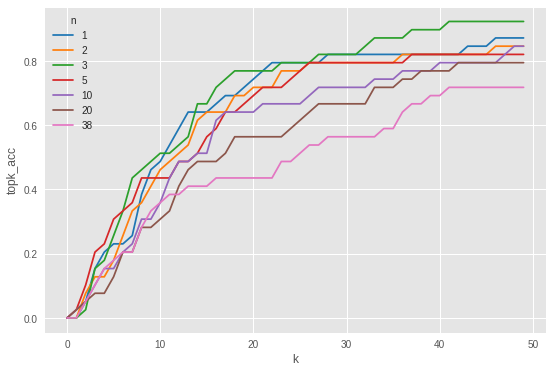

<IPython.core.display.Javascript object>

In [82]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.lineplot(data=lin_comb_results, x="k", y="topk_acc", hue="n", palette="tab10")
plt.show()

The plot above suggests suprisingly does not show any strong trend suggesting that a larger number of neighbors to consider is beneficial. In fact we only observe a signifanct drop in the performance when using all existing physical regulator embeddings to infer the translational mapping.

If one would like to keep the strongest baseline, we would probably choose $n=1$ as in practice we would be particular interested in the close proximity of the predicted location.

The plot below shows that the performance is significantly better than chance. The corresponding random baseline is established in a similar fashion as described above but the gene labels are randomly permuted in both the physical and the regulatory space. We repeat the procedure 100 times to estimate the uncertainty of the computed topk accuracies.

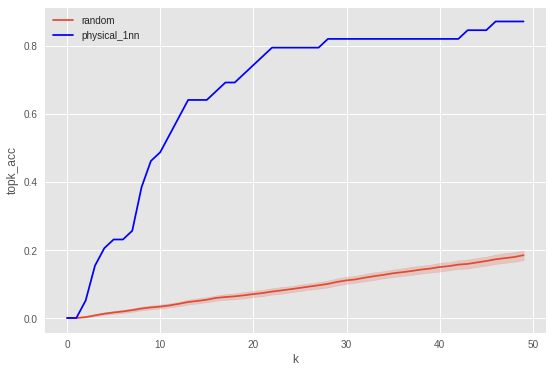

<IPython.core.display.Javascript object>

In [83]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.lineplot(
    data=random_lin_comb_results.loc[random_lin_comb_results.n == "1"],
    x="k",
    y="topk_acc",
    ax=ax,
    label="random",
)
ax.plot(
    np.array(lin_comb_results.loc[lin_comb_results.n == "1", "k"]),
    np.array(lin_comb_results.loc[lin_comb_results.n == "1", "topk_acc"]),
    label="physical_1nn",
    color="blue",
)
ax.legend()
plt.show()

---

### 2.2. Linear mean translation

As a second setup, we will train a linear model in a leave-one-target out setting for 1000 epochs.

In [84]:
nn = NearestNeighbors(n_neighbors=len(node_embs)).fit(np.array(node_embs))
nn_clf = CustomKNNClassifier(
    clf=nn, samples=np.array(list(node_embs.index)), ks=[1, 3, 5, 10, 20, 50]
)

<IPython.core.display.Javascript object>

---

In [85]:
data_dicts = get_logo_data_dicts(
    data=img_embs_fold0,
    labels=node_embs_fold0,
    val_size=0,
    group_labels=np.array(list(node_embs_fold0.index)),
    batch_size=32,
    balanced=False,
    scale_x=False,
    scale_y=False,
)

<IPython.core.display.Javascript object>

  0%|          | 0/39 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00023080302727114605
train top-k accuracies: {1: 0.763158, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0009675576584413648
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


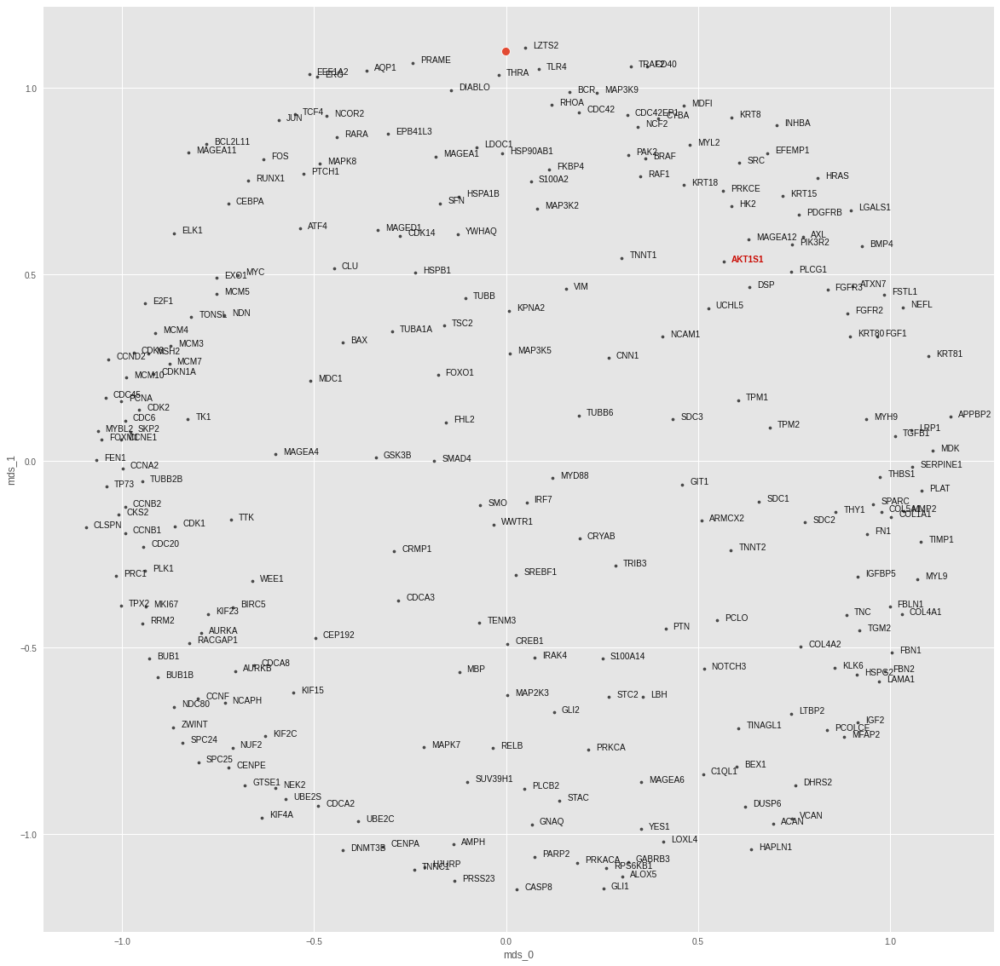

ATF4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00020551611822539648
train top-k accuracies: {1: 0.842105, 3: 0.947368, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.842105, 3: 0.947368, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0008543464355170727
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


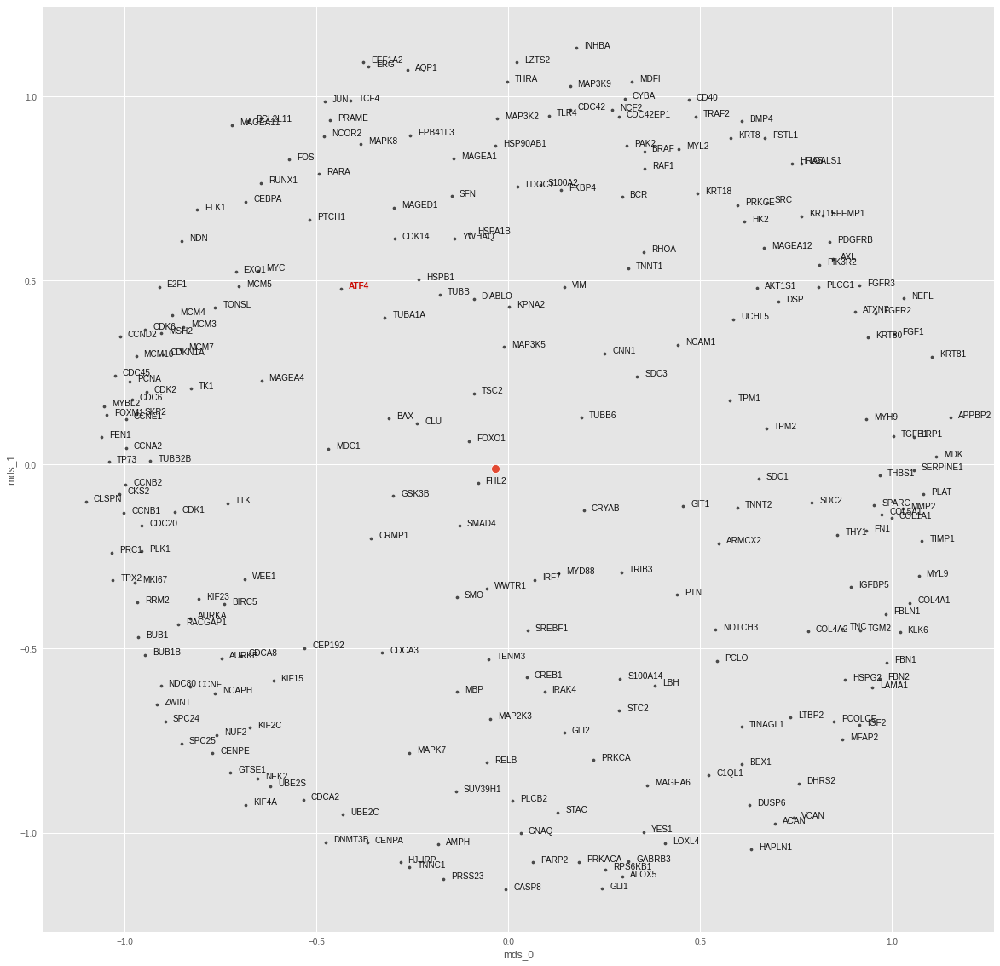

BAX
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002448705276229272
train top-k accuracies: {1: 0.789474, 3: 0.868421, 5: 0.921053, 10: 0.947368, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.868421, 5: 0.921053, 10: 0.947368, 20: 1.0, 50: 1.0}
test loss: 0.0008808384882286191
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


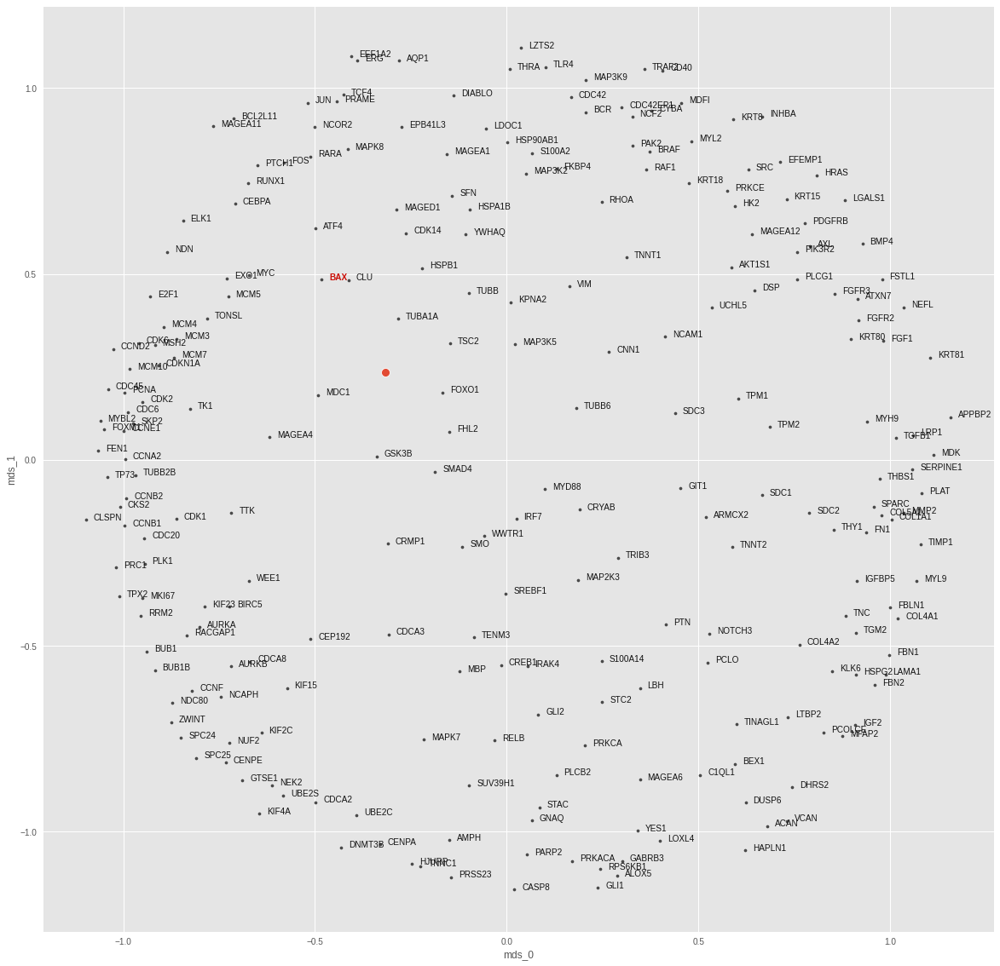

BCL2L11
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00028627992096038436
train top-k accuracies: {1: 0.684211, 3: 0.842105, 5: 0.868421, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.684211, 3: 0.842105, 5: 0.868421, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0007137180655263364
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


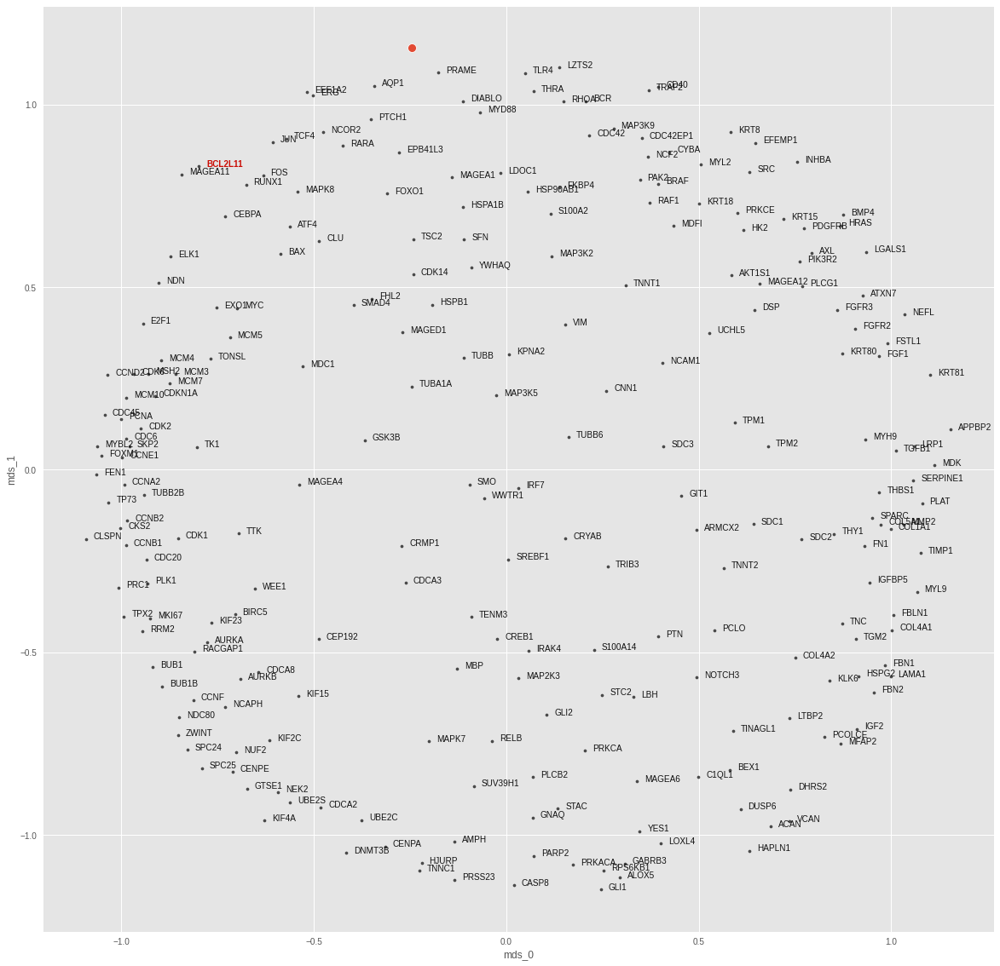

BRAF
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002139674738588694
train top-k accuracies: {1: 0.684211, 3: 0.947368, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.684211, 3: 0.947368, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00037900166353210807
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


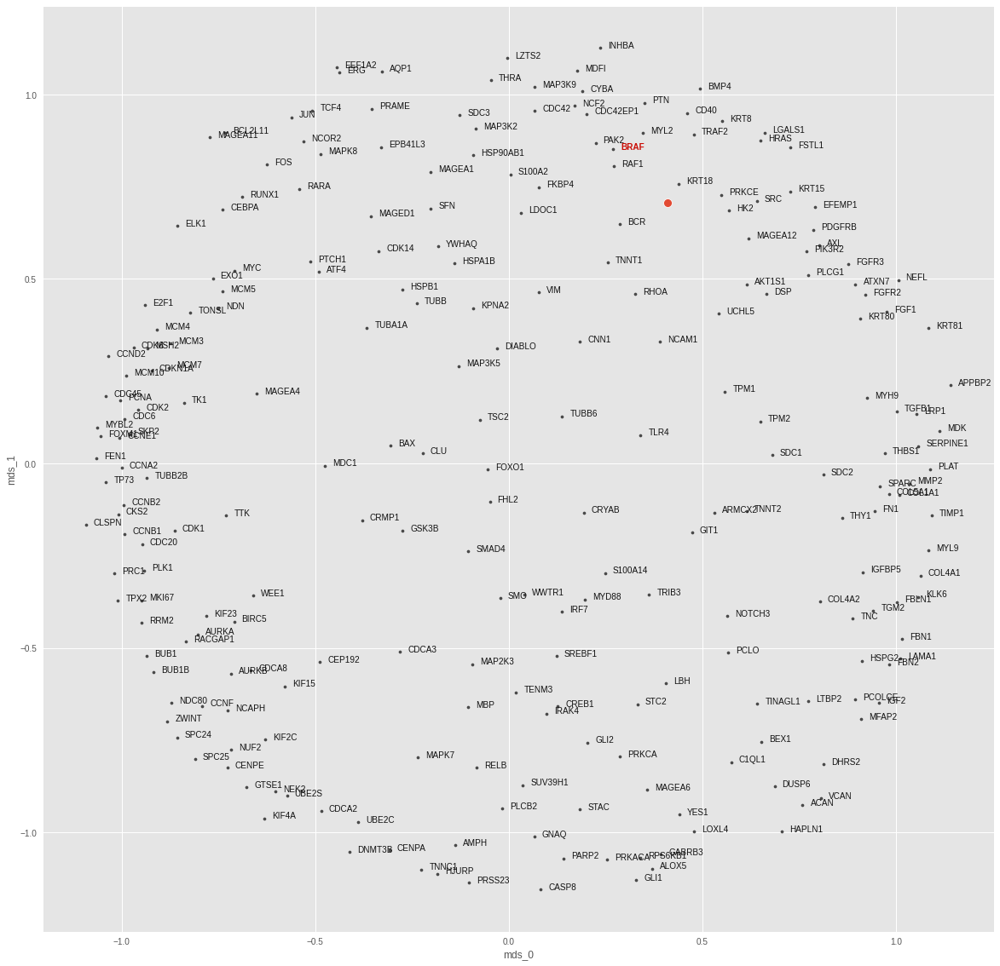

CASP8
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00022738171116399921
train top-k accuracies: {1: 0.789474, 3: 0.868421, 5: 0.947368, 10: 0.947368, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.868421, 5: 0.947368, 10: 0.947368, 20: 1.0, 50: 1.0}
test loss: 0.0012252721935510635
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


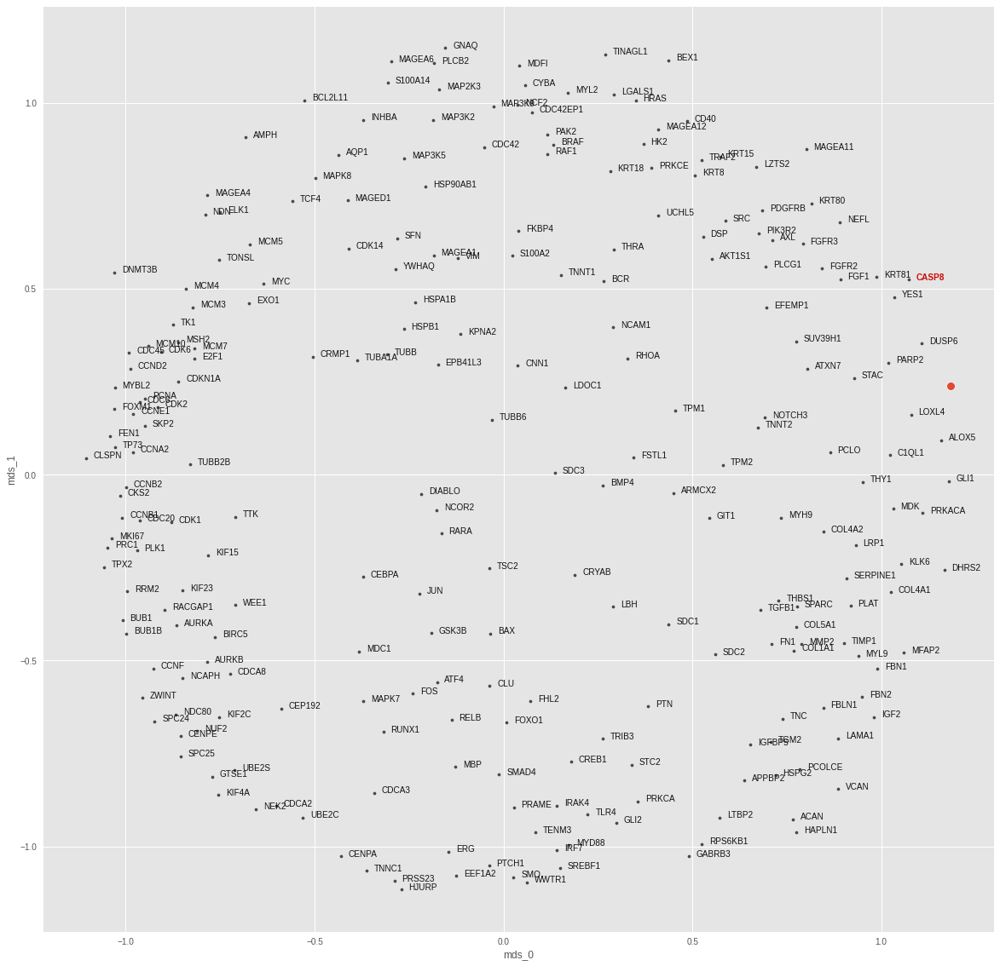

CDC42
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00024072047917319365
train top-k accuracies: {1: 0.736842, 3: 0.921053, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.921053, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0012802784331142902
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


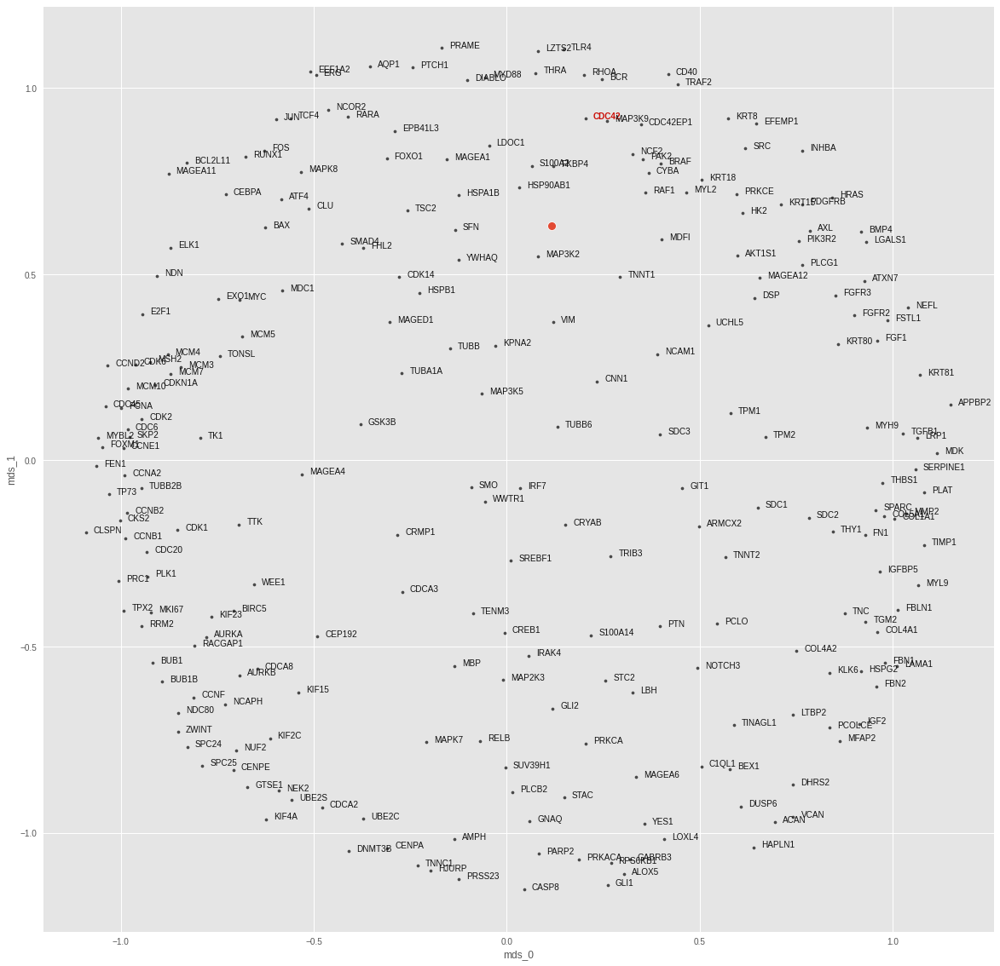

CDKN1A
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00021686103489053878
train top-k accuracies: {1: 0.815789, 3: 0.921053, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.815789, 3: 0.921053, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.002127869985997677
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


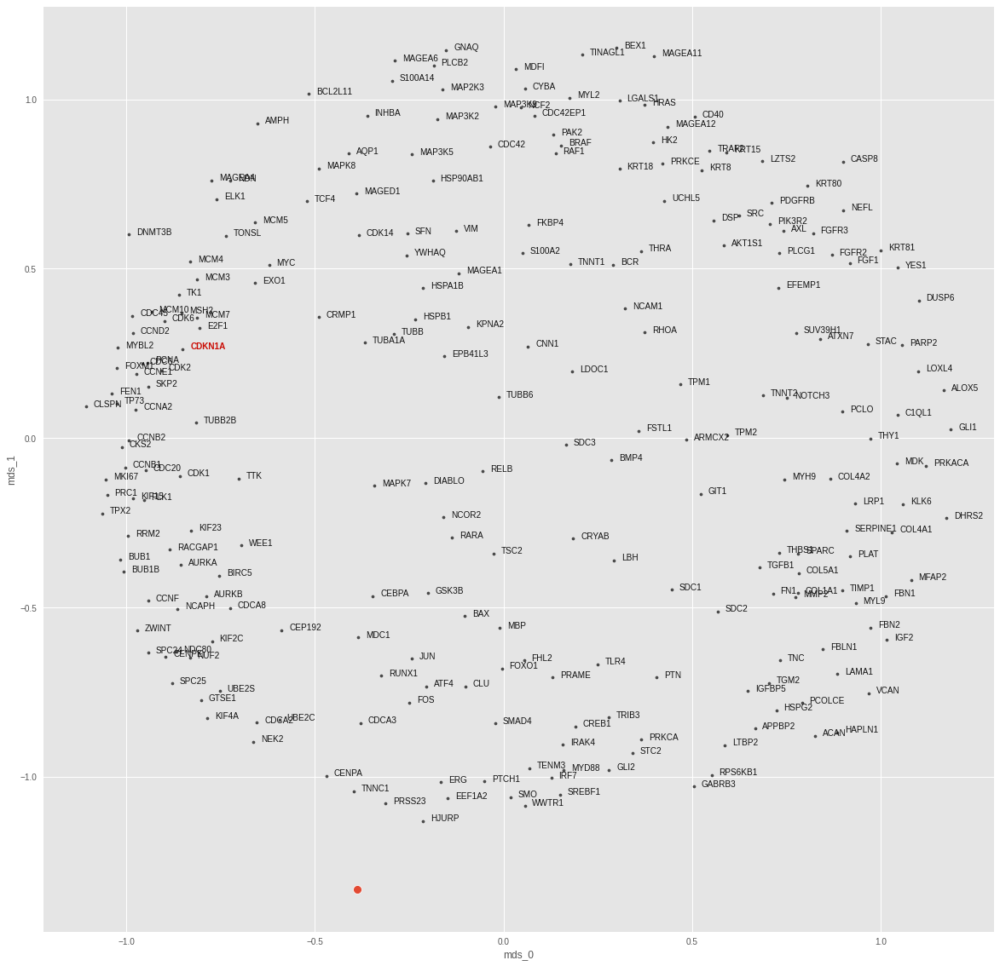

CEBPA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.000272449695713524
train top-k accuracies: {1: 0.842105, 3: 0.921053, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.842105, 3: 0.921053, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0018991203978657722
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


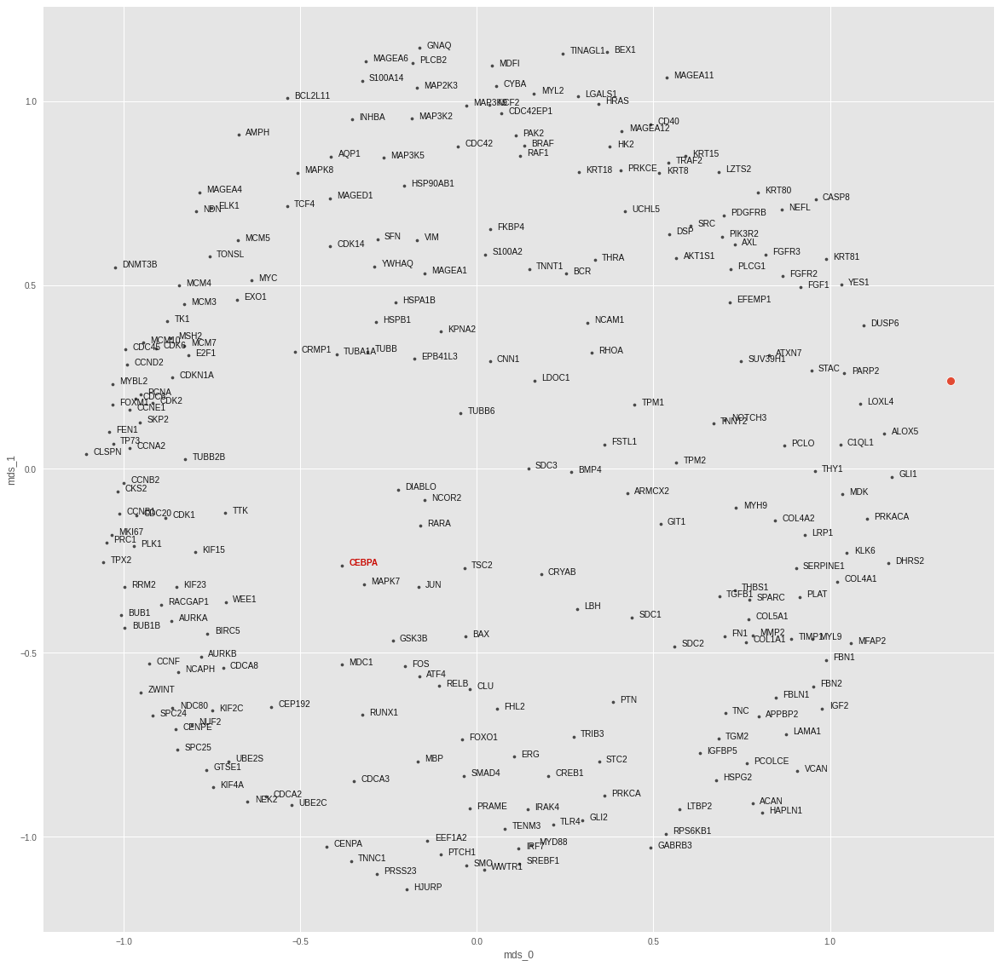

CREB1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00018974998046791084
train top-k accuracies: {1: 0.815789, 3: 0.947368, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.815789, 3: 0.947368, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0010589836165308952
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


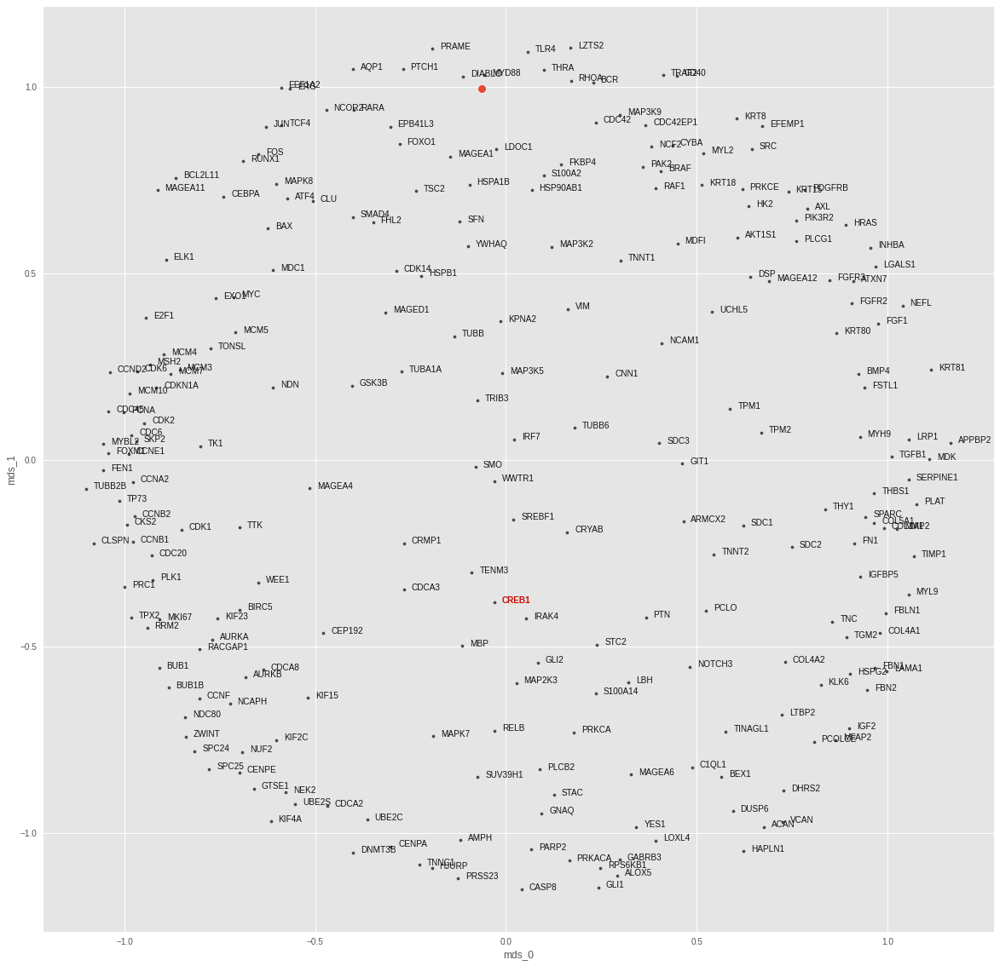

DIABLO
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00023953855730054018
train top-k accuracies: {1: 0.710526, 3: 0.921053, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.710526, 3: 0.921053, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0005815635668113828
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


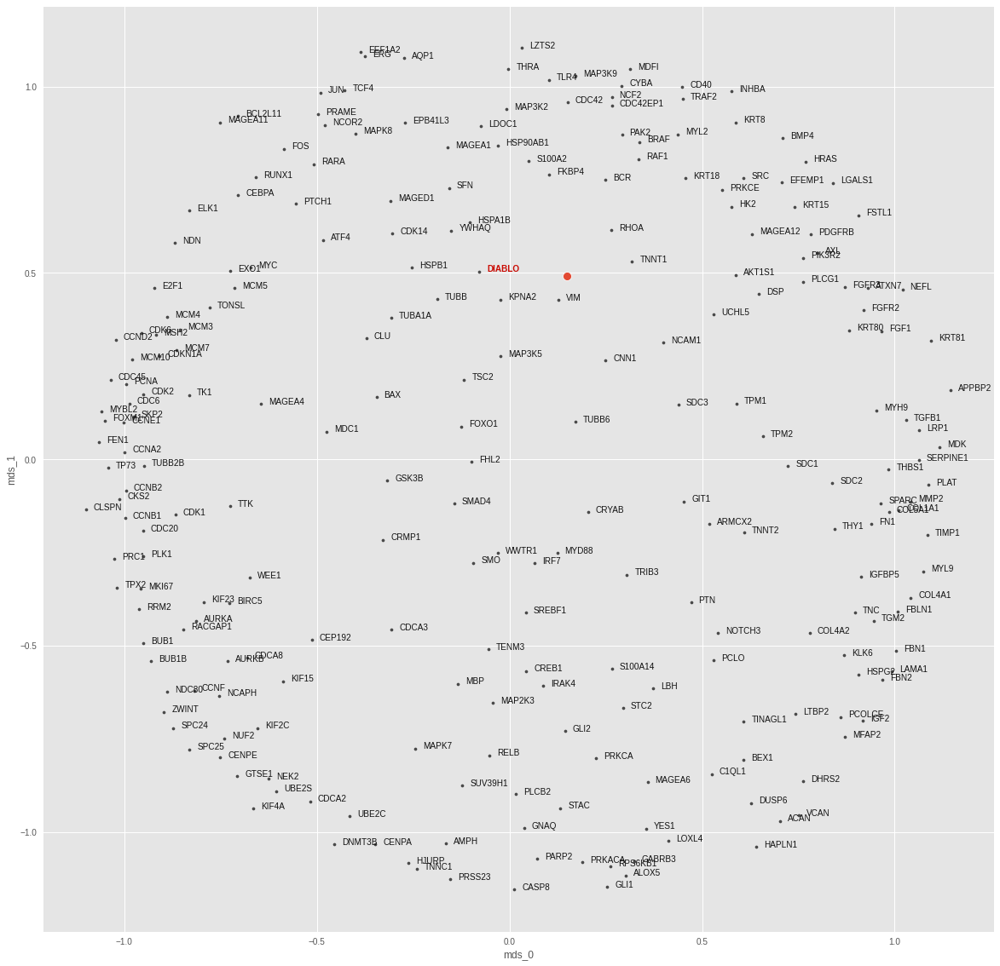

E2F1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002596473603166248
train top-k accuracies: {1: 0.605263, 3: 0.868421, 5: 0.894737, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.605263, 3: 0.868421, 5: 0.894737, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0014591400977224112
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


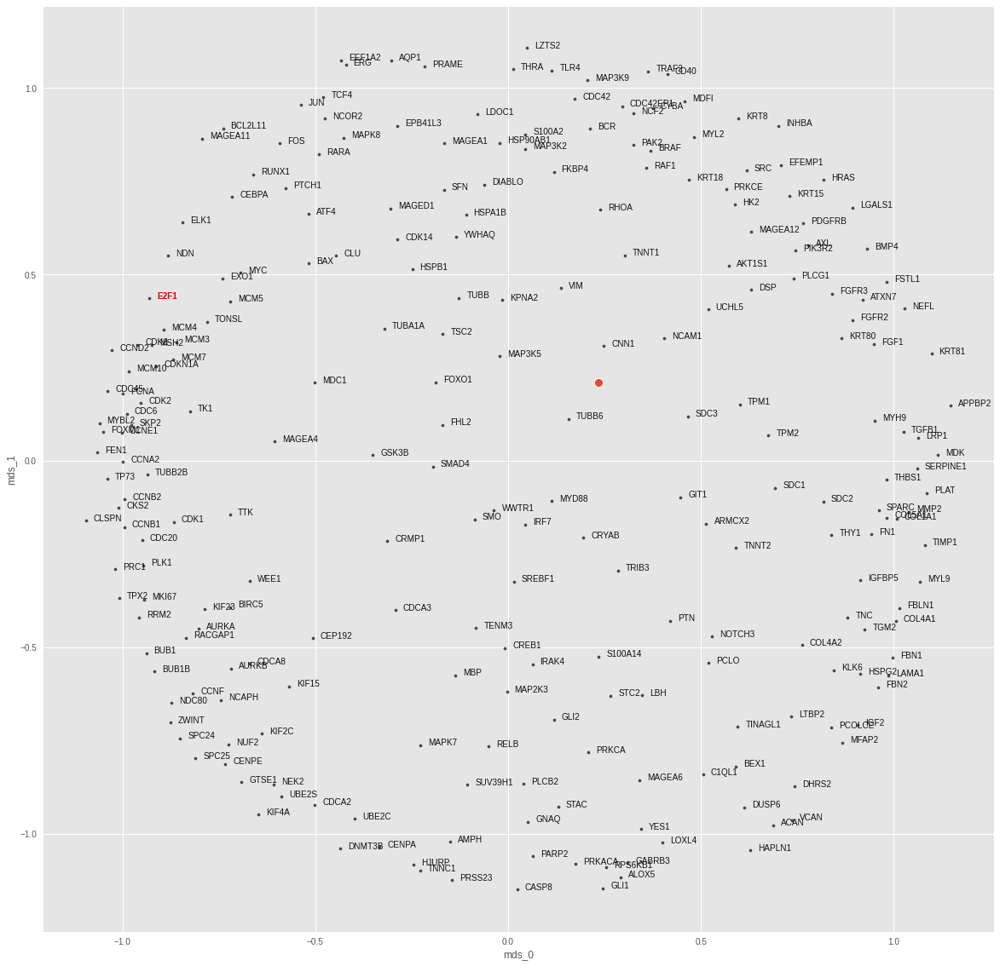

ELK1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00024900284877635146
train top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.947368, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.894737, 5: 0.947368, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001187184127047658
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


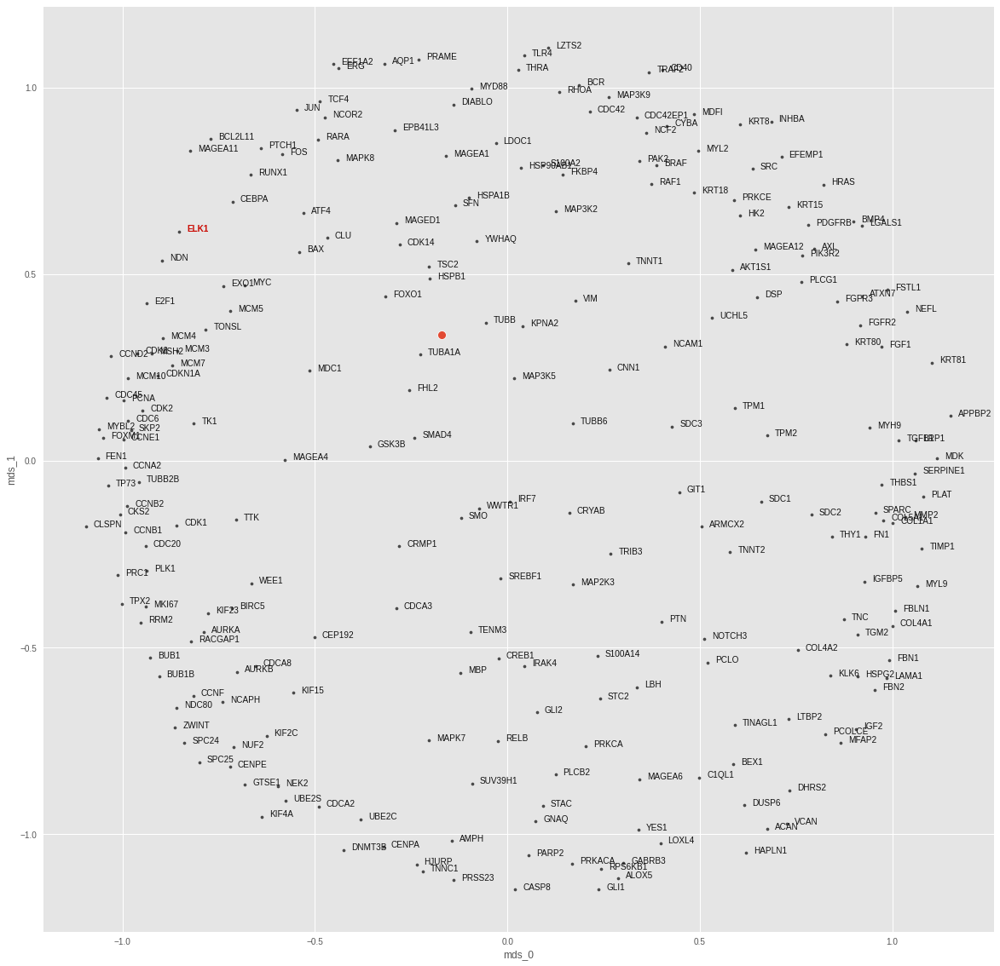

ERG
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00021046343164542983
train top-k accuracies: {1: 0.842105, 3: 0.947368, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.842105, 3: 0.947368, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0013557163765653968
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


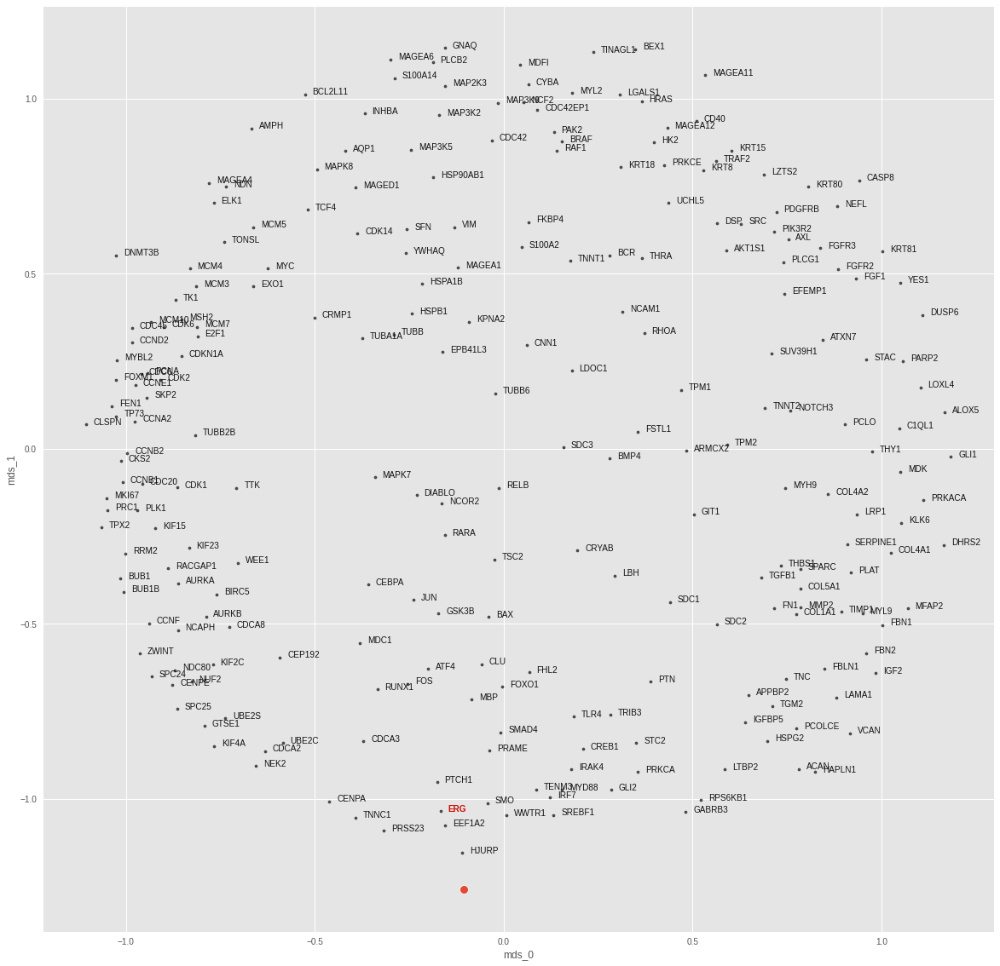

FGFR3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00027124768224128177
train top-k accuracies: {1: 0.710526, 3: 0.868421, 5: 0.894737, 10: 0.947368, 20: 0.947368, 50: 1.0}
train mean top-k accuracies: {1: 0.710526, 3: 0.868421, 5: 0.894737, 10: 0.947368, 20: 0.947368, 50: 1.0}
test loss: 0.0008766866521909833
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


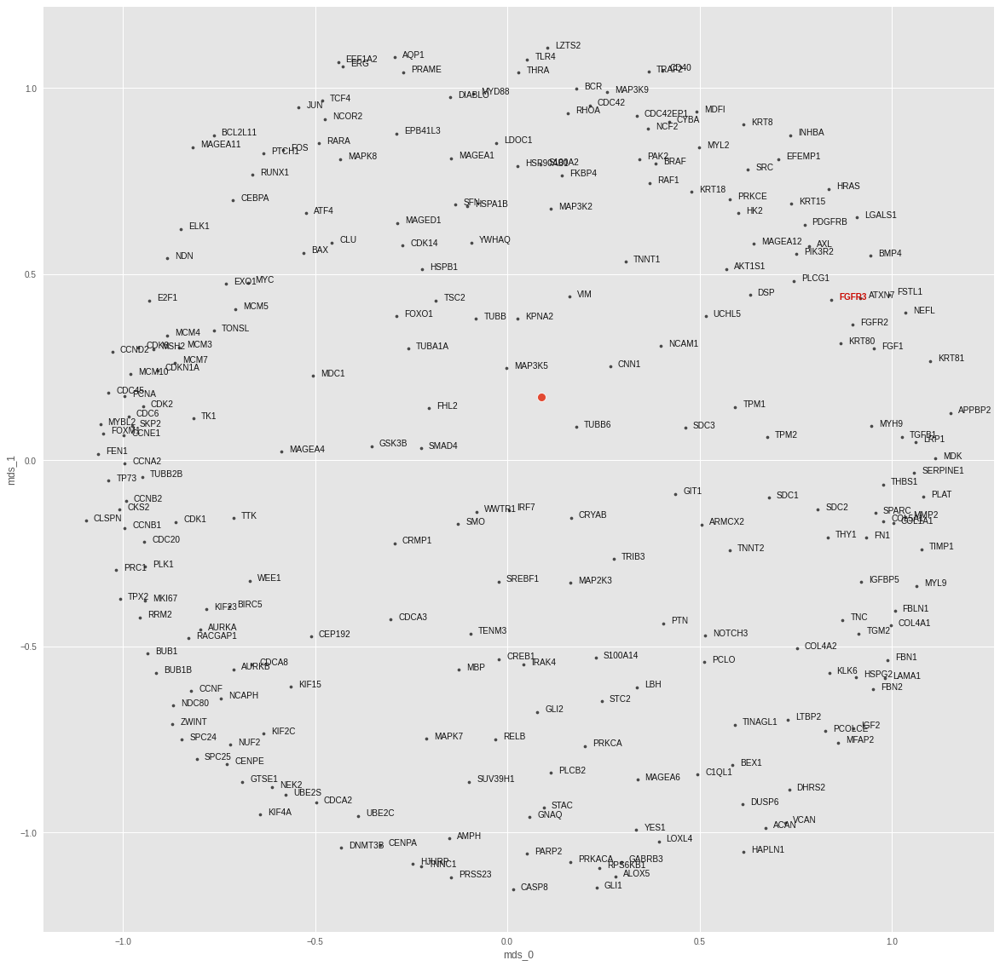

FOXO1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002151023501554798
train top-k accuracies: {1: 0.763158, 3: 0.947368, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.947368, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0003768402093555778
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


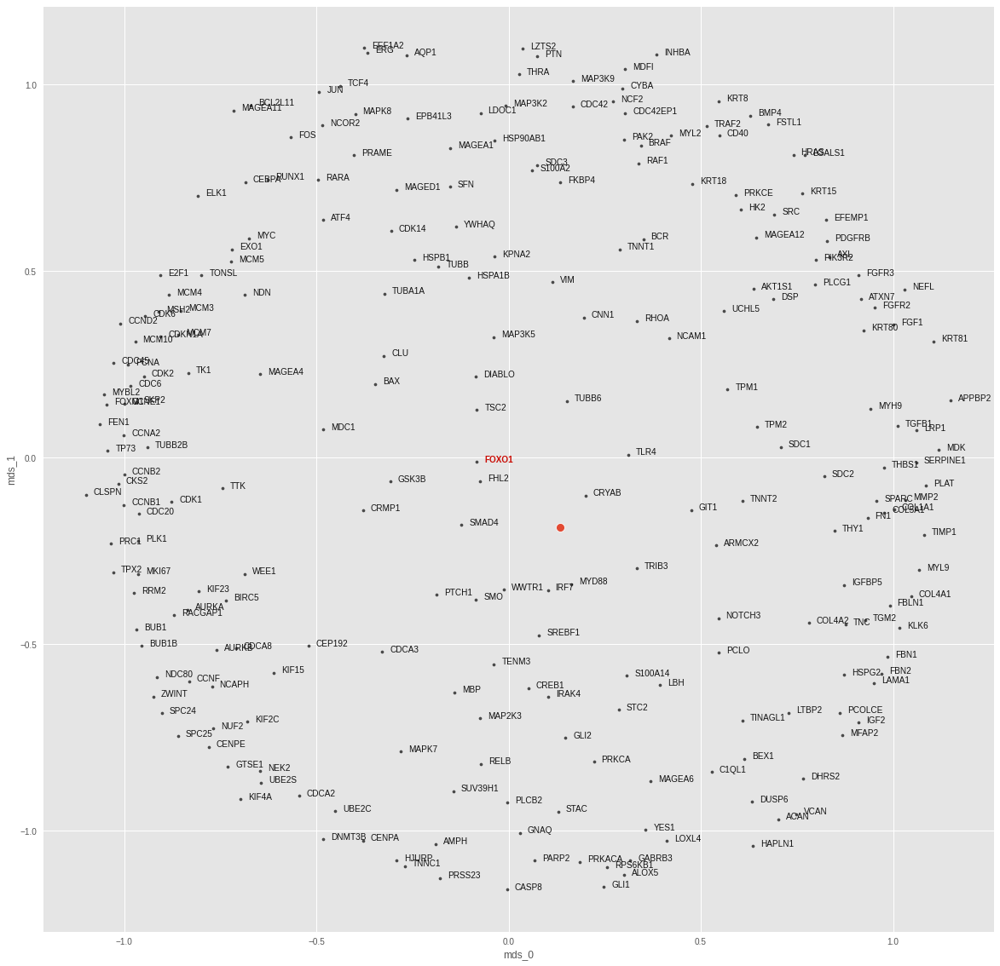

GLI1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00019684678792193728
train top-k accuracies: {1: 0.842105, 3: 0.947368, 5: 0.947368, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.842105, 3: 0.947368, 5: 0.947368, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0019043001811951399
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


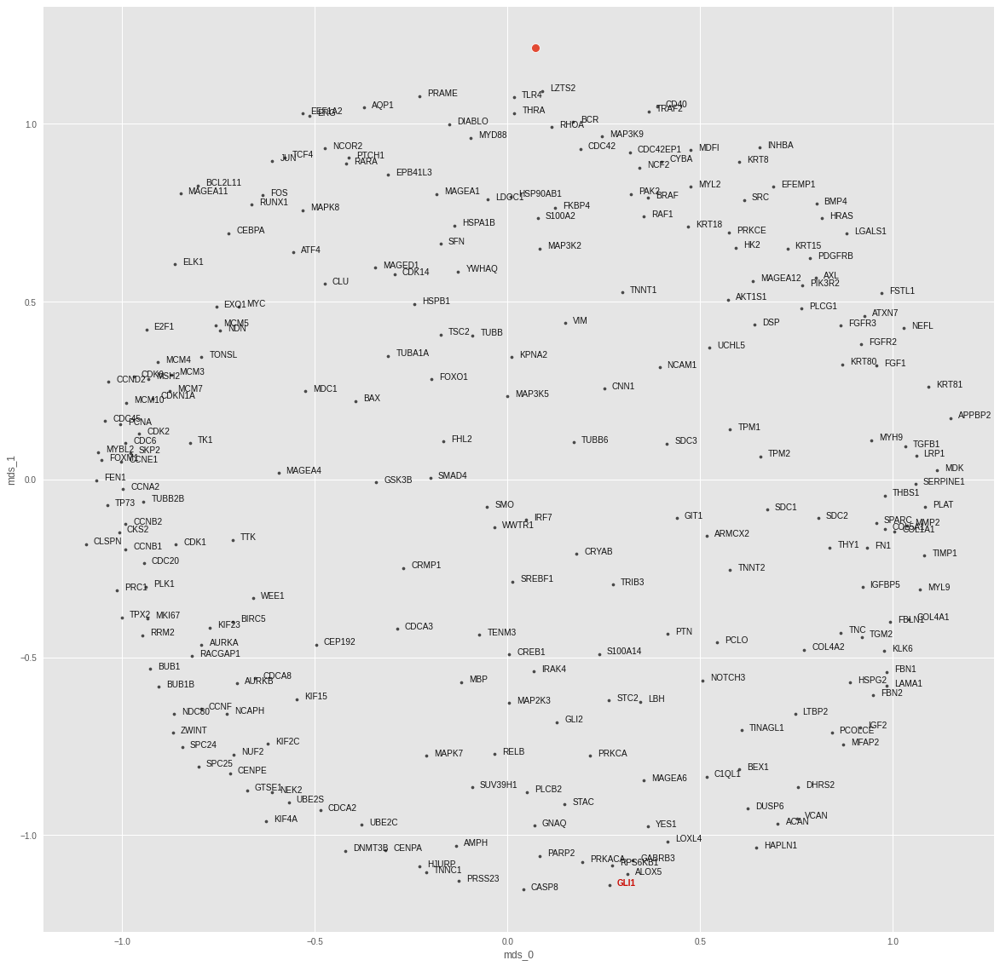

HRAS
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00022596505387857753
train top-k accuracies: {1: 0.789474, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002551313489675522
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


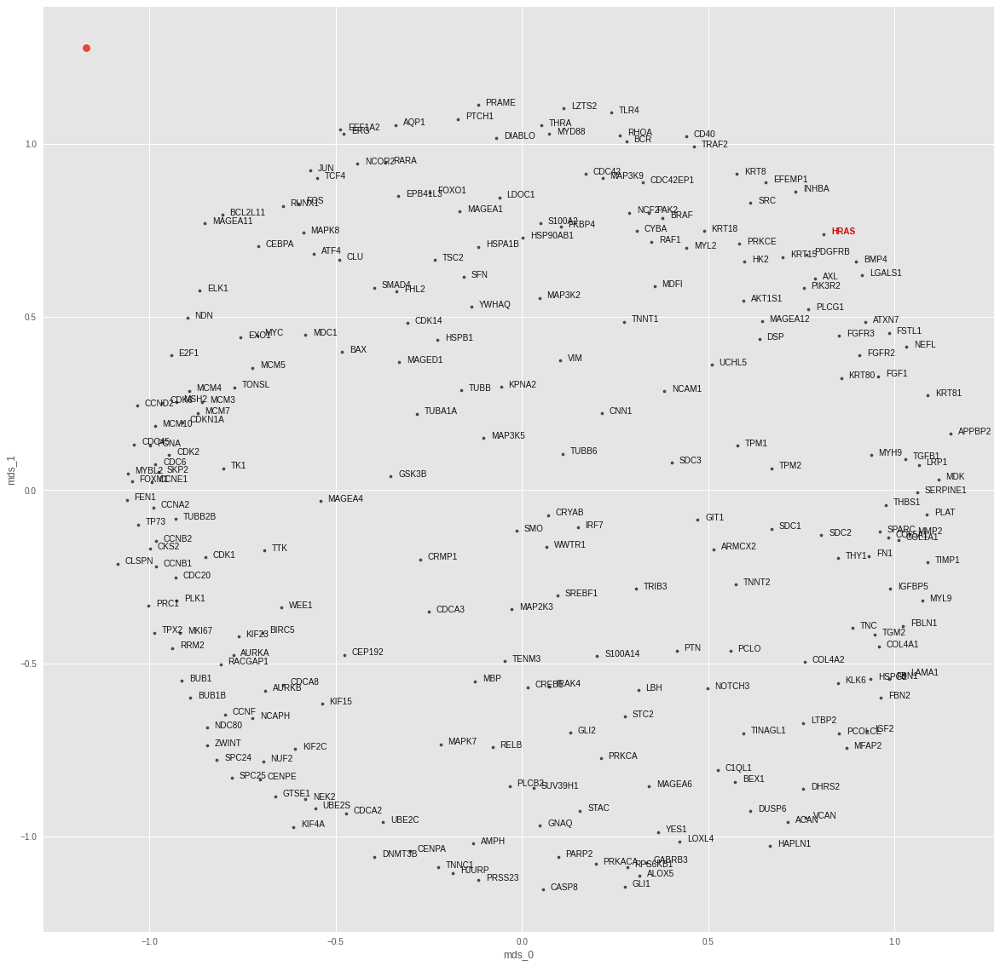

IRAK4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00023800339917407225
train top-k accuracies: {1: 0.789474, 3: 0.921053, 5: 0.921053, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.921053, 5: 0.921053, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0006828894838690758
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


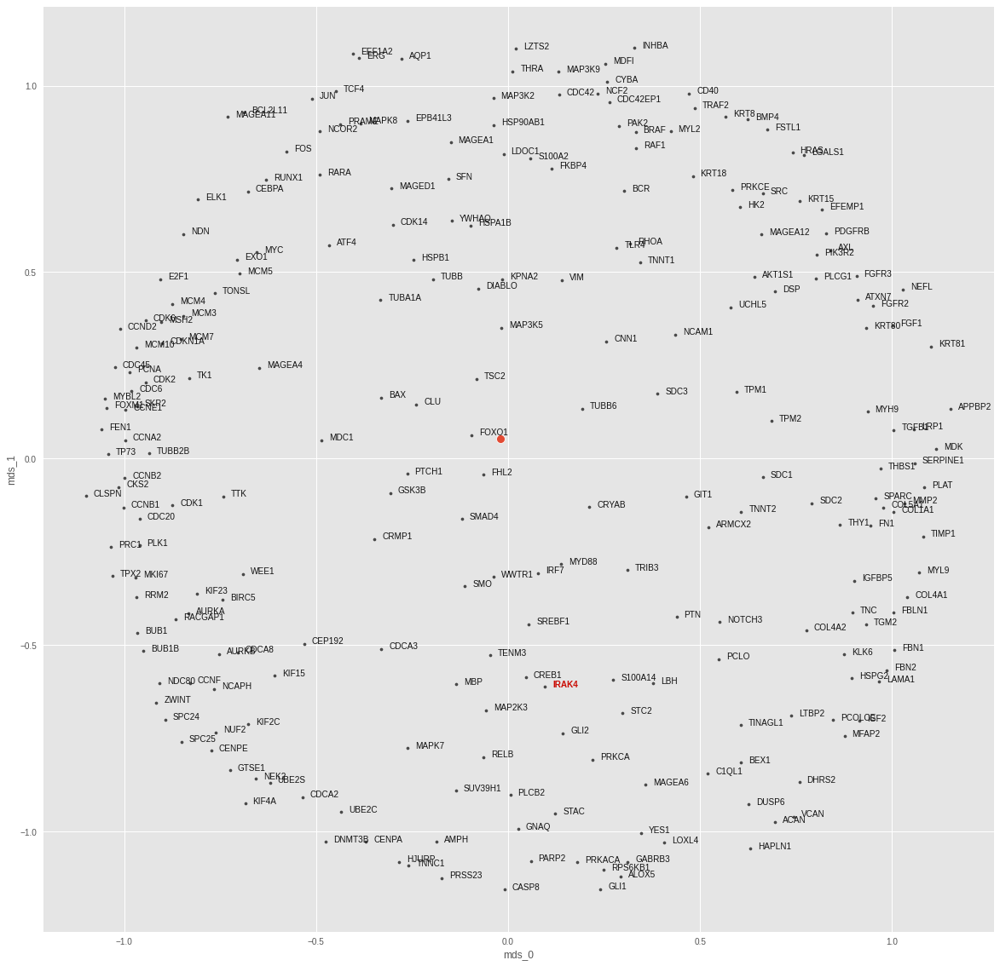

JUN
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002663138117273583
train top-k accuracies: {1: 0.710526, 3: 0.921053, 5: 0.947368, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.710526, 3: 0.921053, 5: 0.947368, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0021642534993588924
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


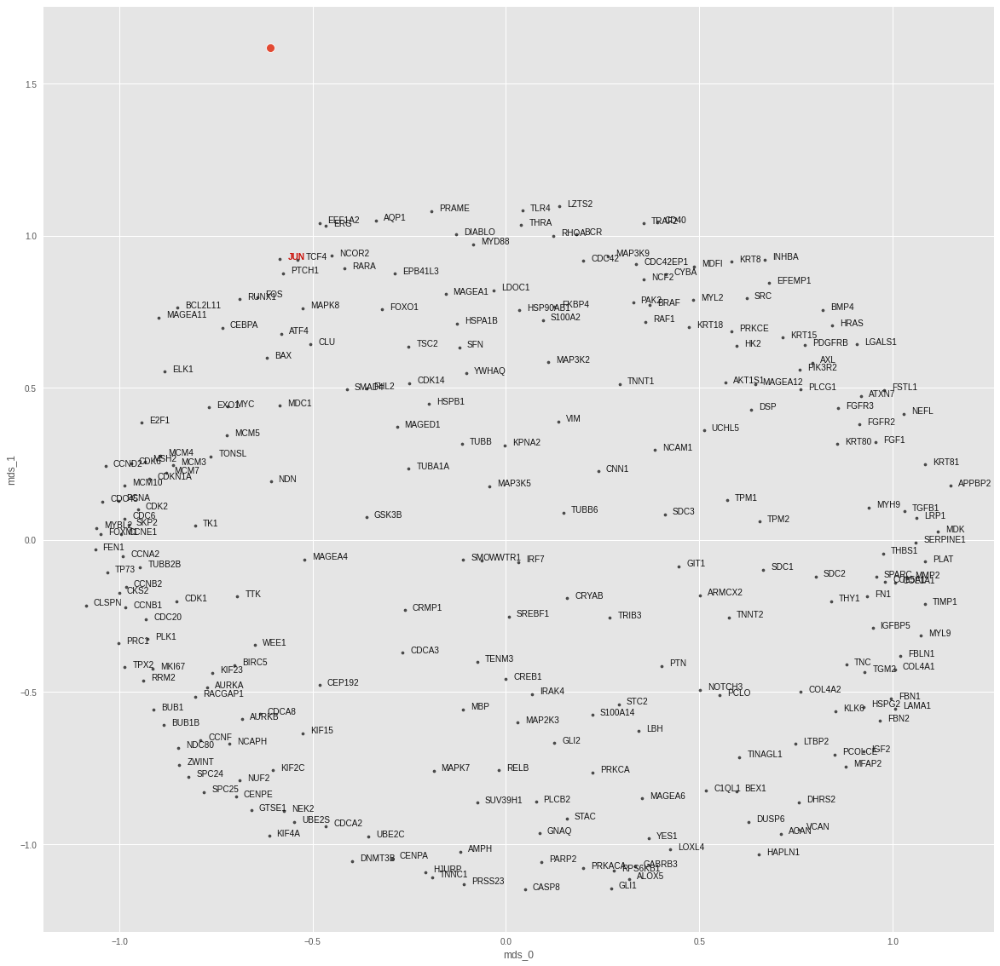

MAP2K3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002514198315207307
train top-k accuracies: {1: 0.684211, 3: 0.894737, 5: 0.947368, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.684211, 3: 0.894737, 5: 0.947368, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001242391299456358
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


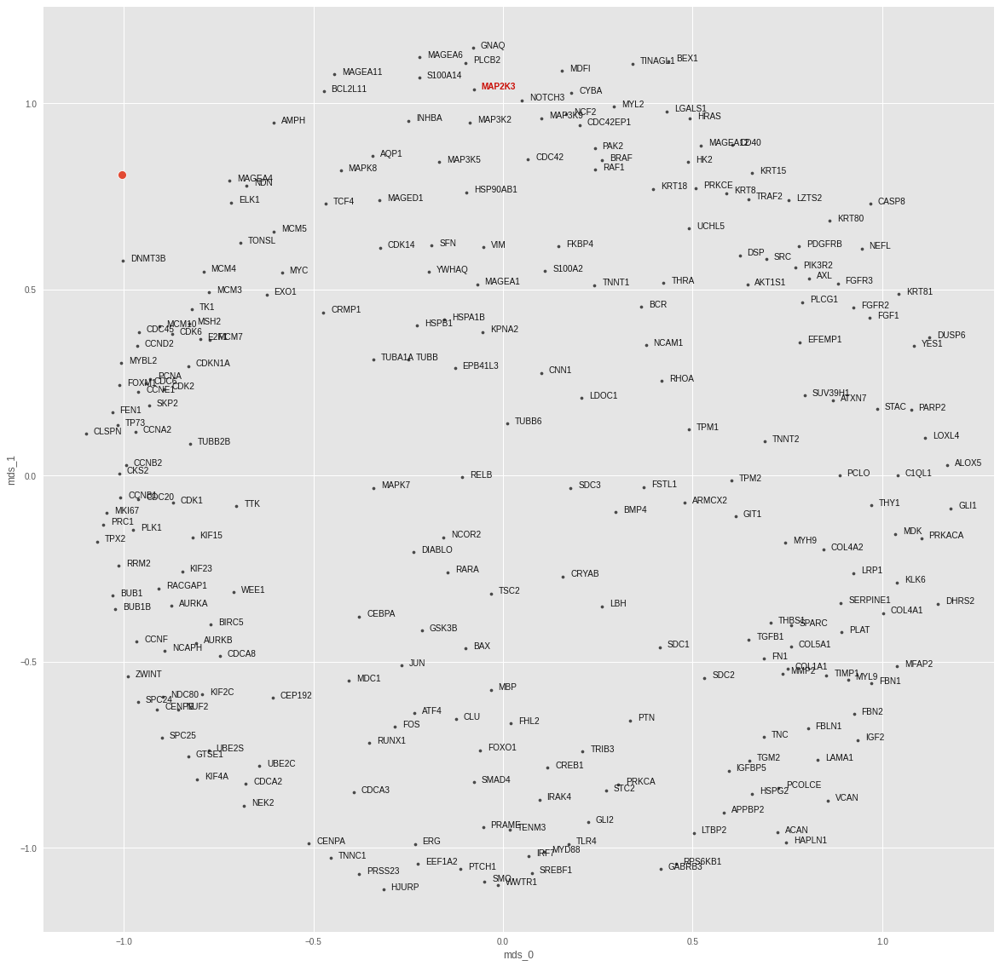

MAP3K2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00018890280778960963
train top-k accuracies: {1: 0.763158, 3: 0.947368, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.947368, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00044310904922895133
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


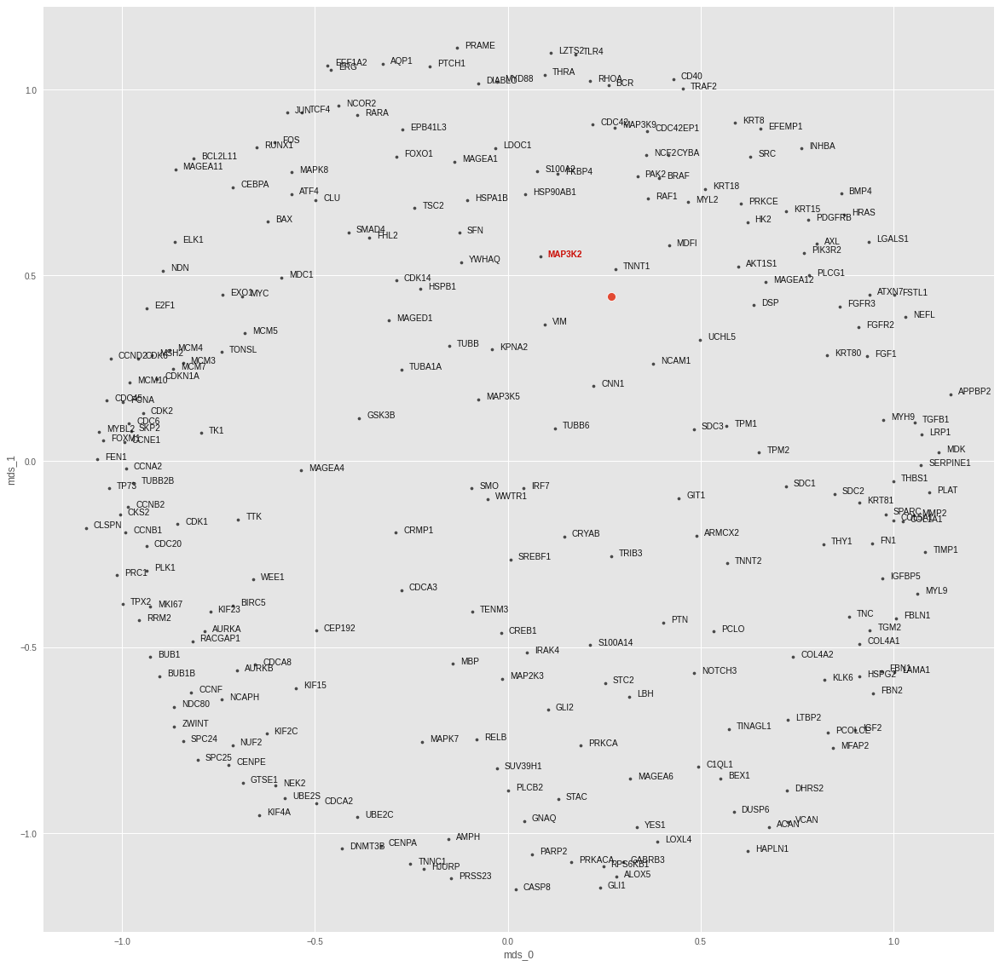

MAP3K5
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00024038978230428735
train top-k accuracies: {1: 0.710526, 3: 0.921053, 5: 0.947368, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.710526, 3: 0.921053, 5: 0.947368, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0006938930600881577
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


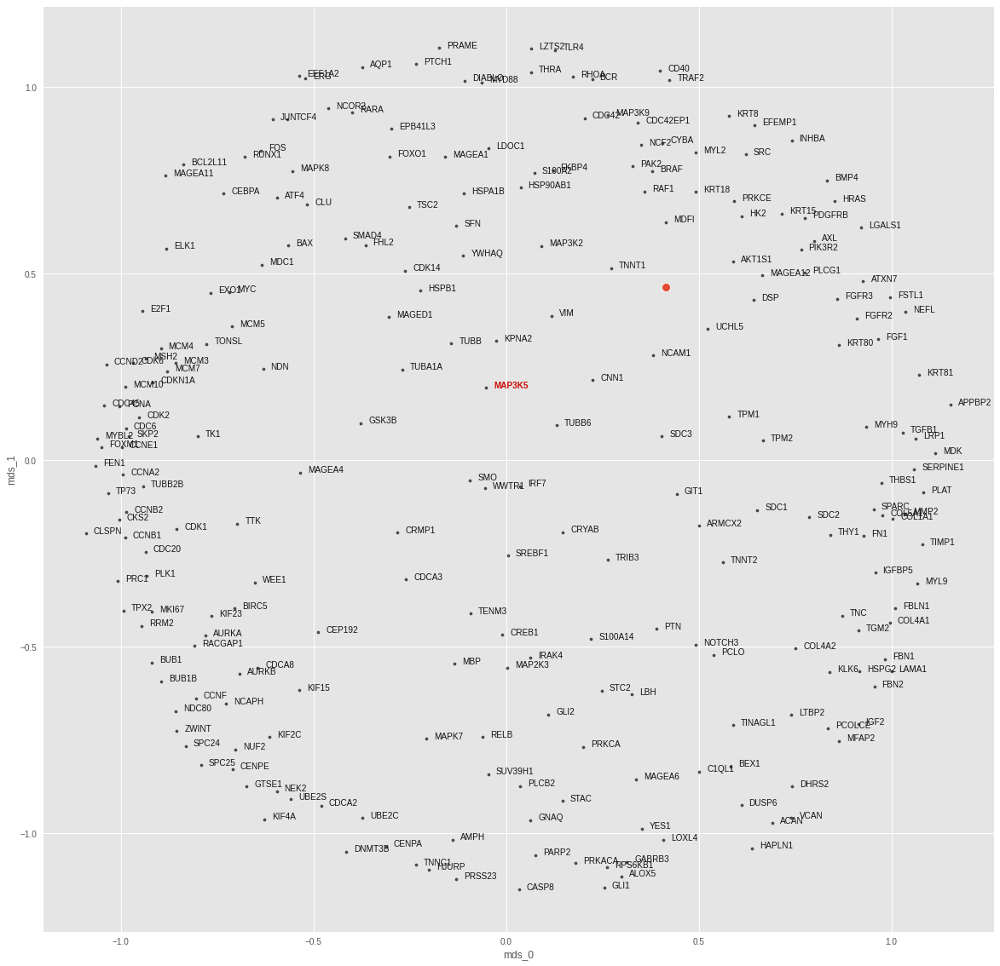

MAP3K9
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002355614545338444
train top-k accuracies: {1: 0.789474, 3: 0.894737, 5: 0.947368, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.894737, 5: 0.947368, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0006784491706639528
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


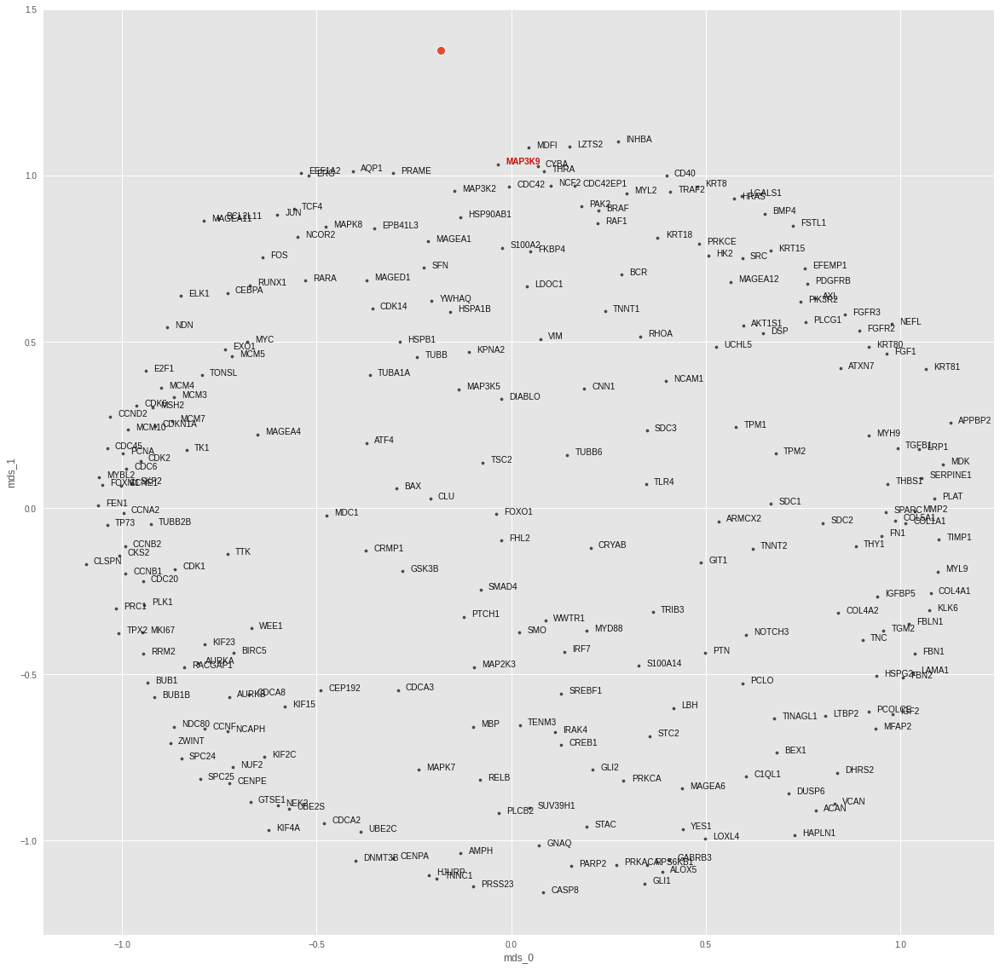

MAPK7
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00025221905640424475
train top-k accuracies: {1: 0.684211, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.684211, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0010213404893875122
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


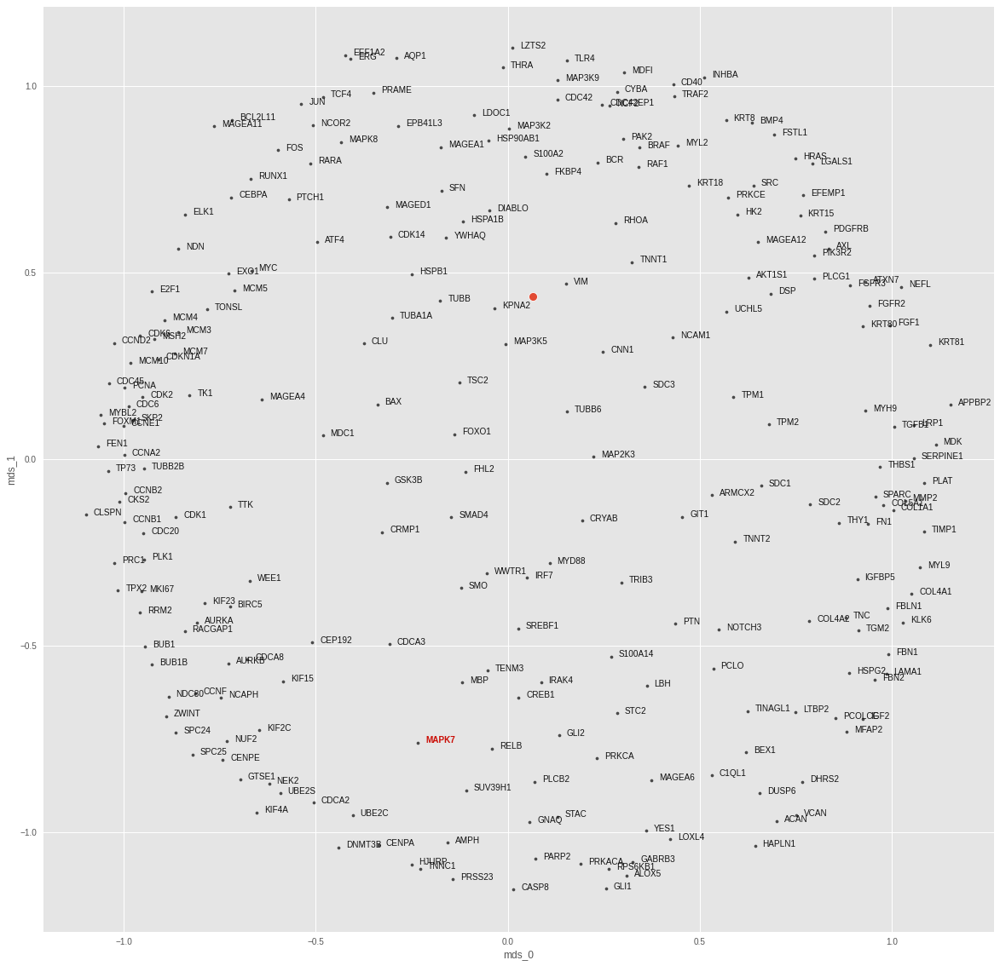

MYD88
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002545042240710341
train top-k accuracies: {1: 0.684211, 3: 0.894737, 5: 0.947368, 10: 0.947368, 20: 0.973684, 50: 1.0}
train mean top-k accuracies: {1: 0.684211, 3: 0.894737, 5: 0.947368, 10: 0.947368, 20: 0.973684, 50: 1.0}
test loss: 0.0011543389409780502
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


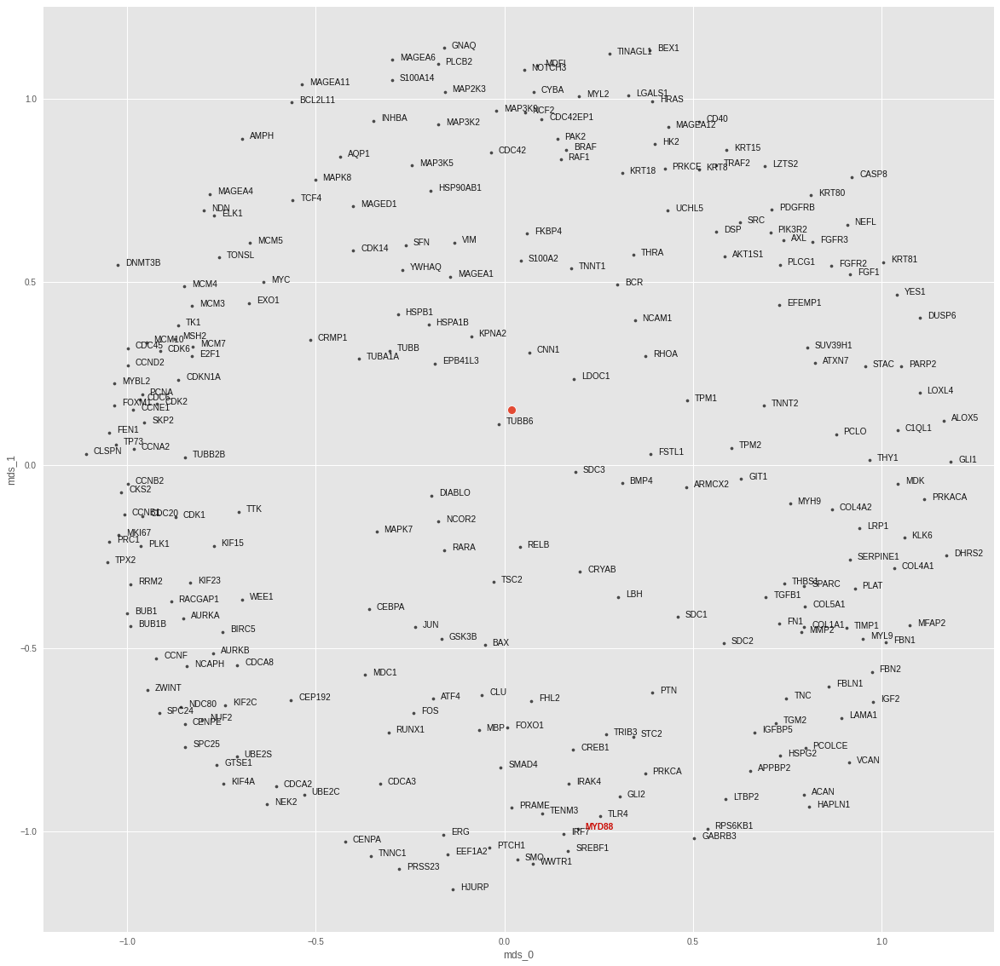

PIK3R2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002976377206658454
train top-k accuracies: {1: 0.631579, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
train mean top-k accuracies: {1: 0.631579, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 0.973684, 50: 1.0}
test loss: 0.0004250119673088193
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


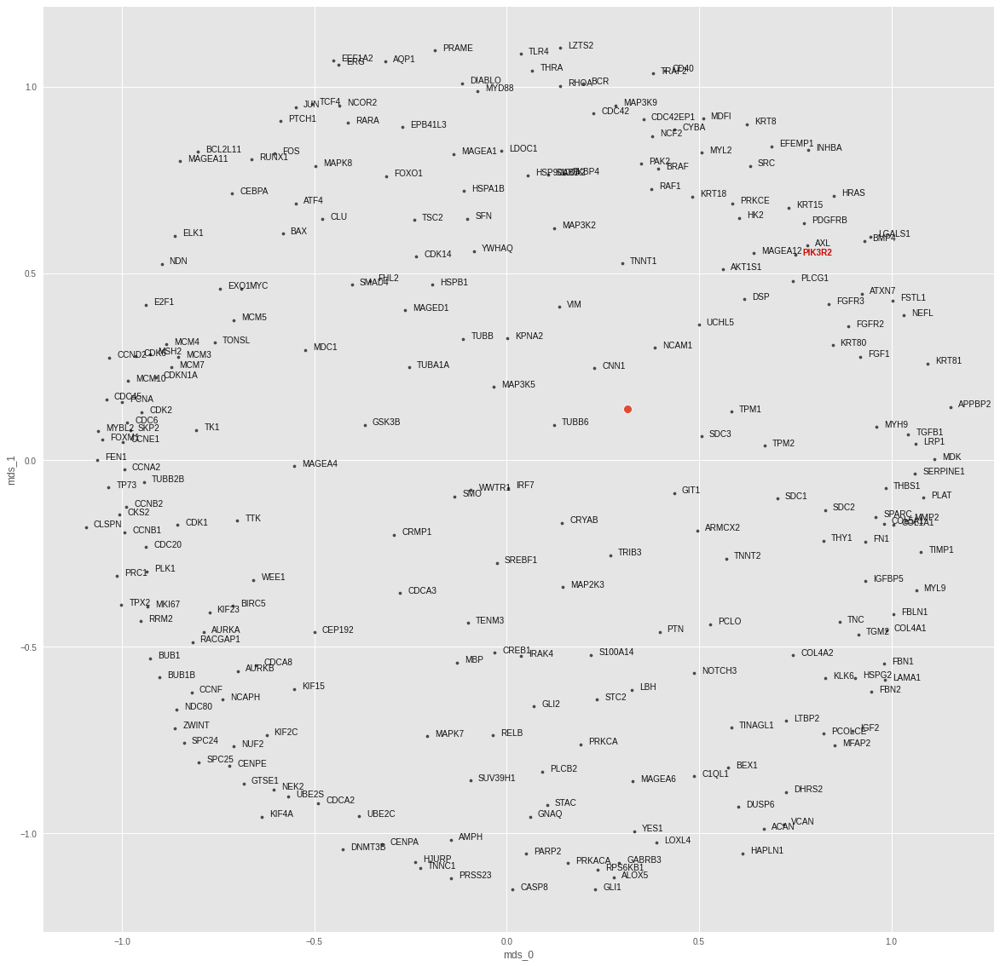

PRKACA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002127238380796227
train top-k accuracies: {1: 0.736842, 3: 0.842105, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.736842, 3: 0.842105, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0012789051979780197
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


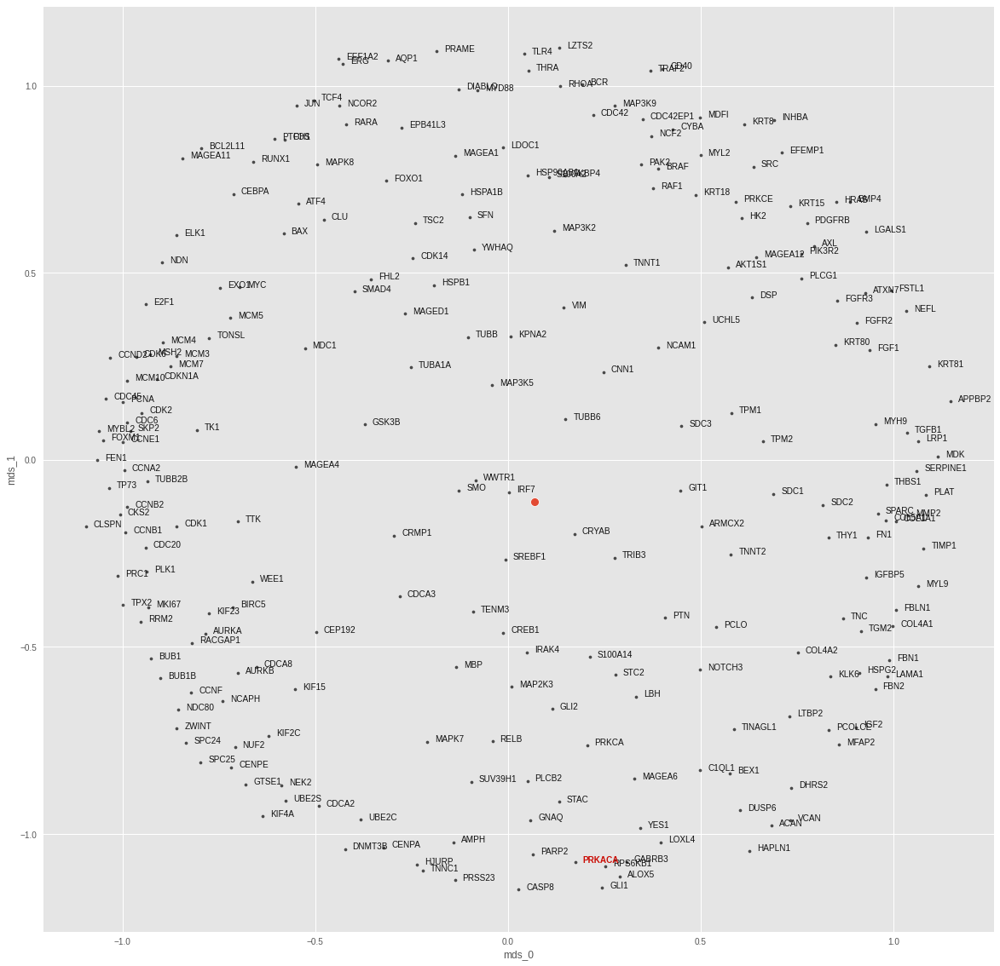

PRKCE
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00022630552810273672
train top-k accuracies: {1: 0.763158, 3: 0.921053, 5: 0.947368, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.921053, 5: 0.947368, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0007097605848684907
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


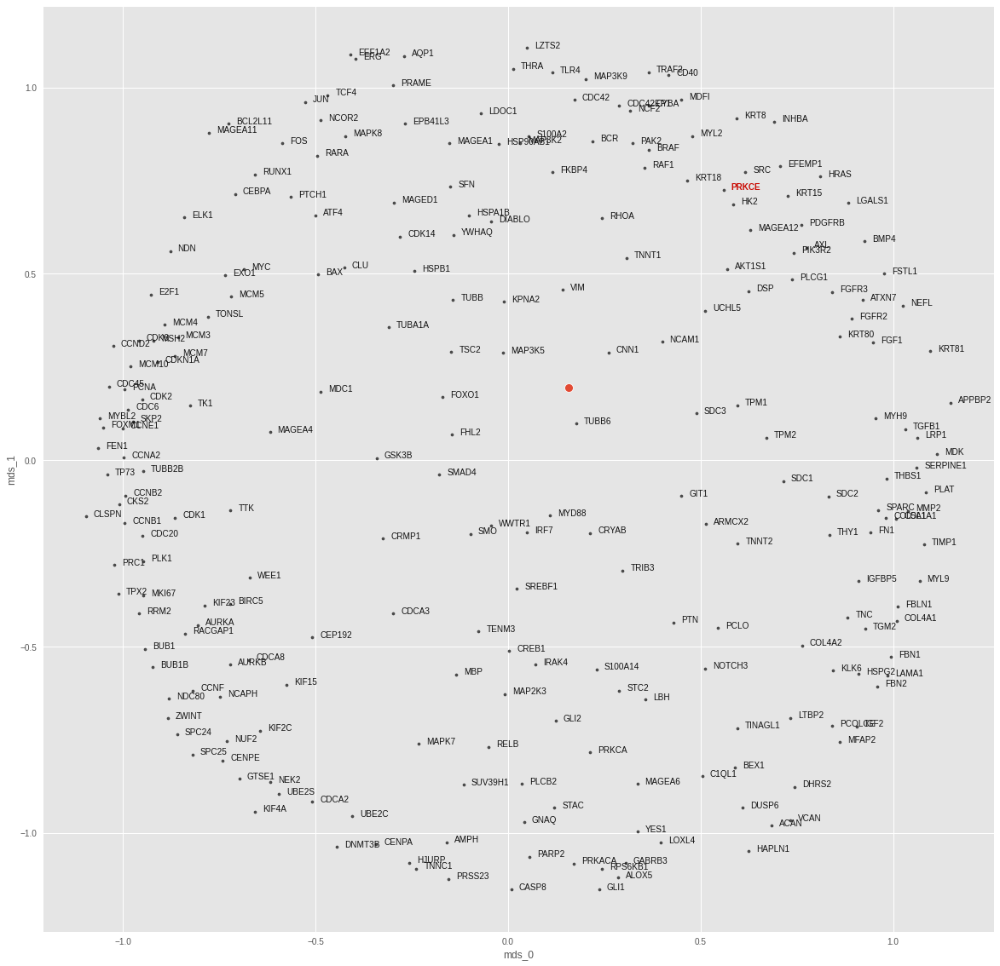

RAF1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002545813622418791
train top-k accuracies: {1: 0.657895, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.657895, 3: 0.894737, 5: 0.921053, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0008455615025013685
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


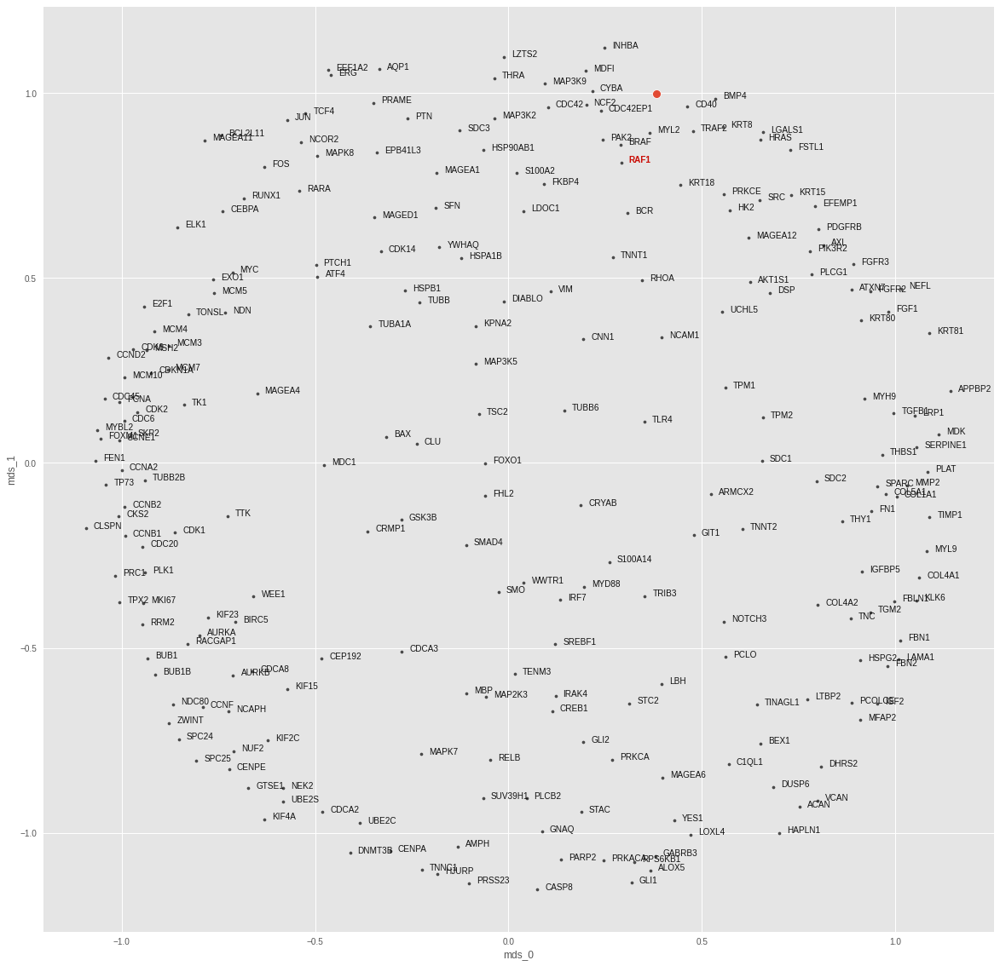

RELB
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00021965052139038513
train top-k accuracies: {1: 0.815789, 3: 0.947368, 5: 0.947368, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.815789, 3: 0.947368, 5: 0.947368, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0012192244175821543
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


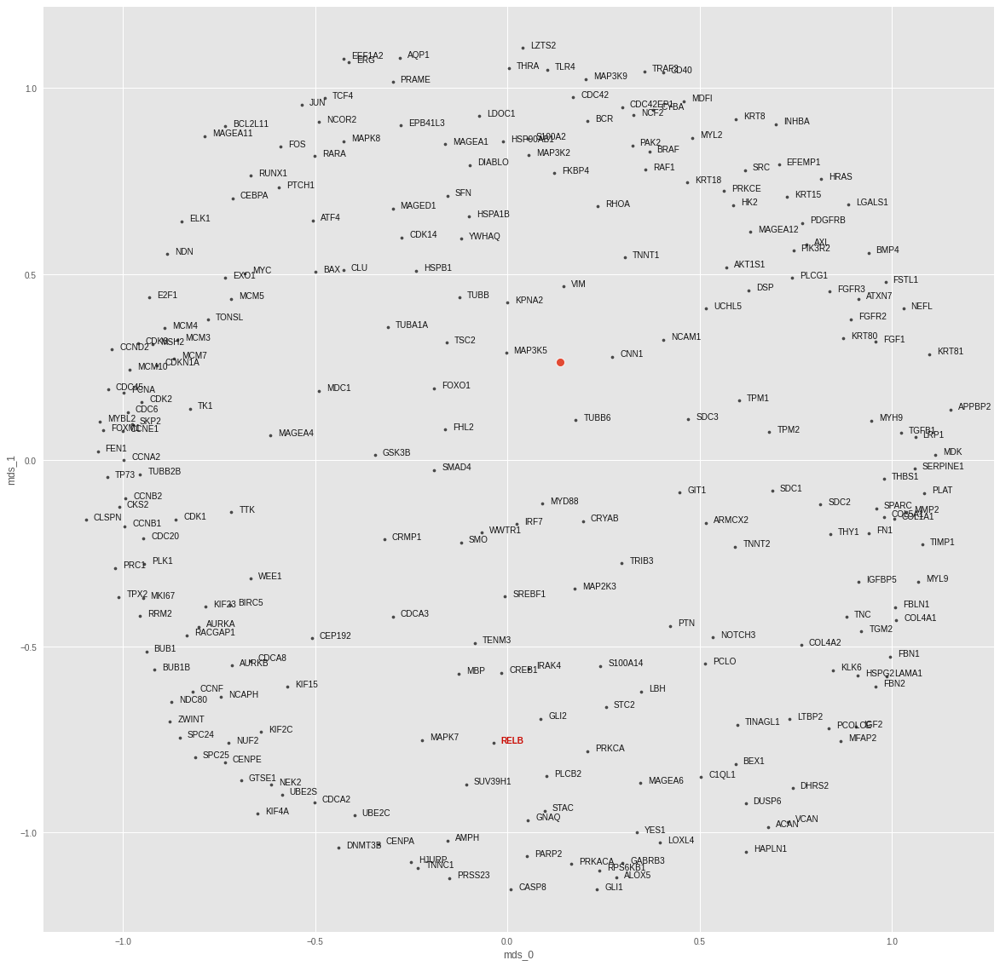

RHOA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002080559145389615
train top-k accuracies: {1: 0.789474, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.789474, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0008171737426891923
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


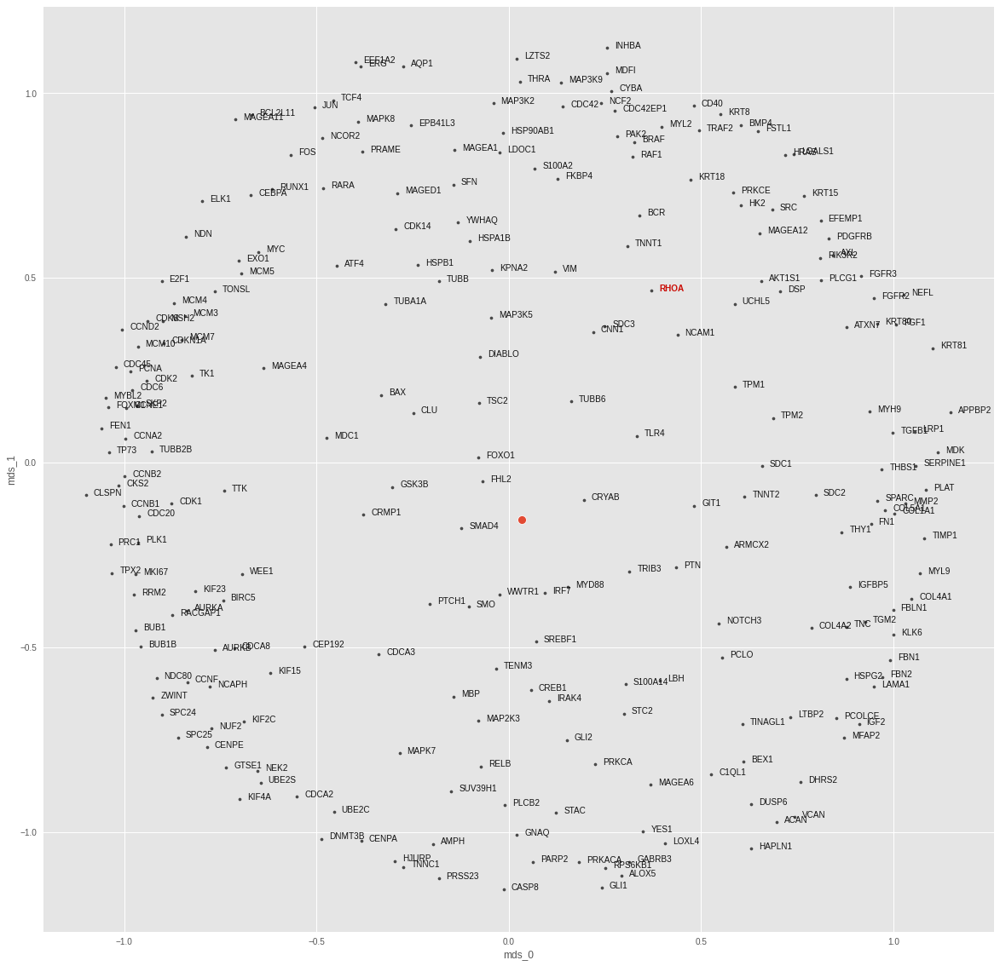

SMAD4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00025165239869812995
train top-k accuracies: {1: 0.815789, 3: 0.868421, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.815789, 3: 0.868421, 5: 0.973684, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0007671716157346964
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


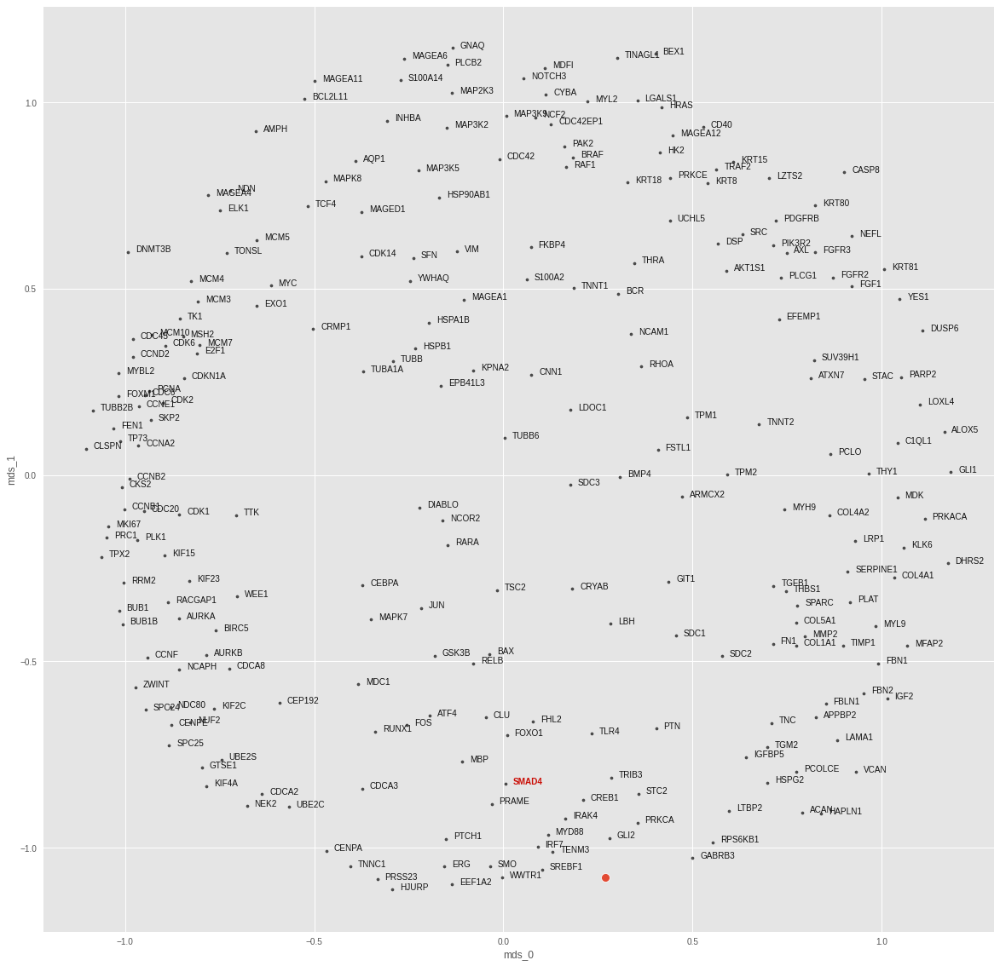

SMO
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00020023022998908631
train top-k accuracies: {1: 0.815789, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.815789, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0006440108409151435
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


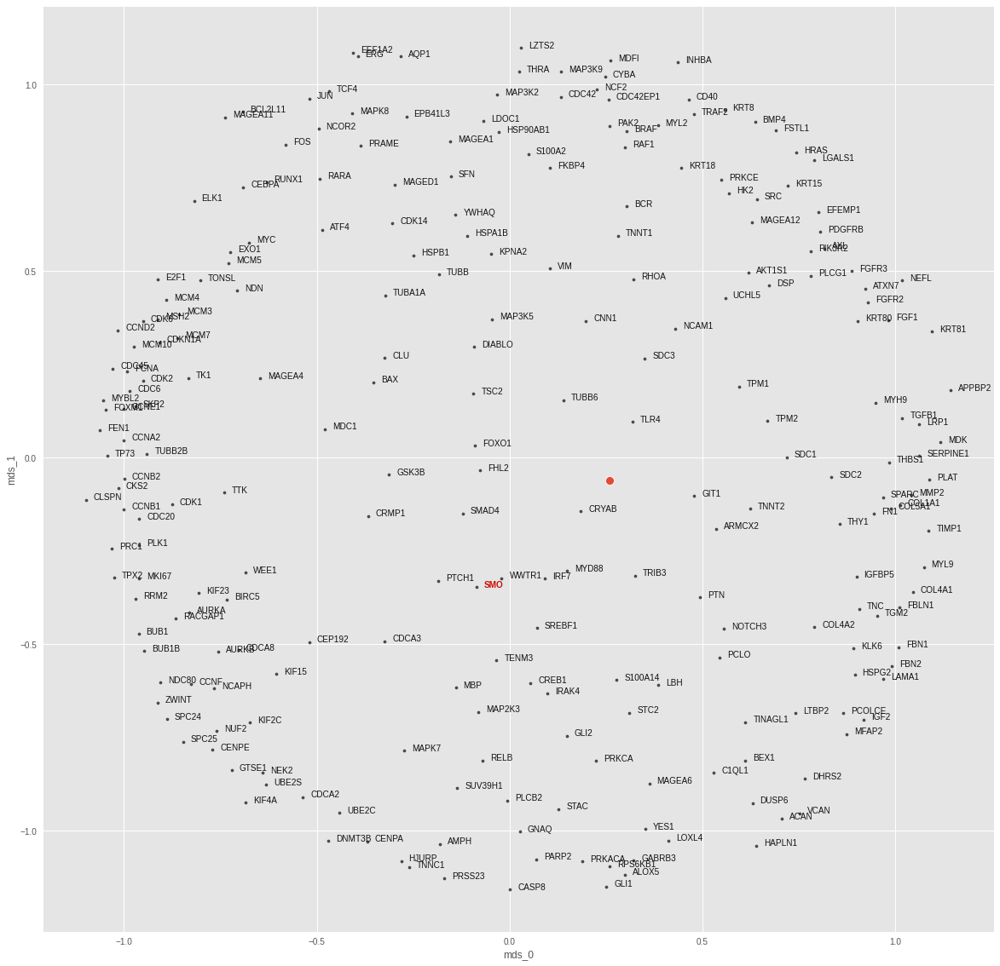

SRC
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0002333126965248467
train top-k accuracies: {1: 0.815789, 3: 0.921053, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.815789, 3: 0.921053, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0005166587652638555
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


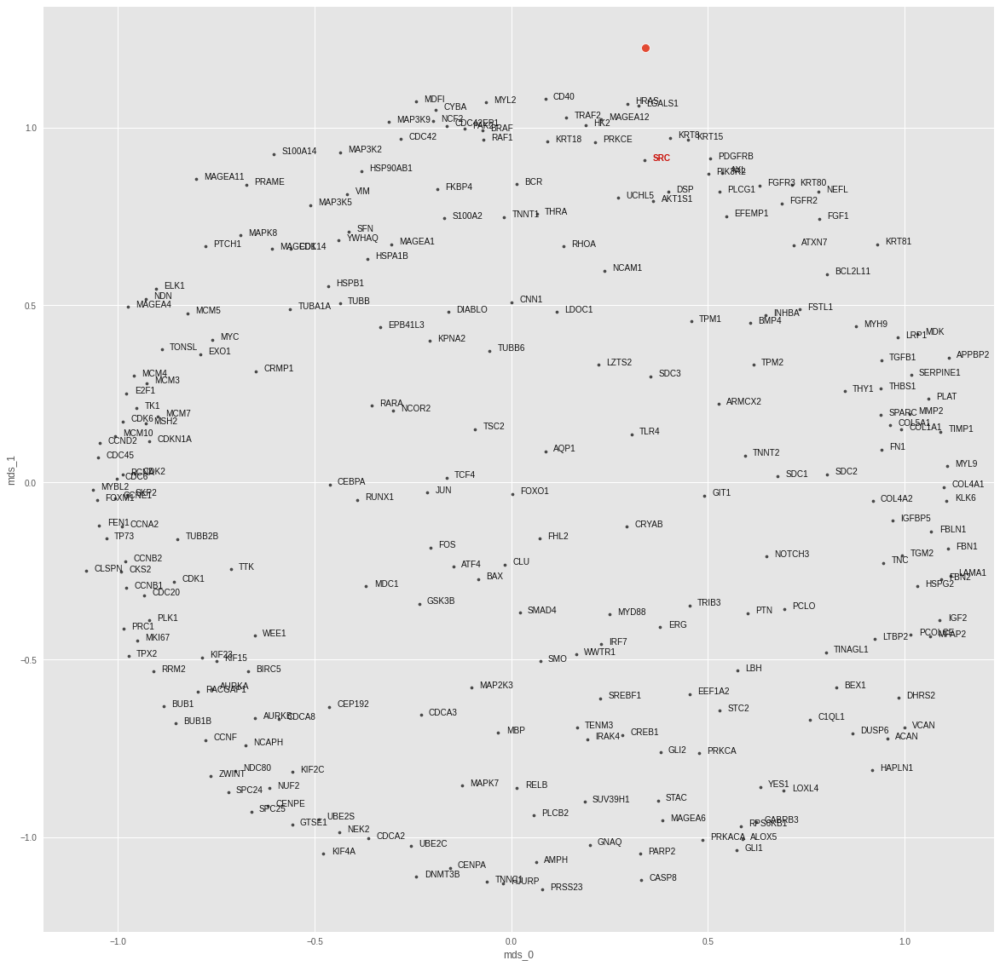

SREBF1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00018910004444861492
train top-k accuracies: {1: 0.763158, 3: 0.973684, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.973684, 5: 0.973684, 10: 0.973684, 20: 1.0, 50: 1.0}
test loss: 0.0004316523263696581
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


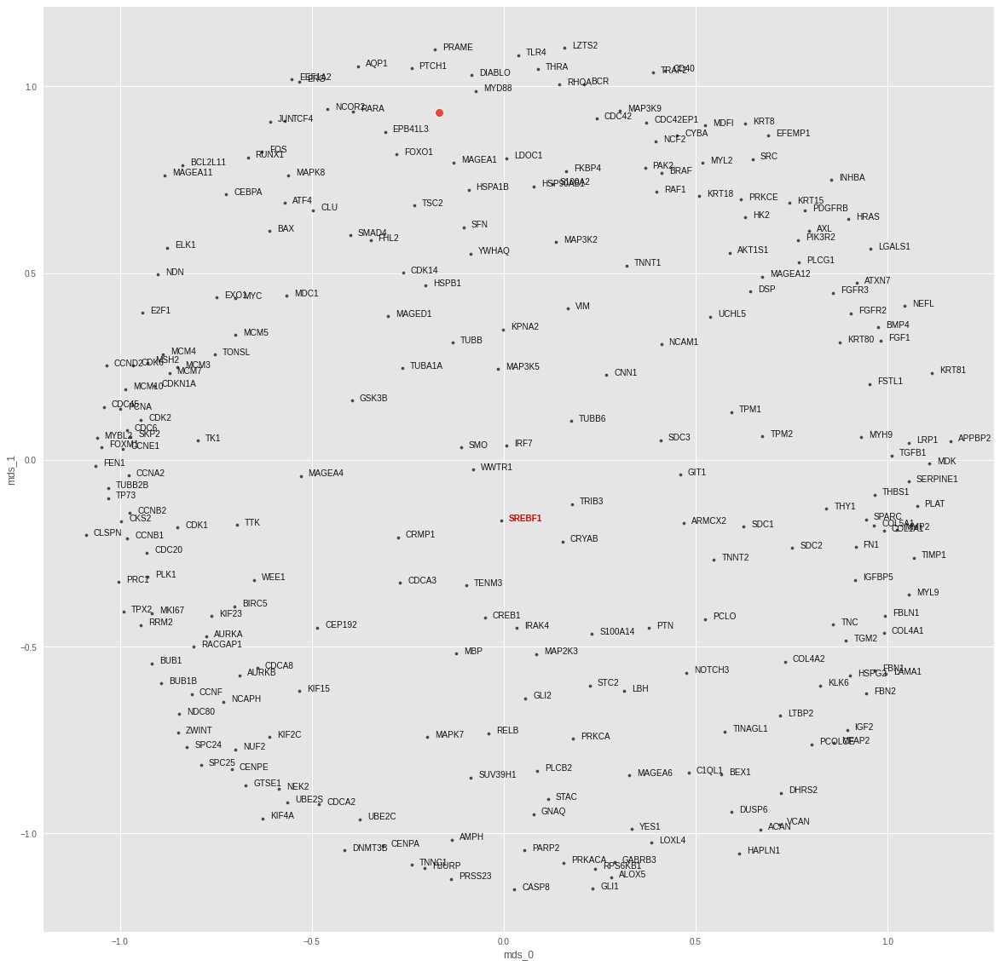

TRAF2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0003405847765909704
train top-k accuracies: {1: 0.552632, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.552632, 3: 0.894737, 5: 0.921053, 10: 0.947368, 20: 1.0, 50: 1.0}
test loss: 0.0016325215110555291
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


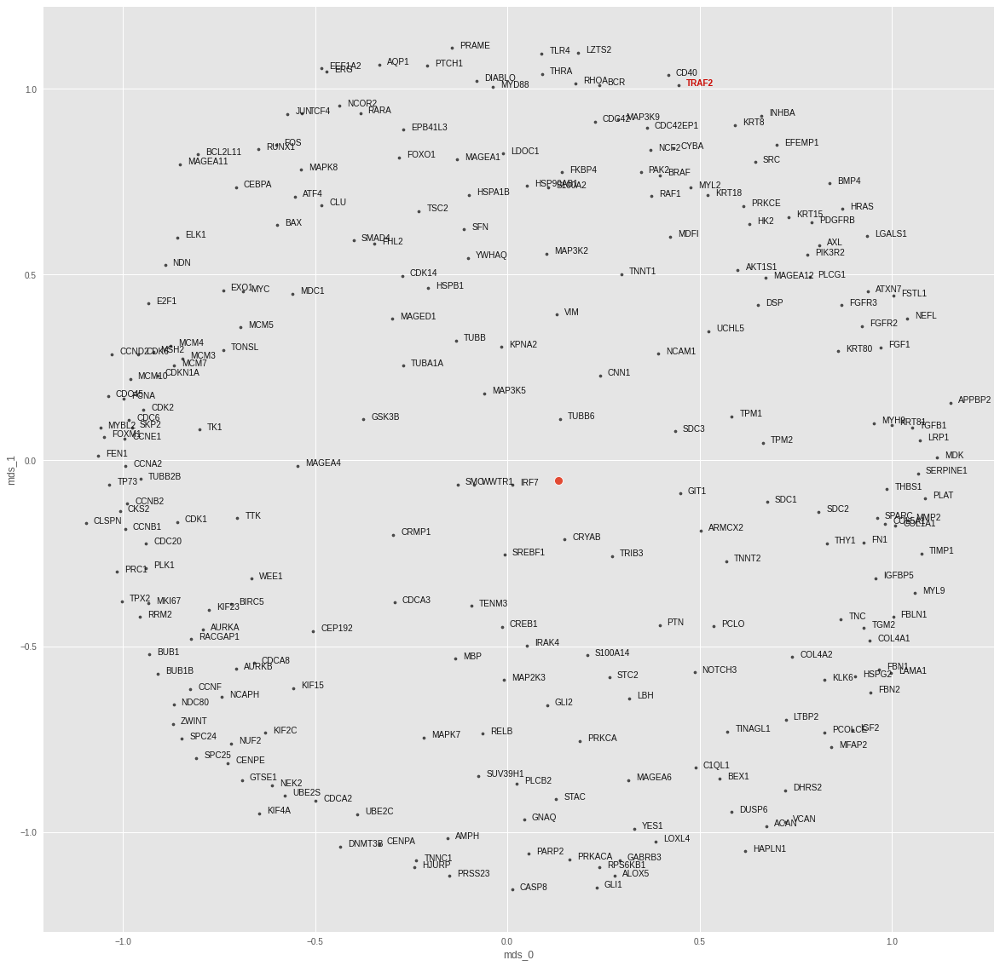

TSC2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00022719224063238422
train top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.921053, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.763158, 3: 0.868421, 5: 0.921053, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0015647178515791893
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


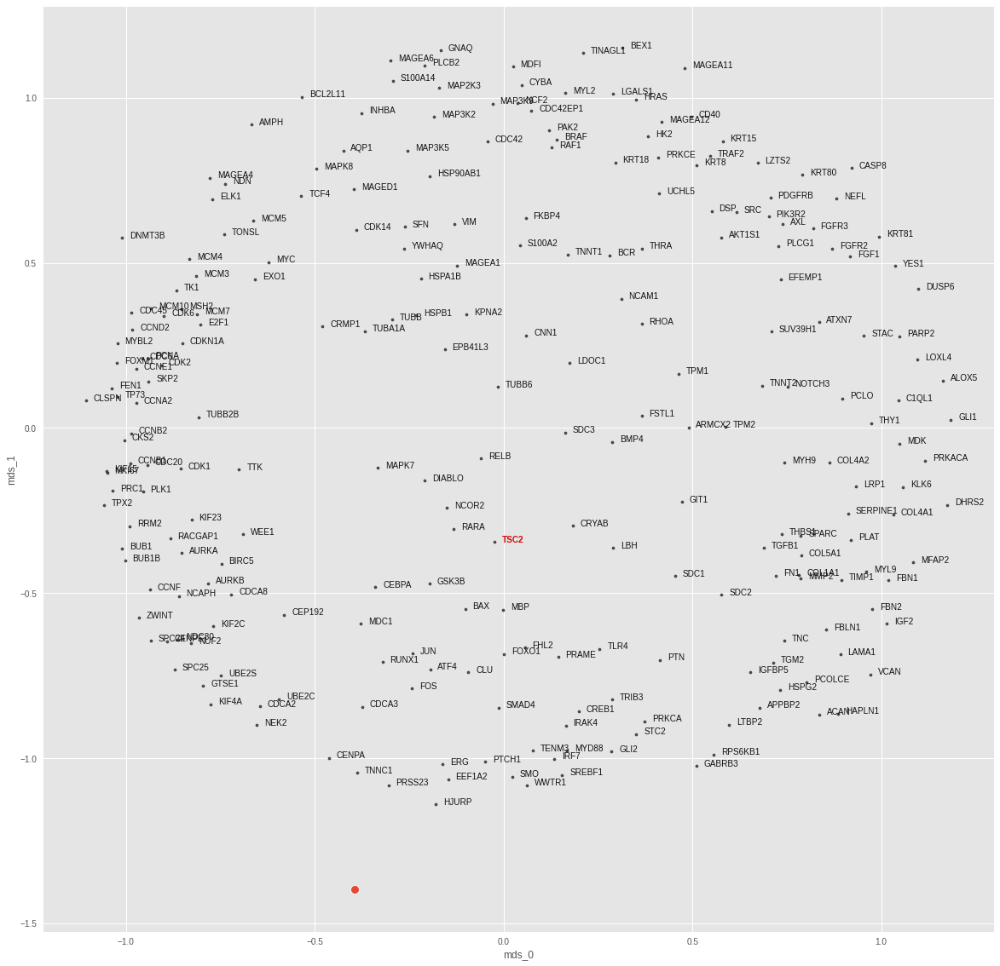

WWTR1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.00022576135463743028
train top-k accuracies: {1: 0.868421, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.868421, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0016743842279538512
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


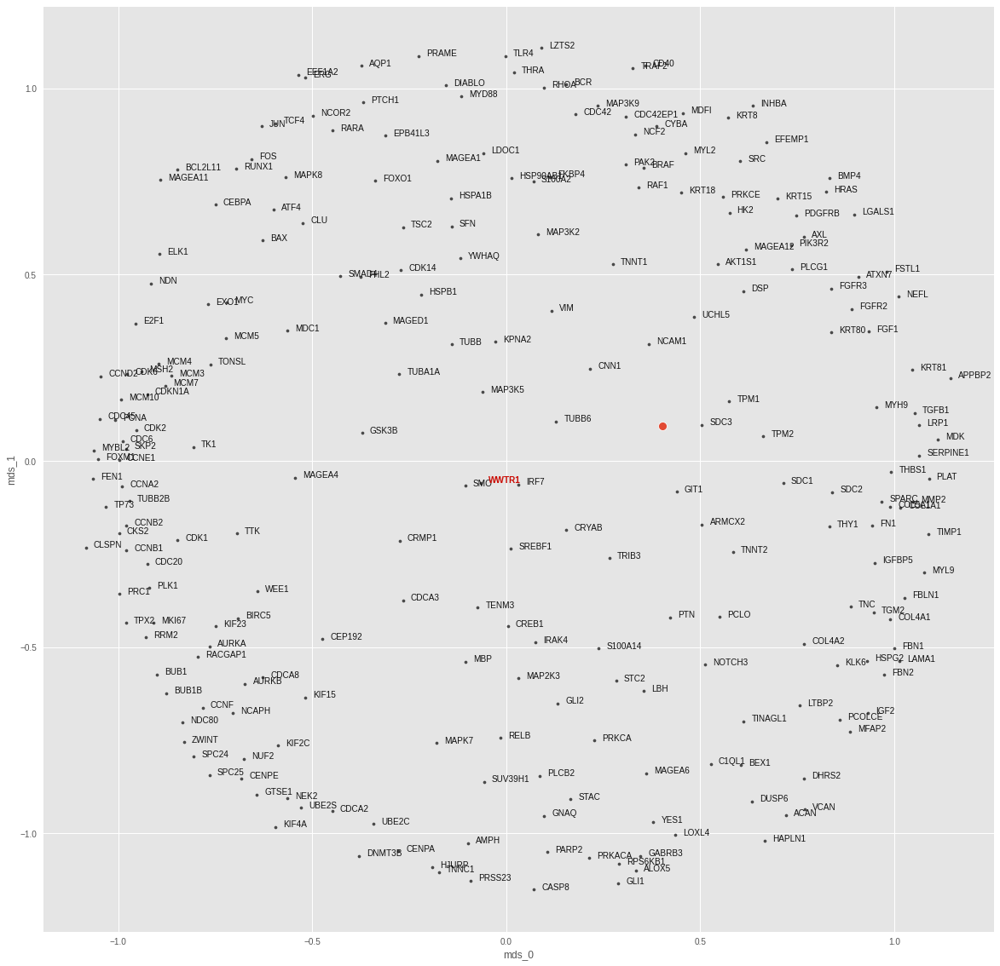

<IPython.core.display.Javascript object>

In [86]:
target_topk_accs = {}
mean_lin_nns = {}
for i in tqdm(range(len(data_dicts))):
    data_dict = data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=5e-3, weight_decay=1e-5)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, topk_acc, _, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=500,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
        use_val_data=False,
    )
    target_topk_accs[target] = topk_acc
    mean_lin_nns[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [87]:
mean_lin_topk_df = pd.DataFrame(target_topk_accs).transpose()
mean_lin_topk_df.loc[mean_lin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
BCL2L11,0.0,1.0,1.0,1.0,1.0,1.0
MAP3K9,0.0,1.0,1.0,1.0,1.0,1.0
PIK3R2,0.0,1.0,1.0,1.0,1.0,1.0
BRAF,0.0,0.0,1.0,1.0,1.0,1.0
DIABLO,0.0,0.0,1.0,1.0,1.0,1.0
CASP8,0.0,0.0,0.0,1.0,1.0,1.0
FOXO1,0.0,0.0,0.0,1.0,1.0,1.0
IRAK4,0.0,0.0,0.0,1.0,1.0,1.0
MAP2K3,0.0,0.0,0.0,1.0,1.0,1.0
MAP3K2,0.0,0.0,0.0,1.0,1.0,1.0


<IPython.core.display.Javascript object>

In [88]:
mean_lin_topk_df.describe()

,1,3,5,10,20,50
count,39.0,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.0,0.076923,0.128205,0.384615,0.641026,0.846154
std,0.0,0.269953,0.338688,0.492864,0.485971,0.365518
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,1.000000
50%,0.0,0.000000,0.000000,0.000000,1.000000,1.000000
75%,0.0,0.000000,0.000000,1.000000,1.000000,1.000000
max,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

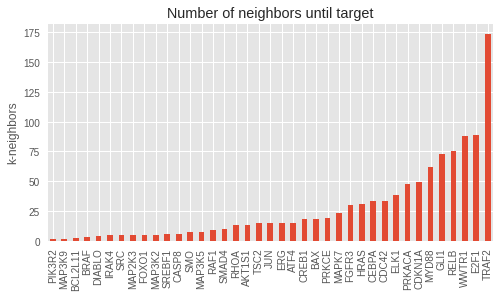

<IPython.core.display.Javascript object>

In [89]:
mpl.style.use("ggplot")
mean_lin_khits = get_knn_hit_data(mean_lin_nns)
ax = mean_lin_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

In [90]:
mean_5nn_dict = get_mean_knn_dict(img_embs_fold0, k=10)
mean_5nn_dict["JUN"]

['CEBPA',
 'ERG',
 'E2F1',
 'FGFR3',
 'ELK1',
 'PRKACA',
 'RAF1',
 'BRAF',
 'CDC42',
 'SRC']

<IPython.core.display.Javascript object>

In [91]:
mean_5nn_dict = get_mean_knn_dict(node_embs, k=10)
mean_5nn_dict["JUN"]

['FOS',
 'ERG',
 'AQP1',
 'EEF1A2',
 'CEBPA',
 'ATF4',
 'NCOR2',
 'TCF4',
 'RUNX1',
 'MAPK8']

<IPython.core.display.Javascript object>

In [92]:
from scipy.spatial.distance import squareform, pdist

node_embs_dist = pd.DataFrame(
    squareform(pdist(node_embs)), index=node_embs.index, columns=node_embs.index
)

<IPython.core.display.Javascript object>

In [93]:
node_embs_dist.loc[
    ["JUN", "CEBPA", "ERG", "BRAF", "RAF1", "HRAS", "MAP3K5"],
    ["JUN", "CEBPA", "ERG", "BRAF", "RAF1", "HRAS", "MAP3K5"],
]

,JUN,CEBPA,ERG,BRAF,RAF1,HRAS,MAP3K5
JUN,0.000000,0.574317,0.466070,1.464948,1.476861,1.502410,1.508715
CEBPA,0.574317,0.000000,0.889152,1.550074,1.567885,1.636394,1.538513
ERG,0.466070,0.889152,0.000000,1.532636,1.539634,1.498340,1.585857
BRAF,1.464948,1.550074,1.532636,0.000000,0.286372,0.669340,1.032600
RAF1,1.476861,1.567885,1.539634,0.286372,0.000000,0.853856,0.901368
HRAS,1.502410,1.636394,1.498340,0.669340,0.853856,0.000000,1.336127
MAP3K5,1.508715,1.538513,1.585857,1.032600,0.901368,1.336127,0.000000


<IPython.core.display.Javascript object>

In [94]:
mean_lin_nns["JUN"][:20]

array(['NCOR2', 'CEBPA', 'RARA', 'CDC42', 'HSP90AB1', 'MAGEA1', 'RUNX1',
       'FKBP4', 'BCR', 'DIABLO', 'HSPA1B', 'THRA', 'SFN', 'YWHAQ',
       'CDK14', 'JUN', 'FOXO1', 'EXO1', 'CDKN1A', 'AQP1'], dtype='<U8')

<IPython.core.display.Javascript object>

In [95]:
mean_lin_results = {"topk_acc": [], "k": []}
ks = list(range(50))
mean_lin_nn_topk = get_topk_acc_from_nn_dict(mean_lin_nns, ks=ks)
mean_lin_result = mean_lin_nn_topk.mean()
for k in ks:
    mean_lin_results["topk_acc"].append(mean_lin_result.loc["top-{}".format(k)])
    mean_lin_results["k"].append(k)
mean_lin_results = pd.DataFrame(mean_lin_results)

<IPython.core.display.Javascript object>

---

### 2.3. Nonlinear mean prediction

We do apply the same scheme using a simple 3-layer nonlinear network.

  0%|          | 0/39 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.3434749447654836e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.000642020720988512
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


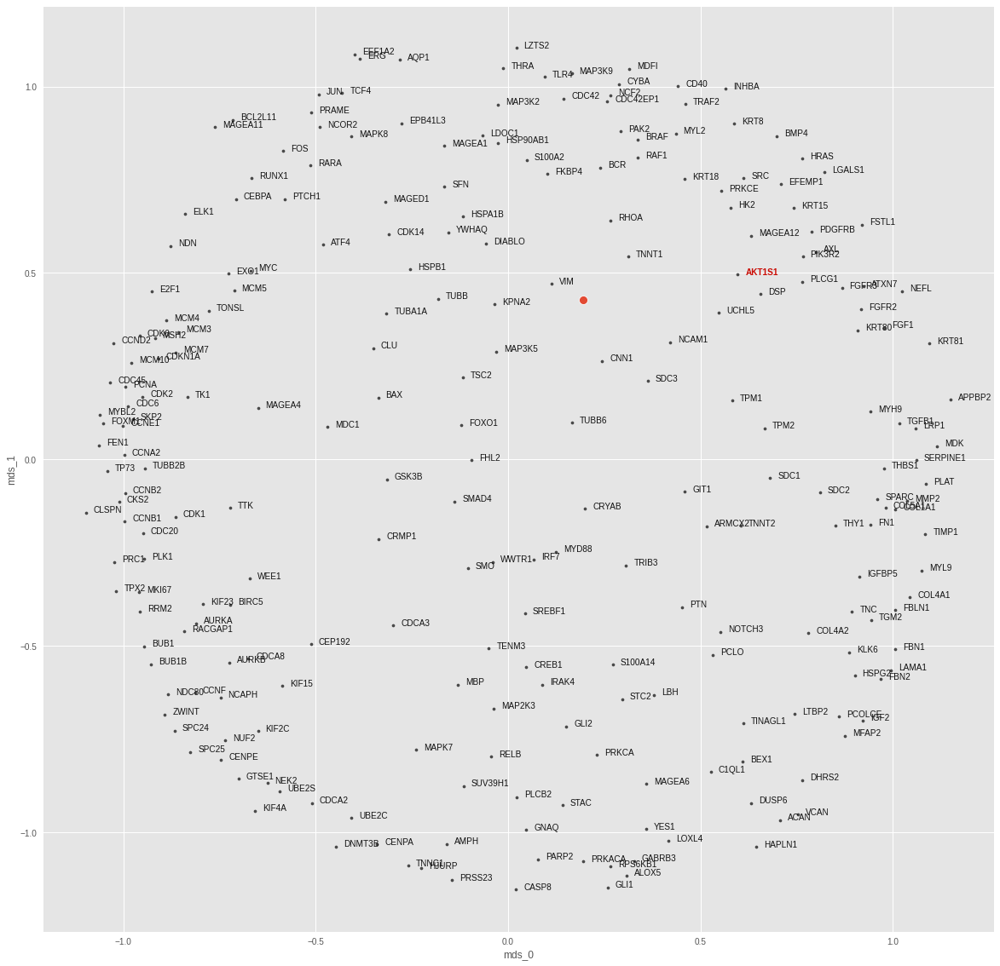

ATF4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.4639585491462832e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0007726979674771428
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


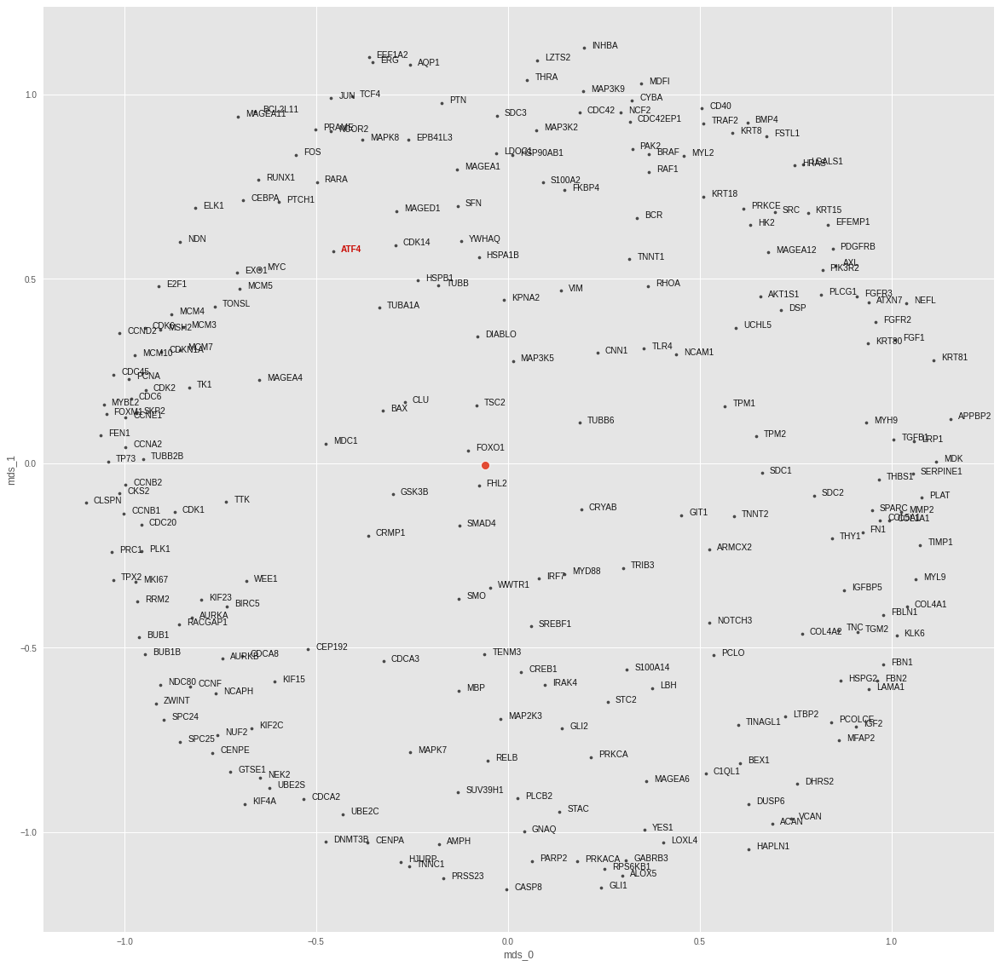

BAX
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 4.290893654893137e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0009945562342181802
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


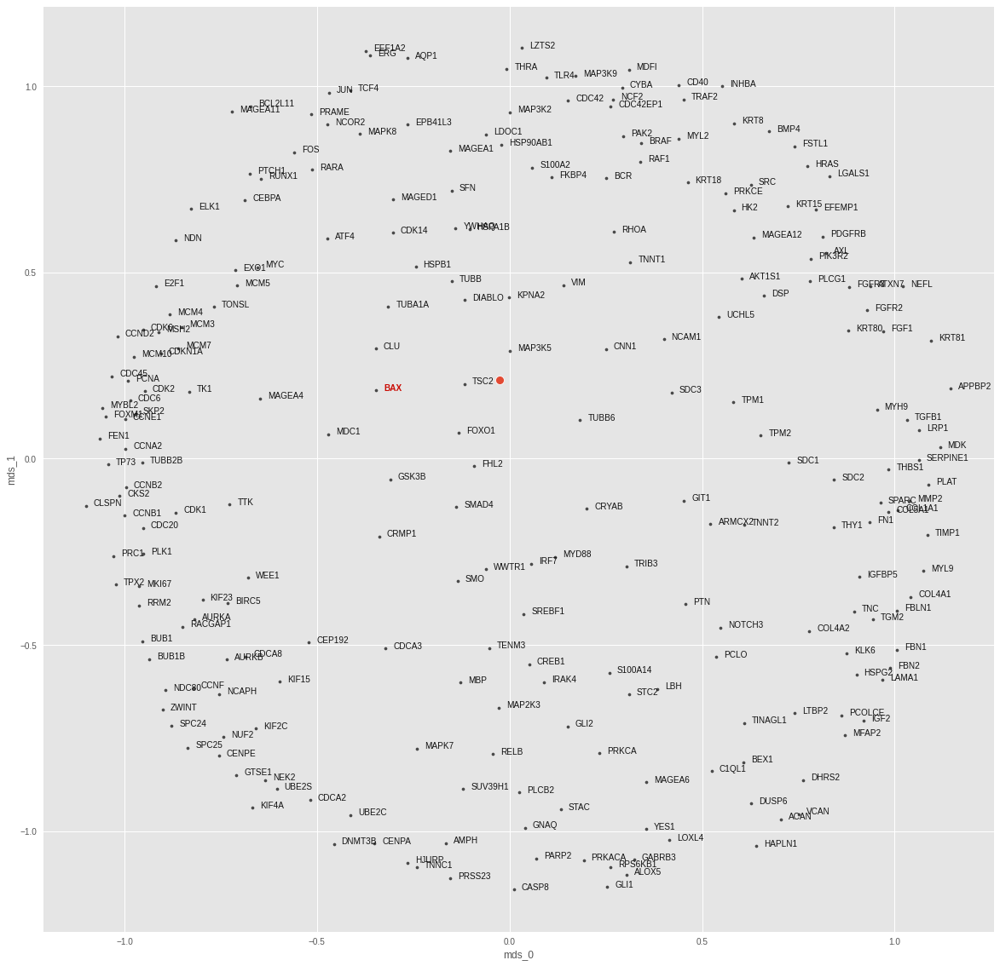

BCL2L11
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.2885922169761647e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0008059777901507914
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


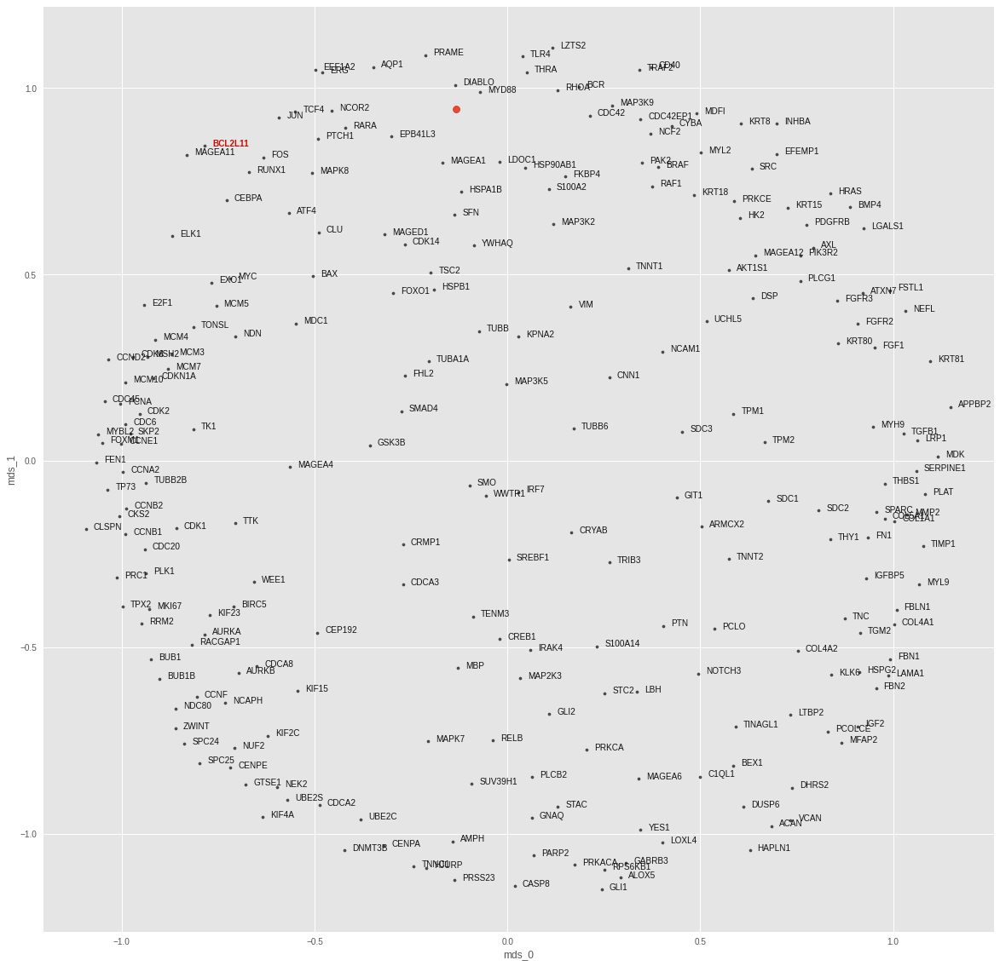

BRAF
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.468503907948616e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0003104587667621672
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


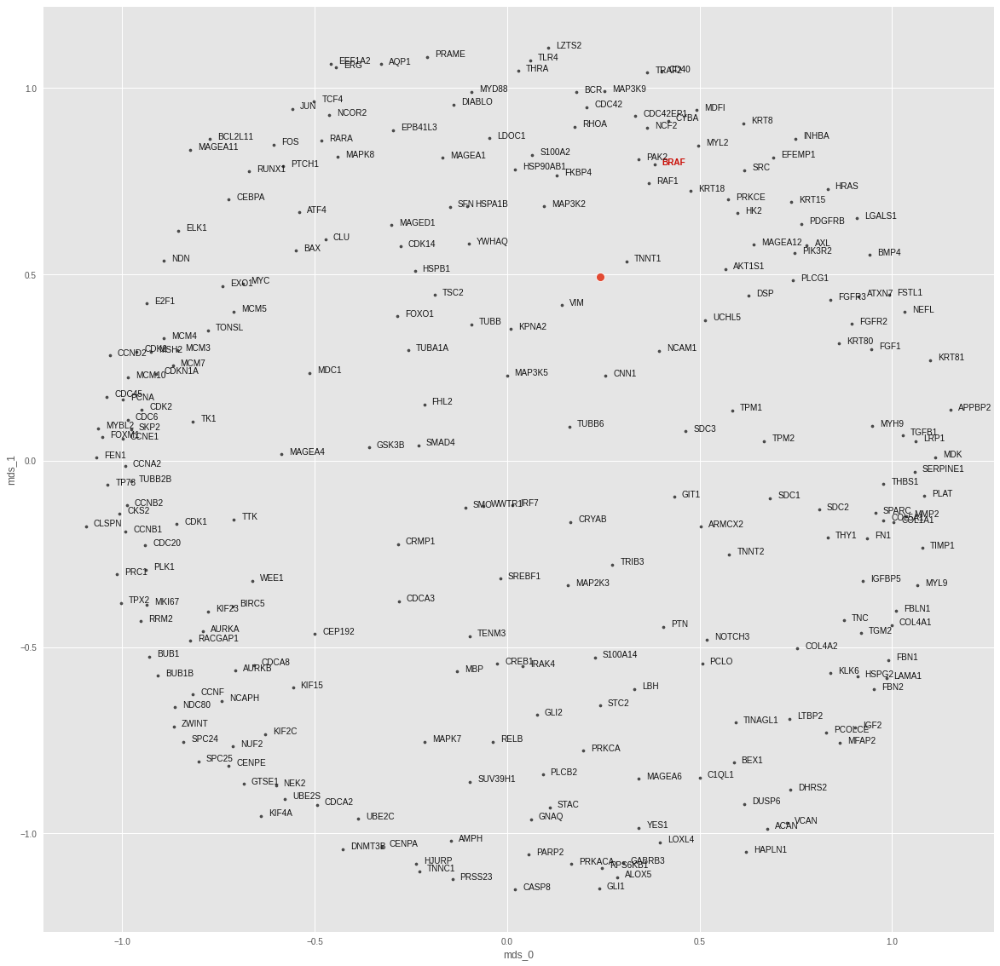

CASP8
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.2466577309647907e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0011311289854347706
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


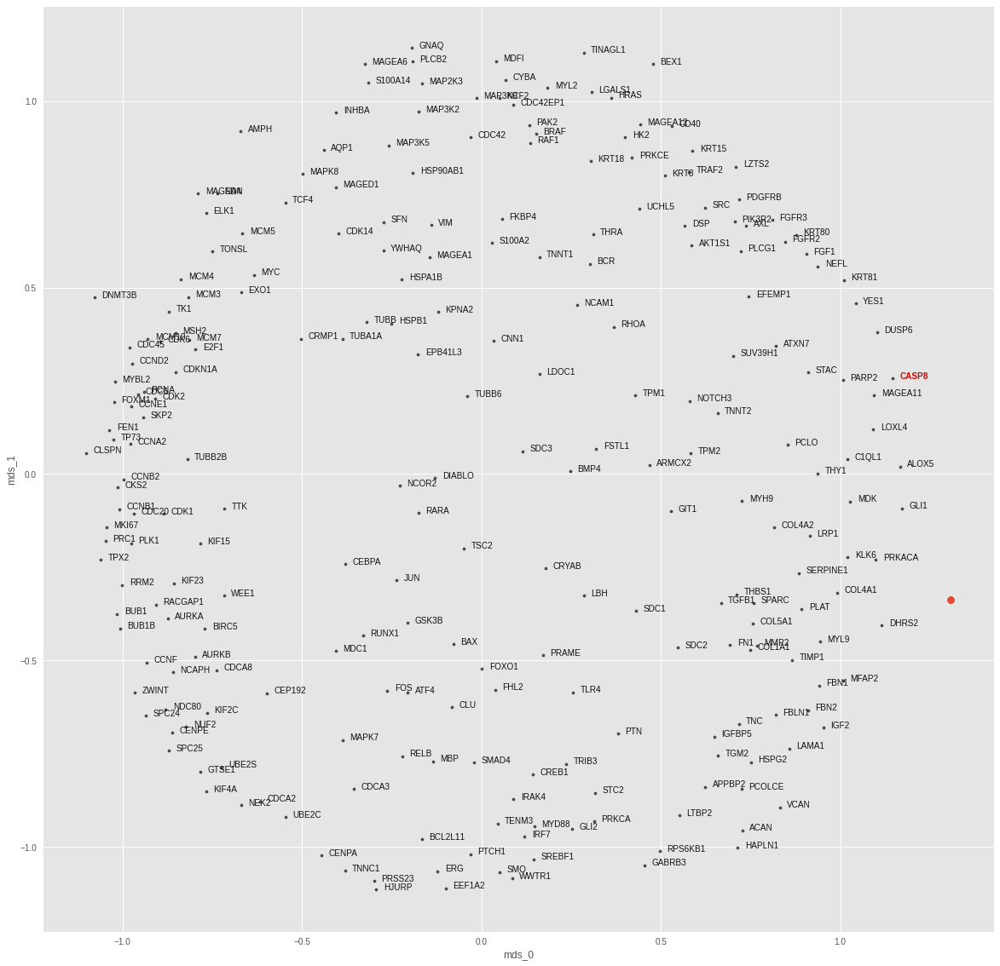

CDC42
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 9.104025839166608e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0005744823720306158
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


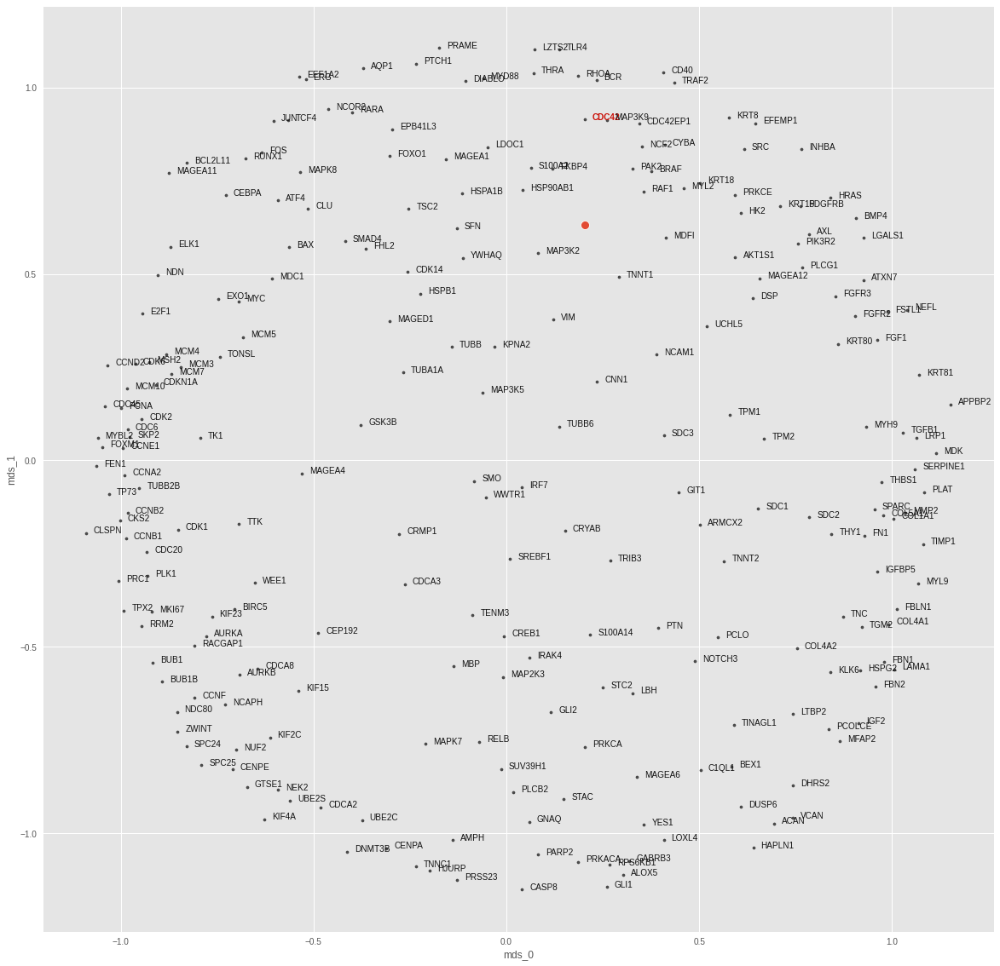

CDKN1A
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.9292127093963484e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003271649591624737
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


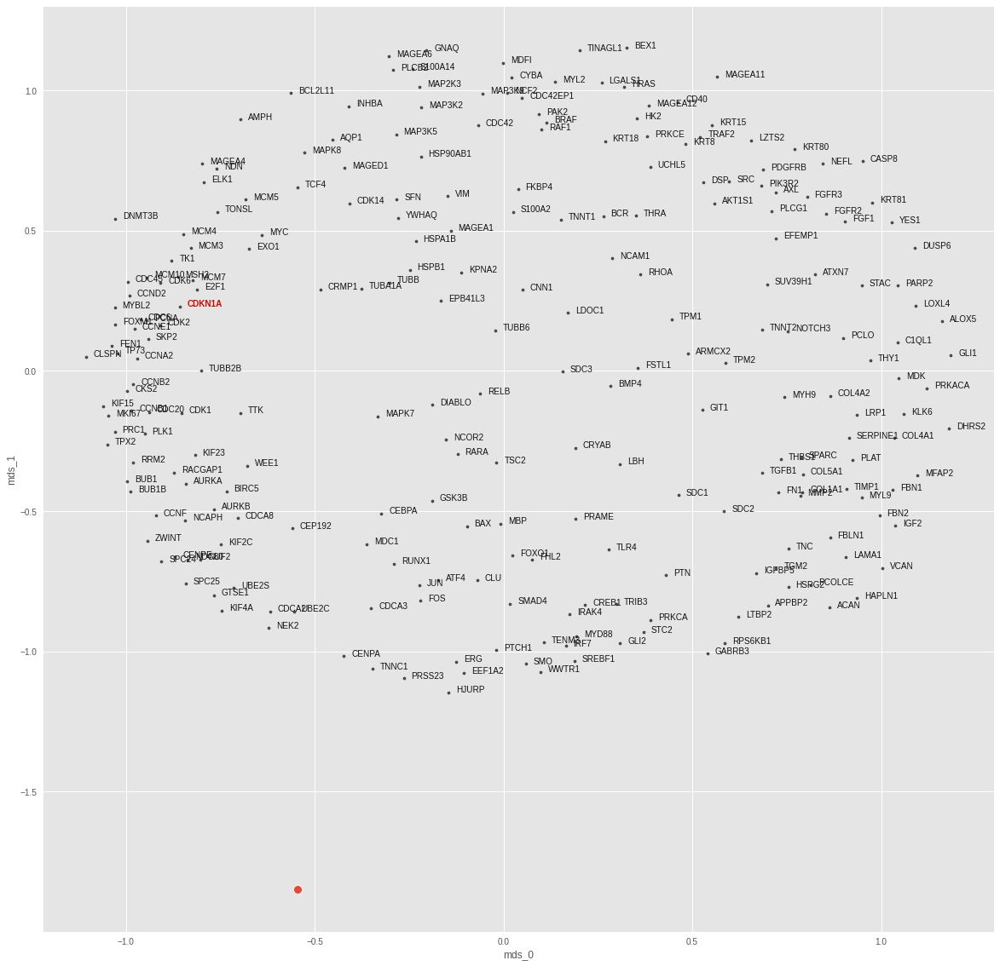

CEBPA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.9541264977620142e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0012824987061321735
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


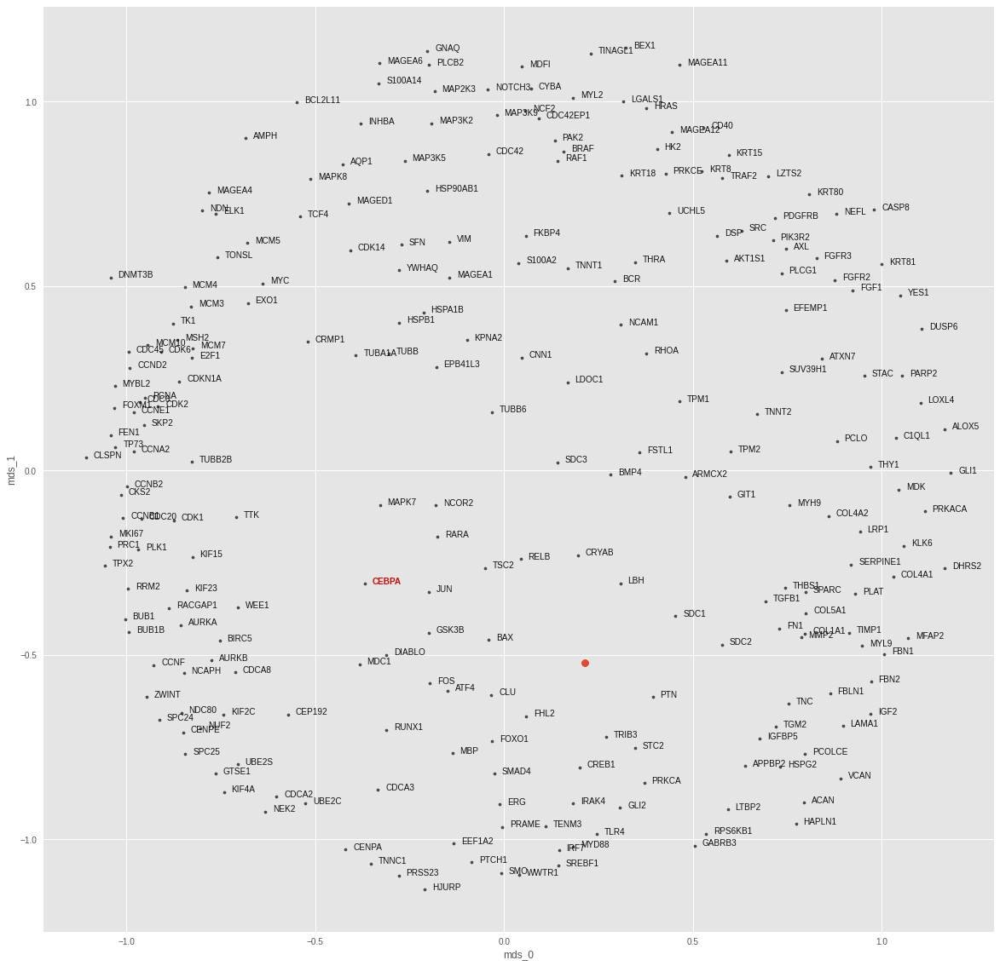

CREB1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.4305733741007555e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.000990630011074245
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


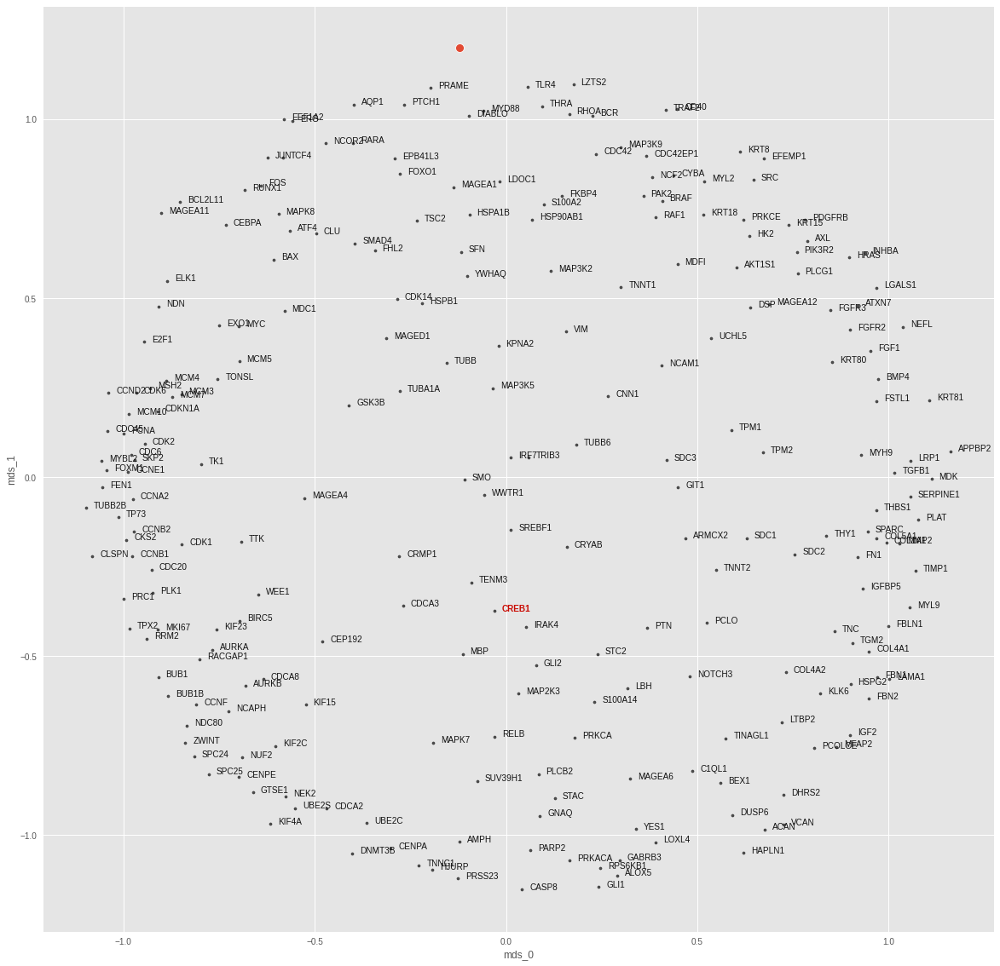

DIABLO
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 5.437417233846836e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0005494854412972927
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


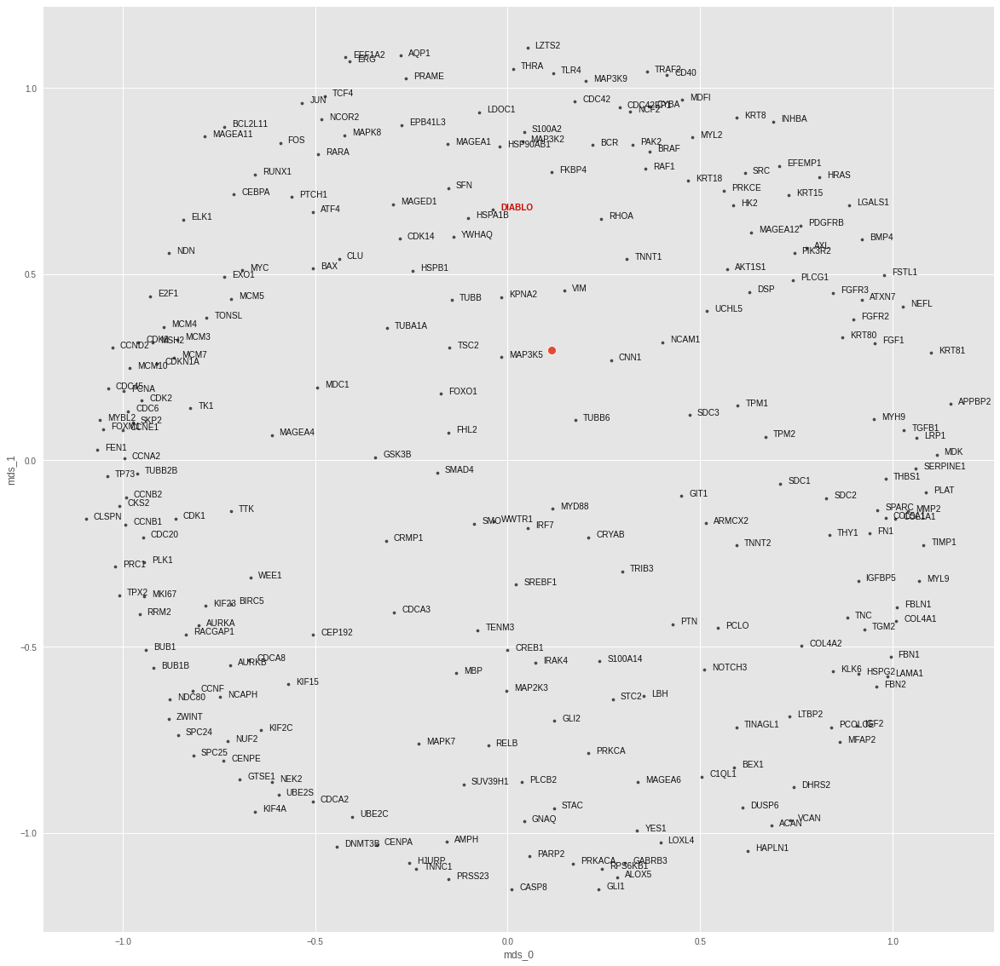

E2F1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.163246359774157e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0020025933627039194
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


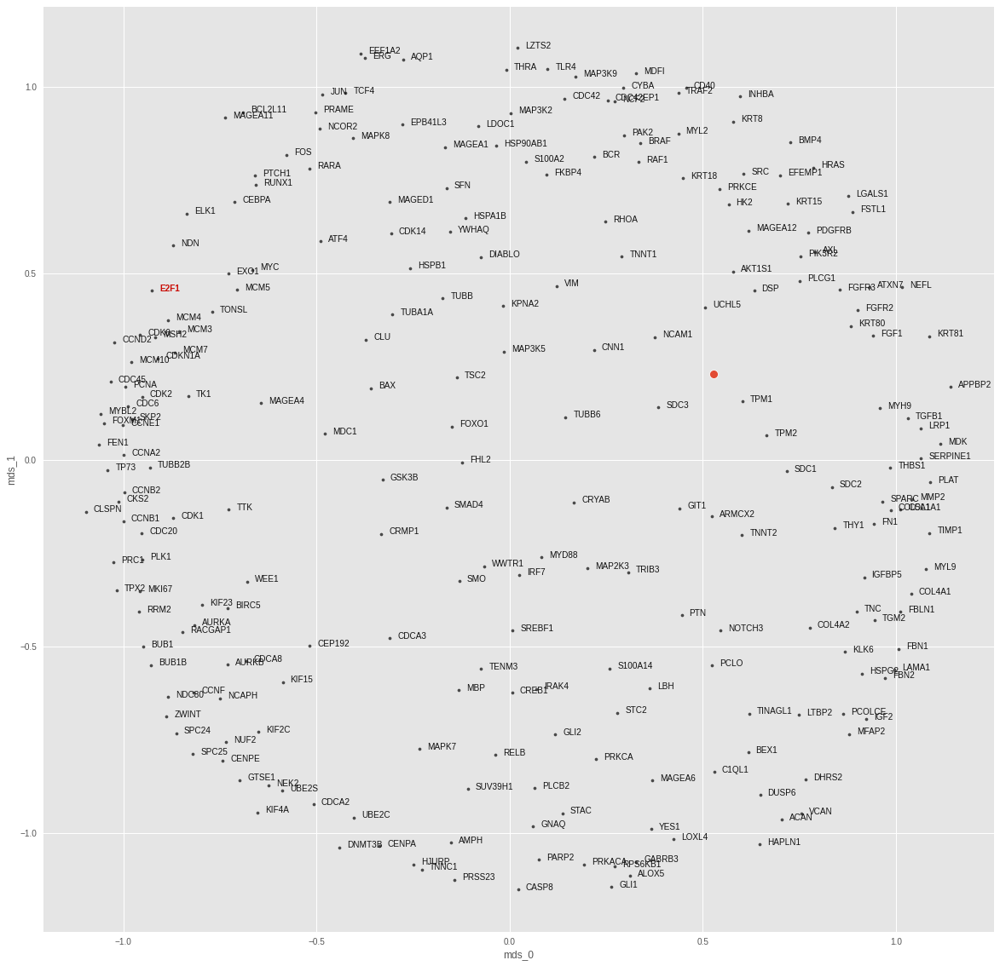

ELK1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.02872456611658e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0010110768489539623
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


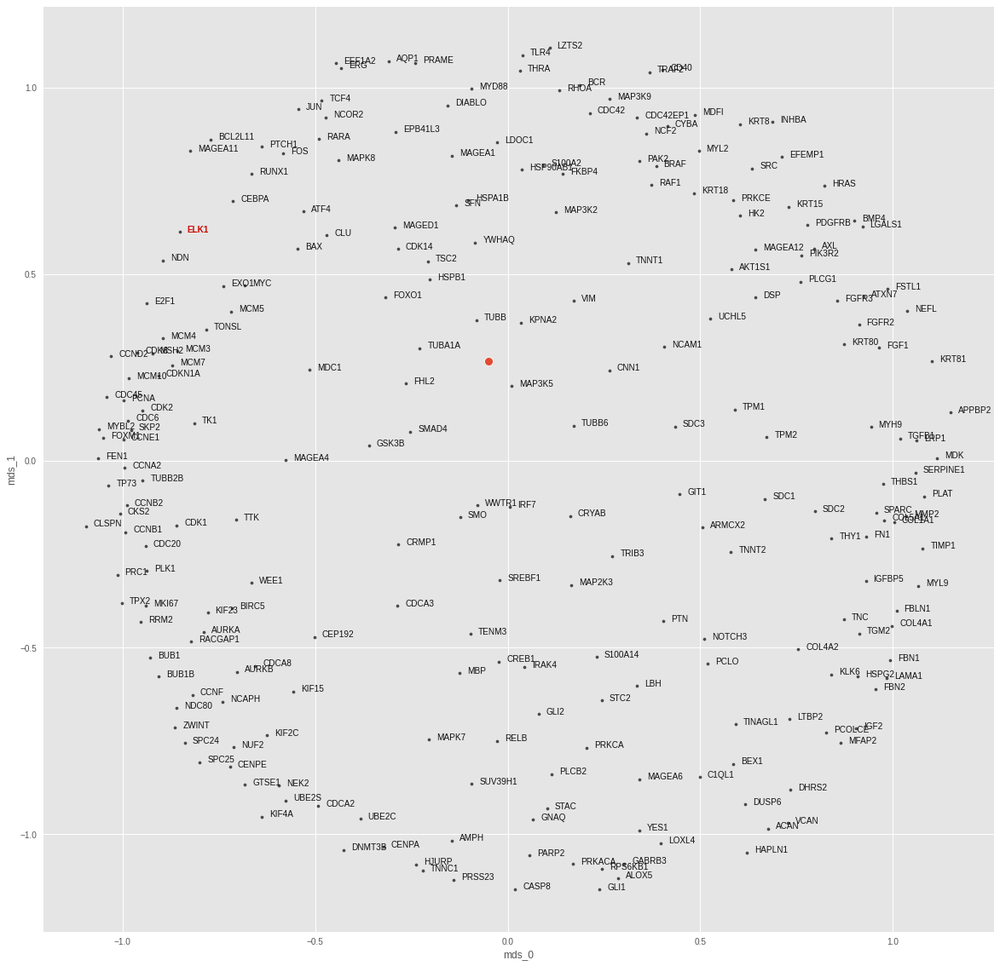

ERG
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.6147390599362552e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001642265124246478
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


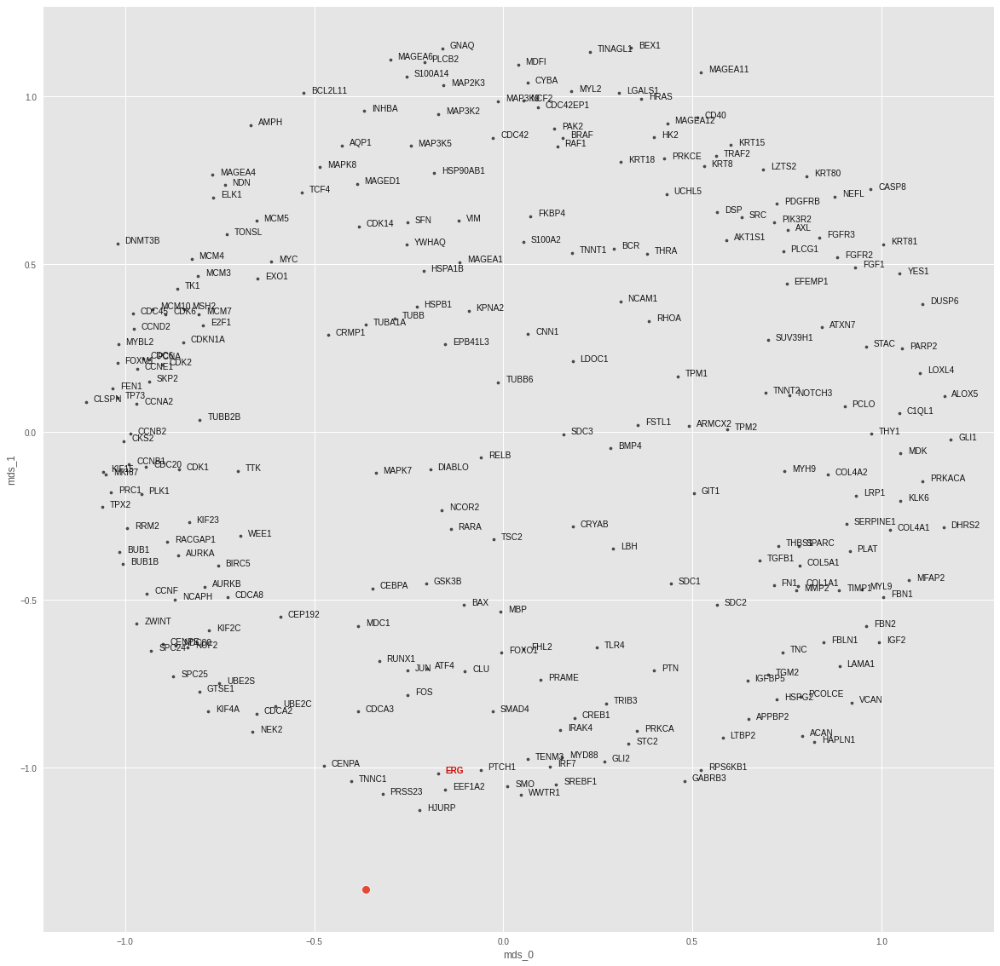

FGFR3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.6281662977378705e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.000989830121397972
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


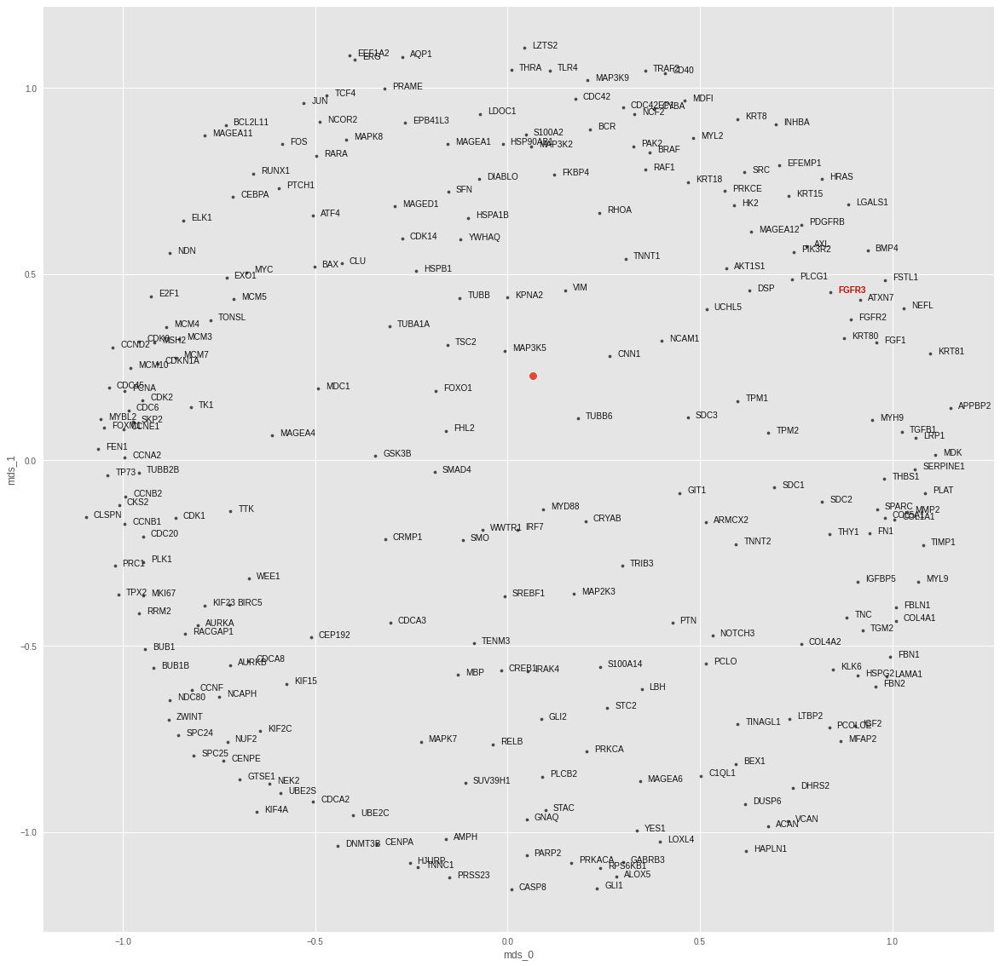

FOXO1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 4.222725884143361e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00034623415558598936
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


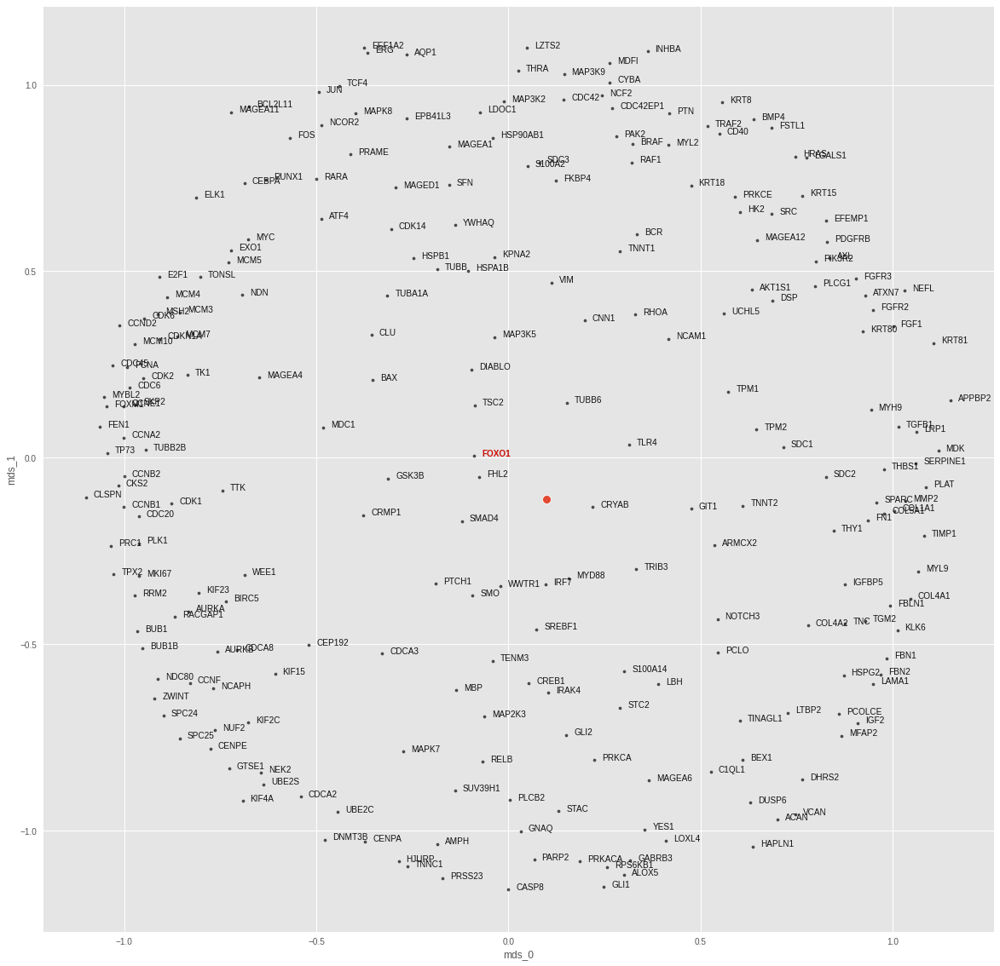

GLI1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.8055987729059874e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0014130398631095886
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


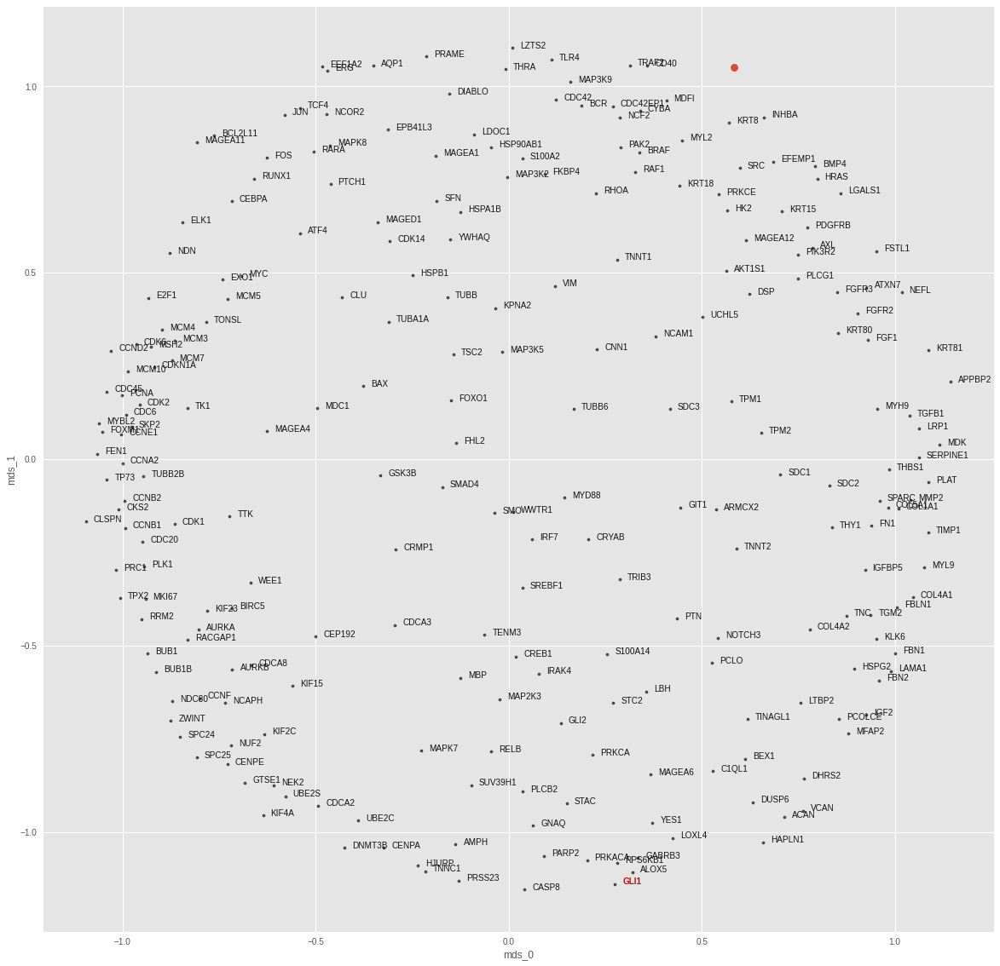

HRAS
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 5.292172988303814e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005212840624153614
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


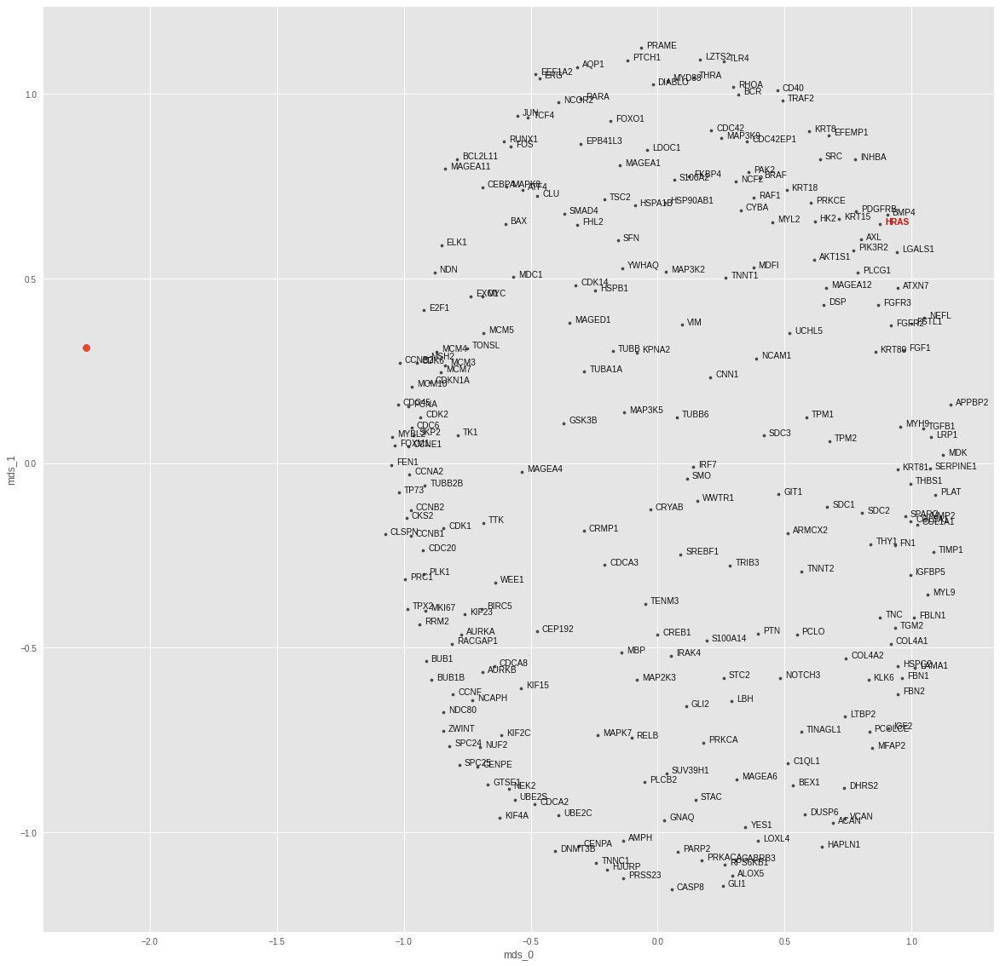

IRAK4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.62749884324761e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0007253666990436614
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


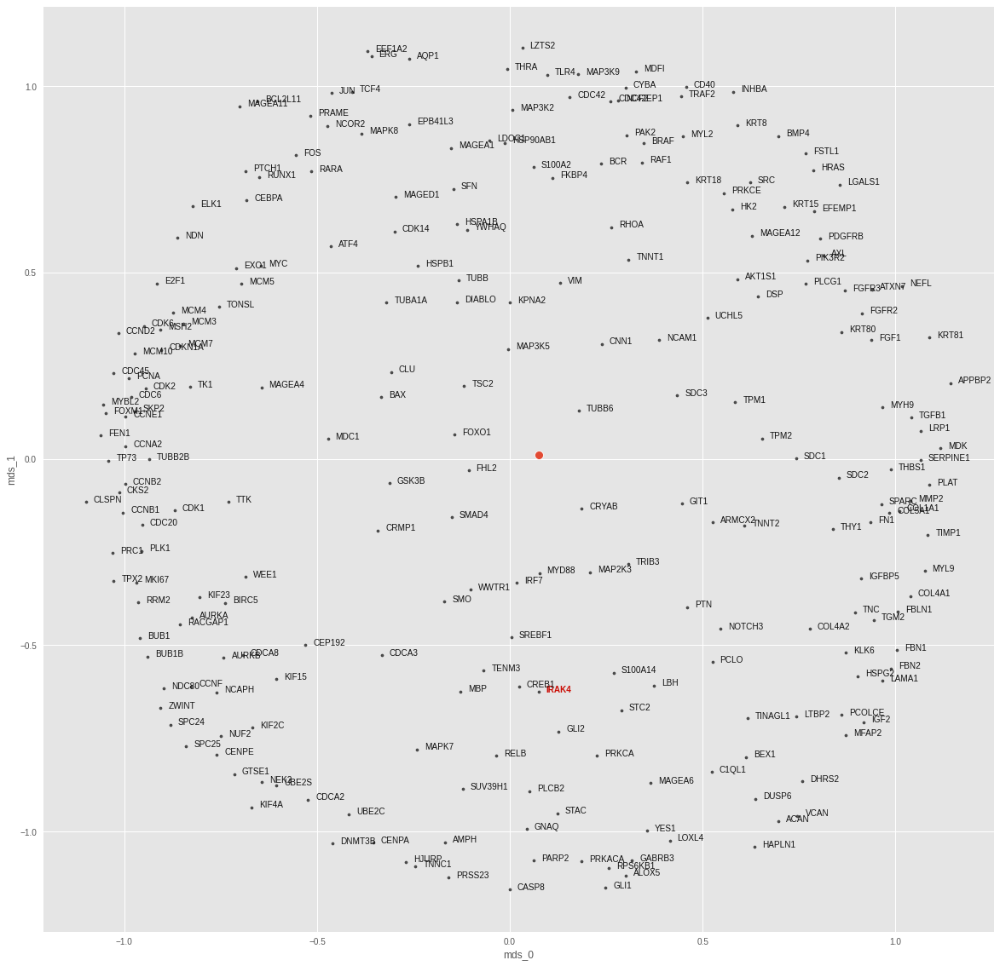

JUN
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.5609465016926773e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0011365137761458755
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


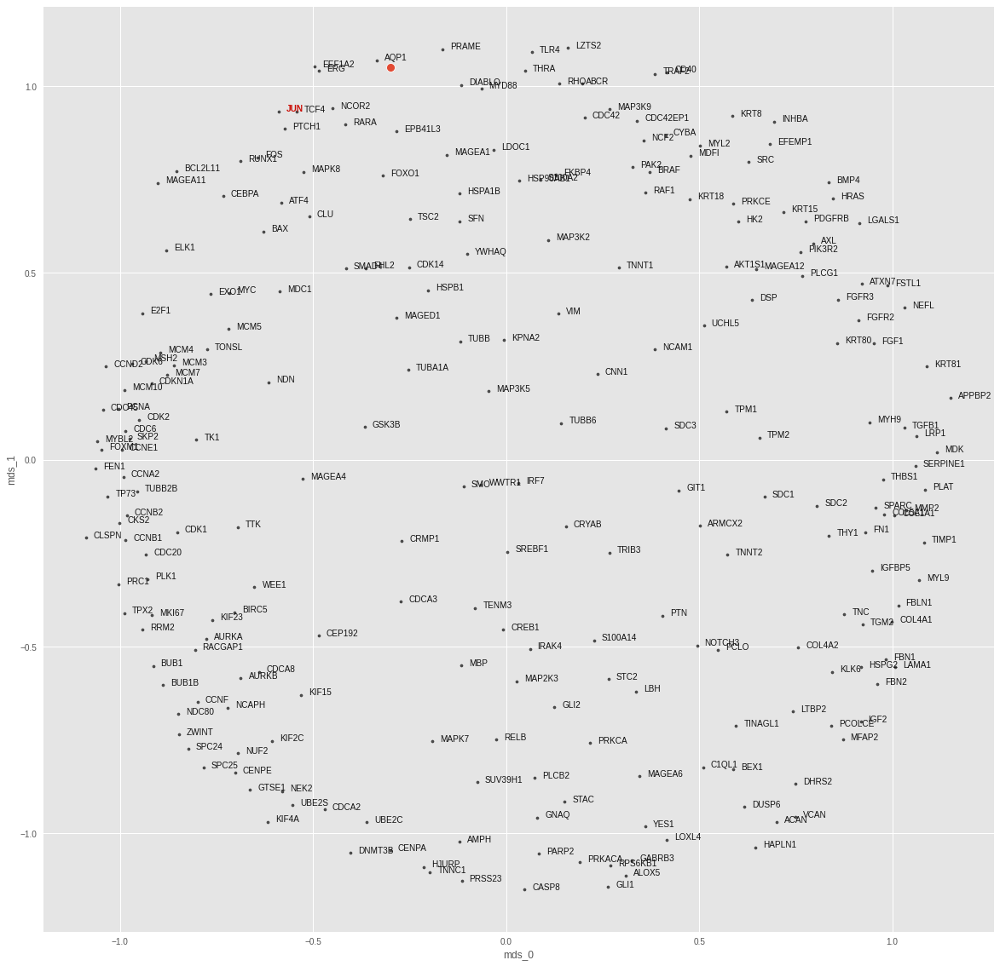

MAP2K3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 4.81369333053743e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0017111352644860744
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


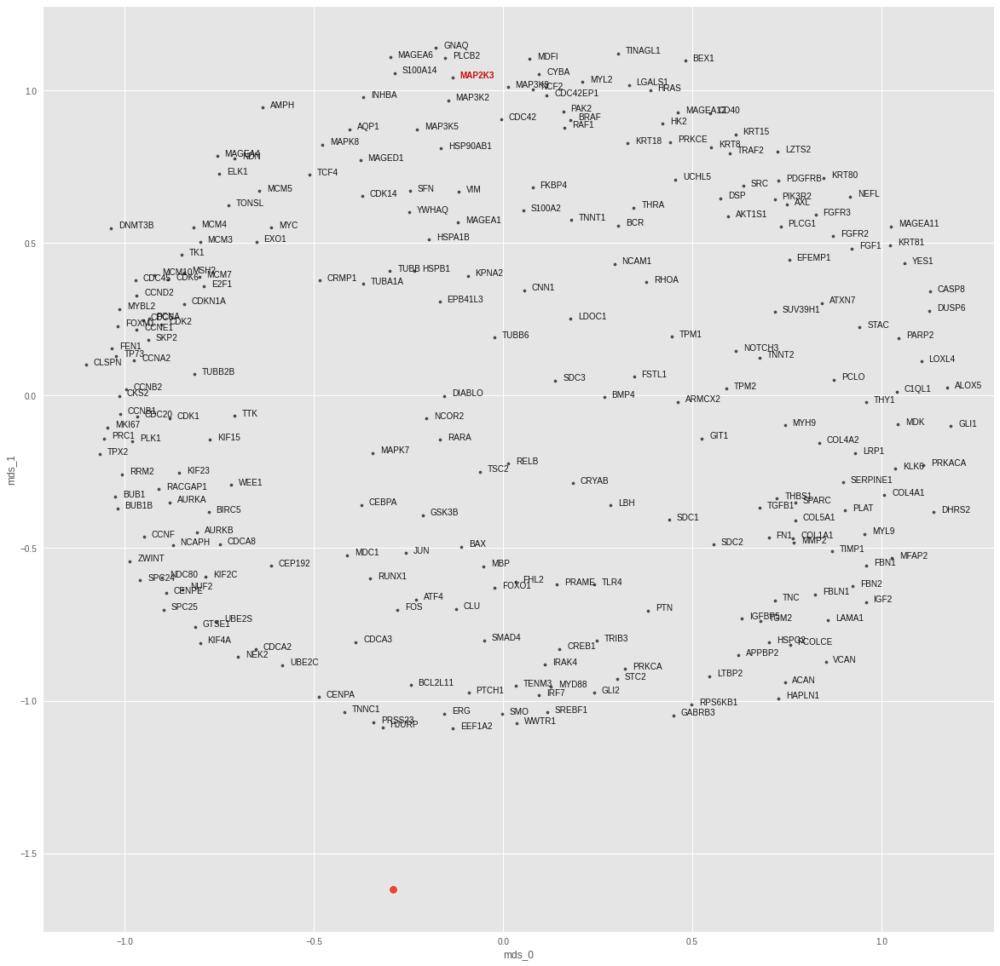

MAP3K2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.3387720185308257e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0004880600608885288
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


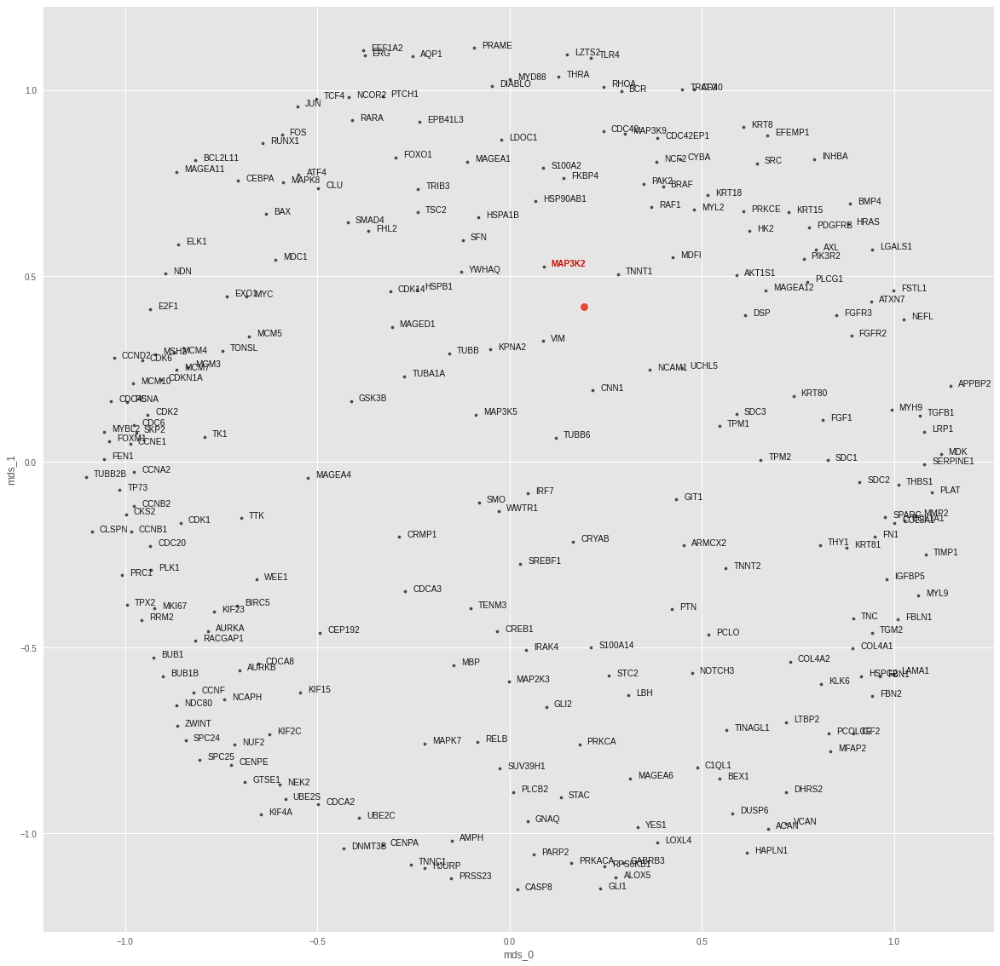

MAP3K5
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.147445953644484e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0008553870138712227
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


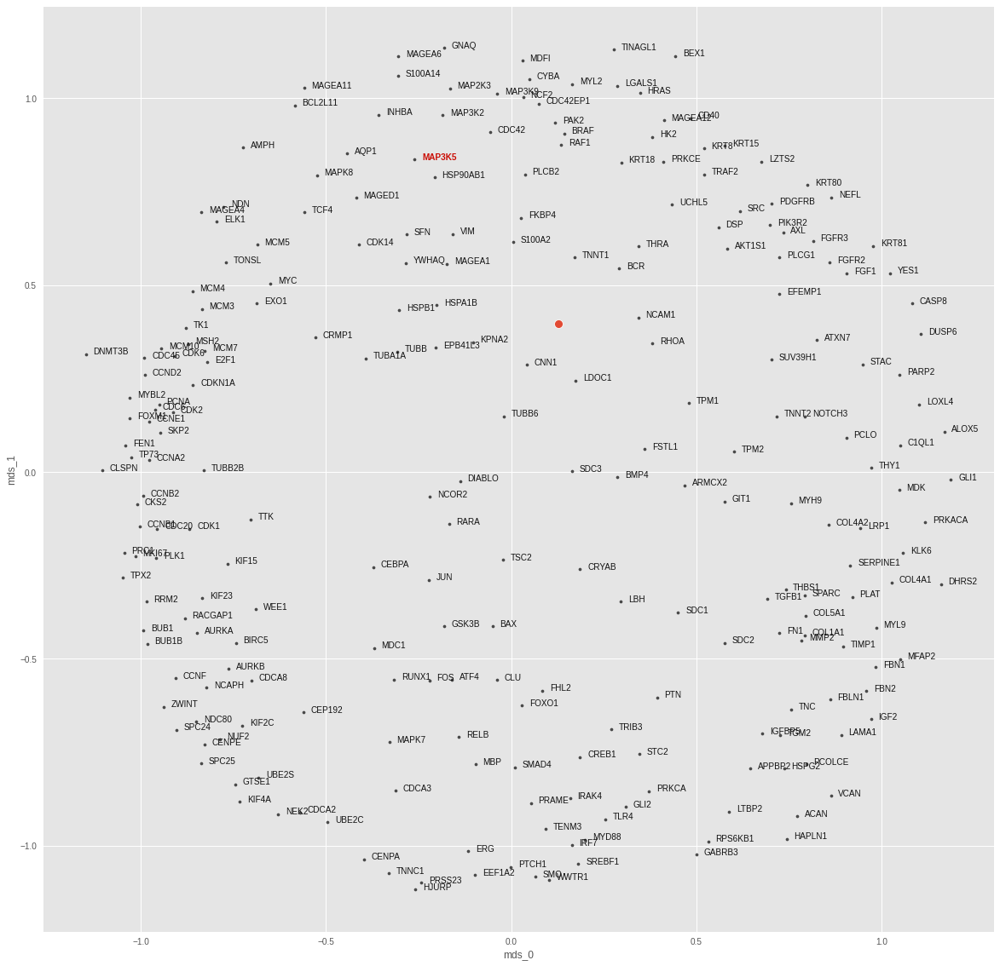

MAP3K9
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.3373228080010065e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0006581736961379647
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


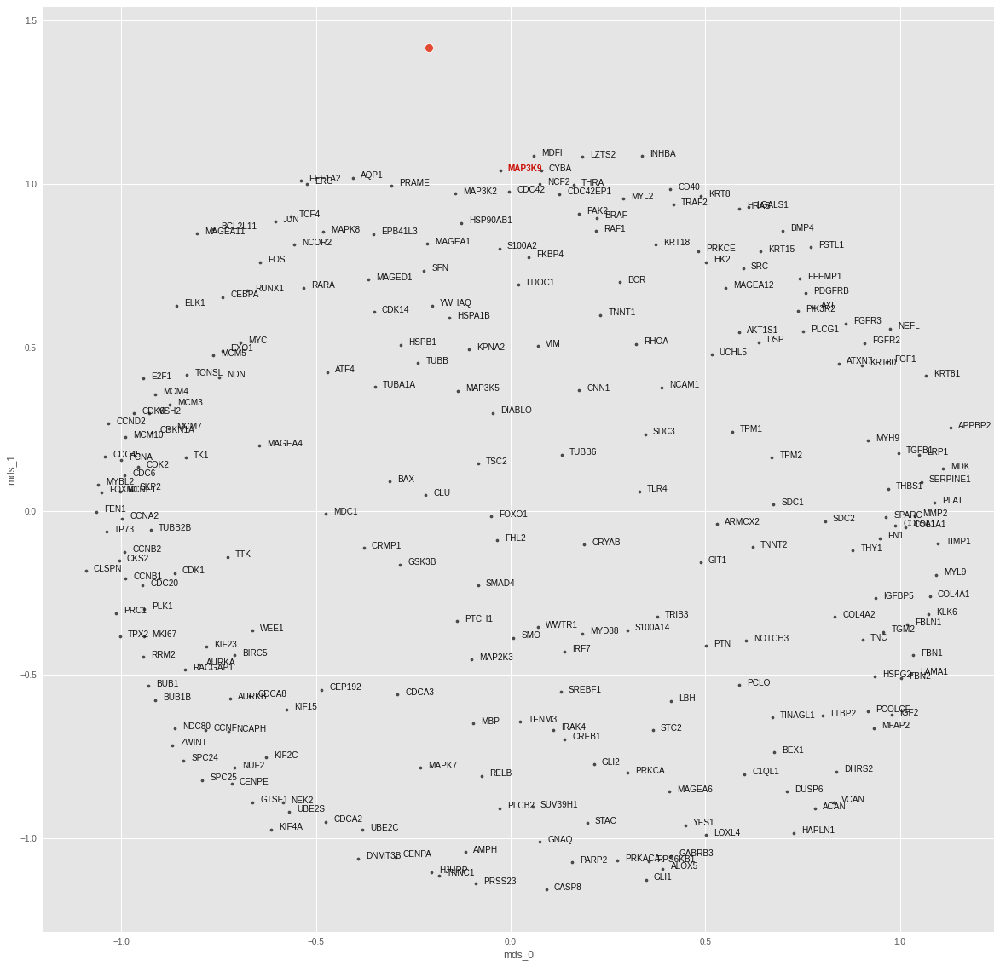

MAPK7
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.0437069989076055e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0006650680443271995
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


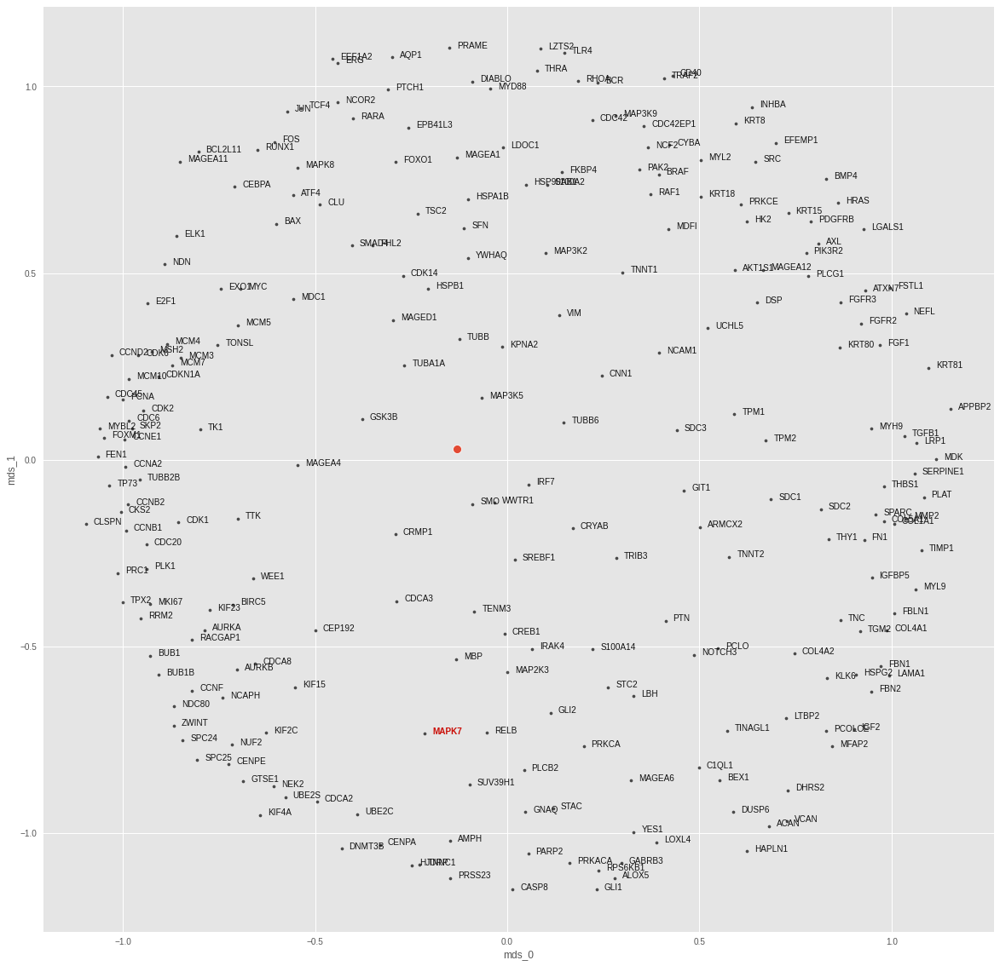

MYD88
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 5.189397861134862e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0013464114163070917
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


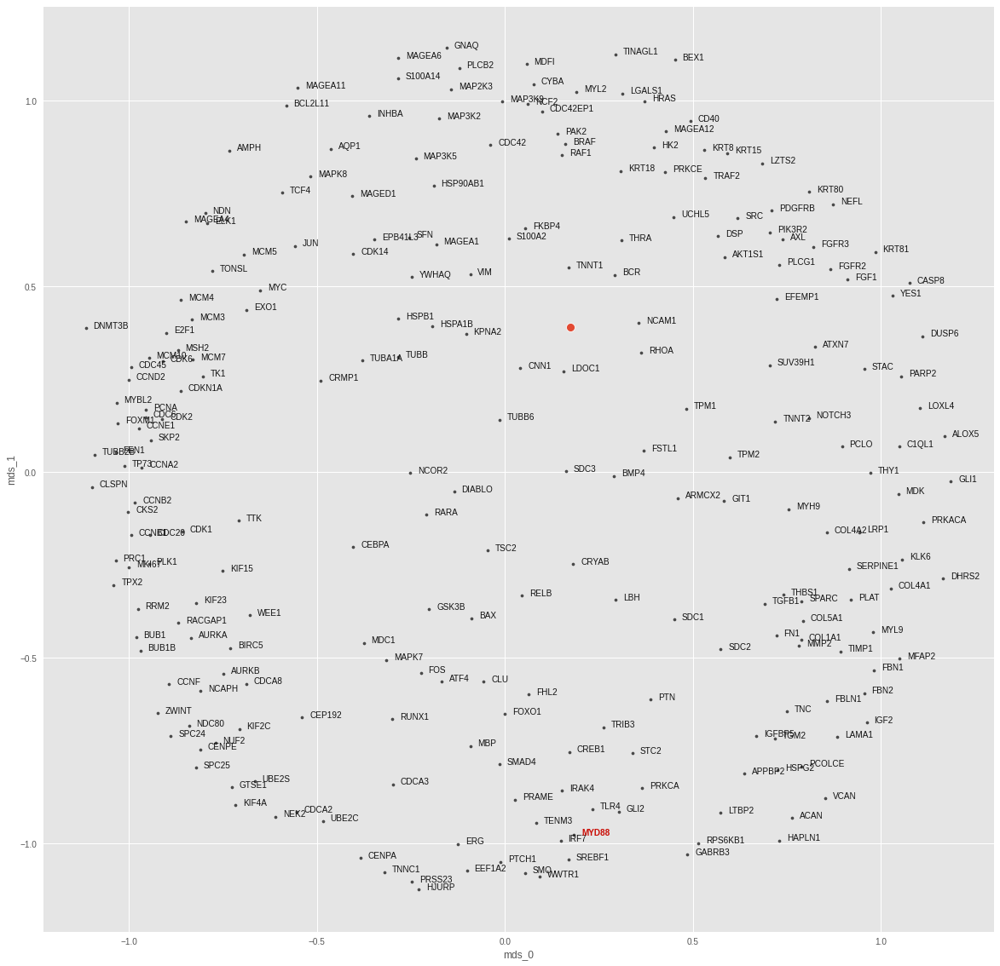

PIK3R2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 6.164717505223387e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0003030480002053082
test top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


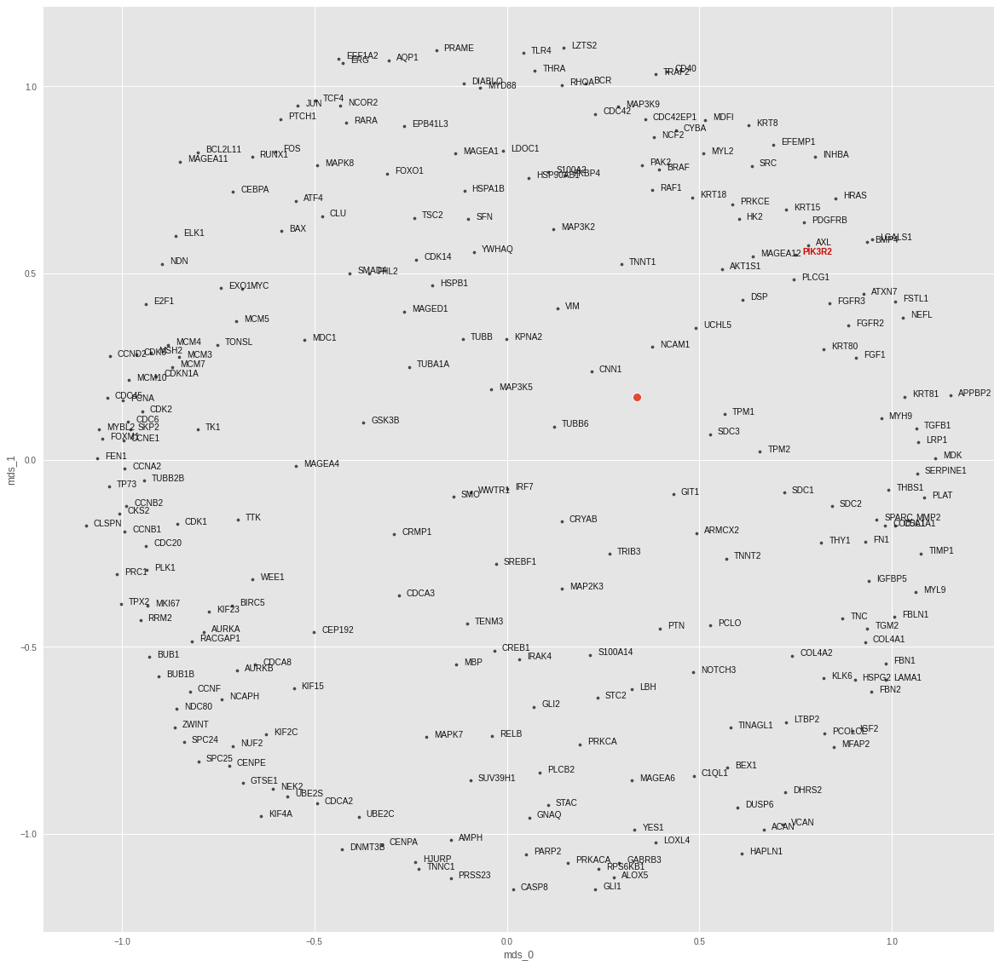

PRKACA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.0804096327295777e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001401954097673297
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


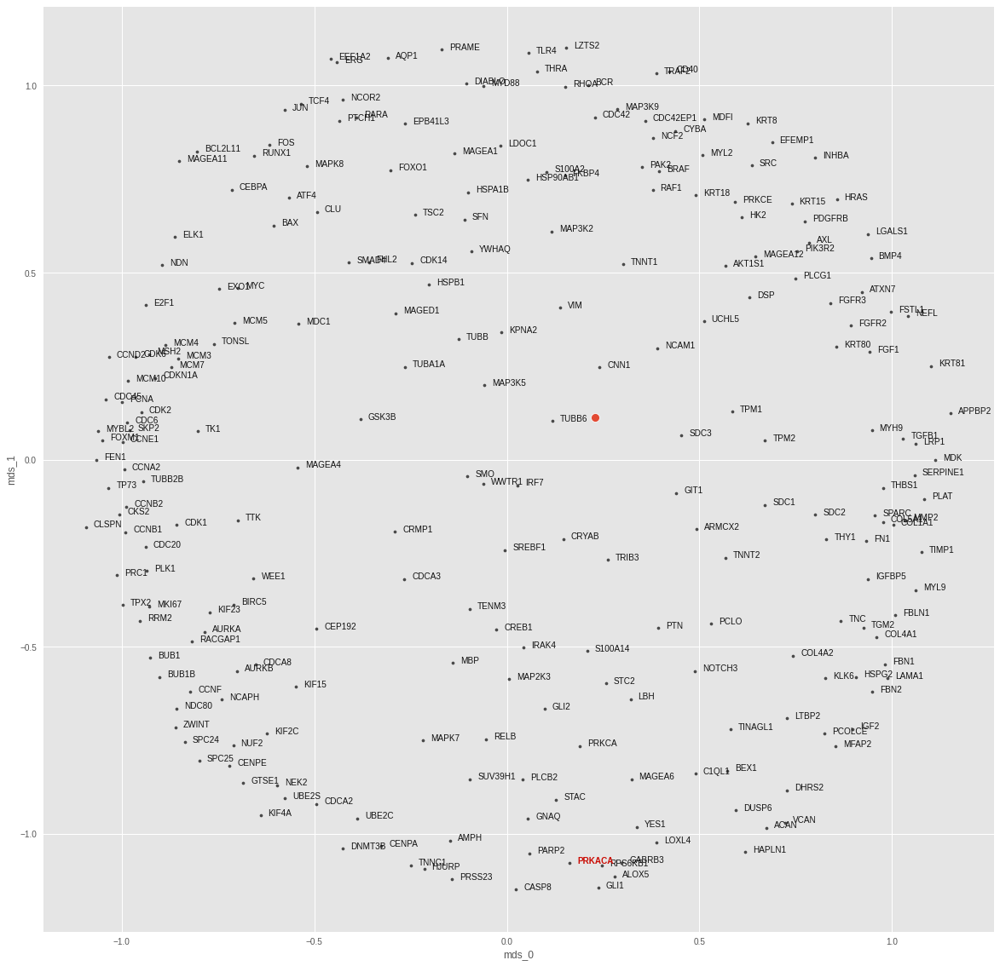

PRKCE
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.53927021023992e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00044552827603183687
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


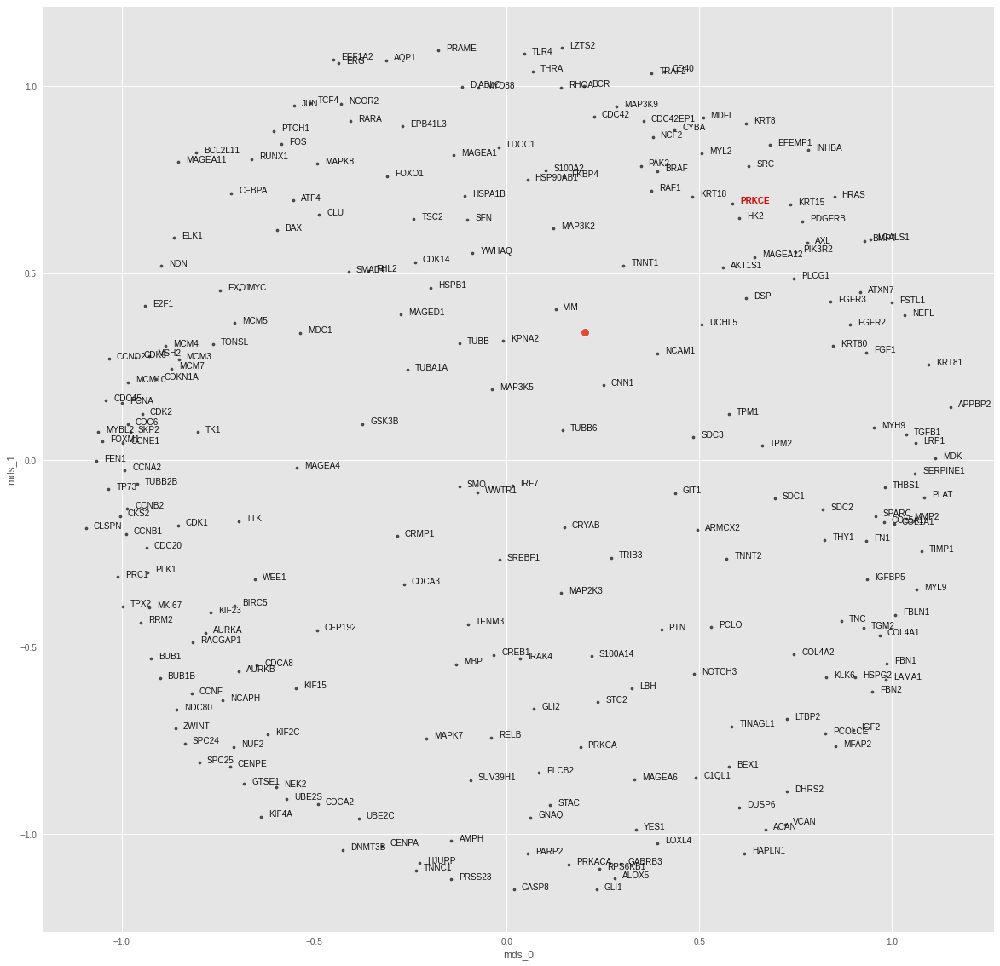

RAF1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 4.575685484030002e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0004078340716660023
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


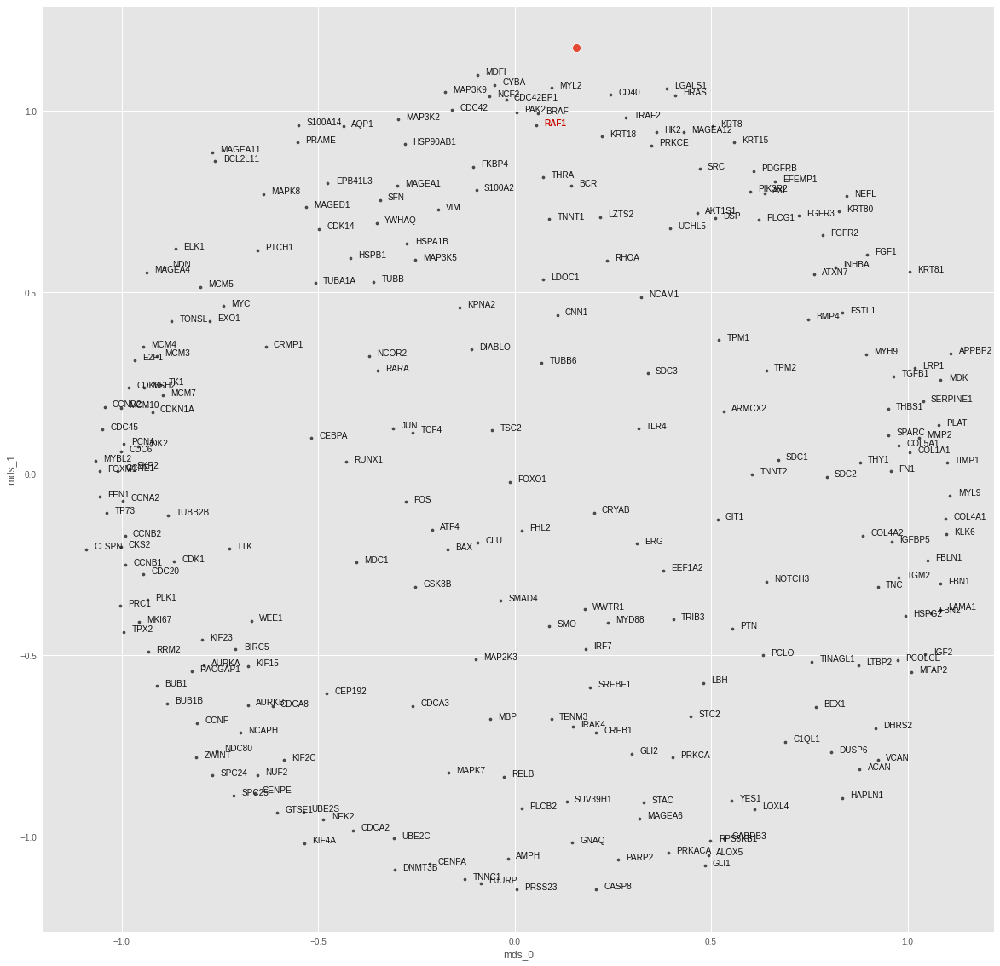

RELB
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 9.710769051564153e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0014992355136200786
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


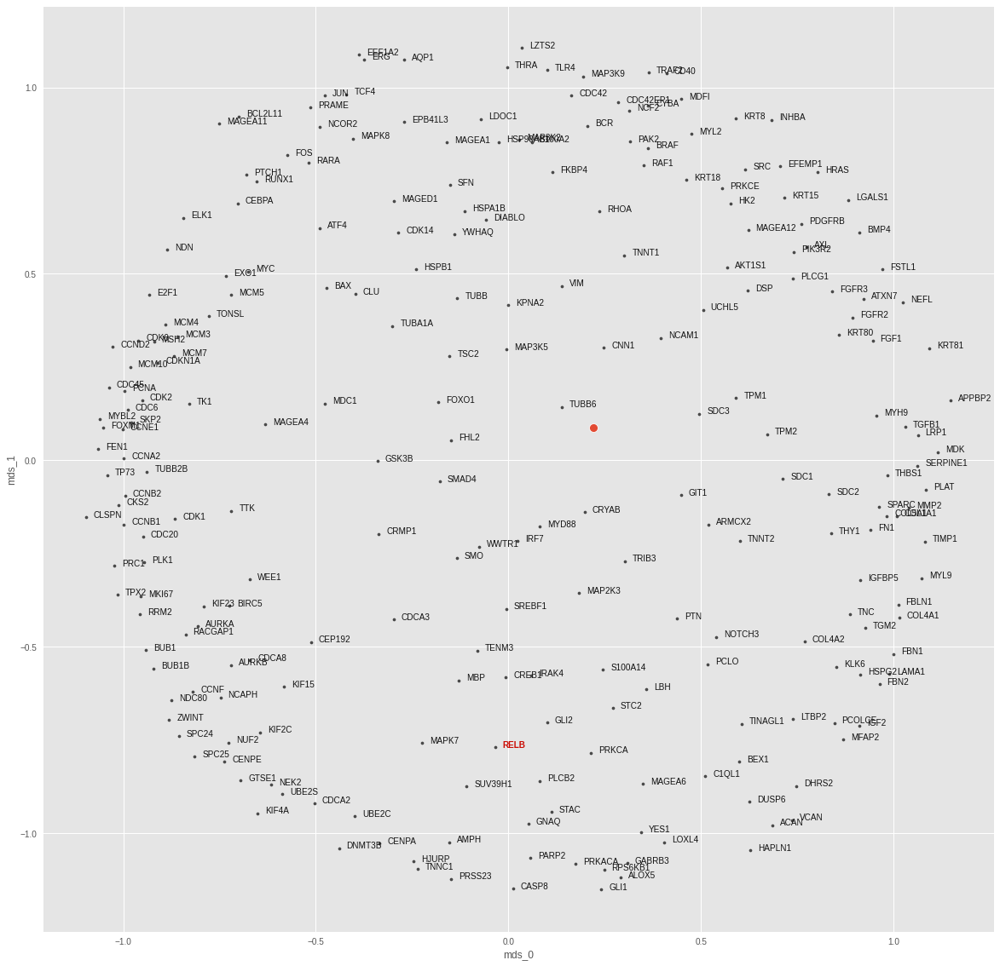

RHOA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 7.86309458003655e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0008088411996141076
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


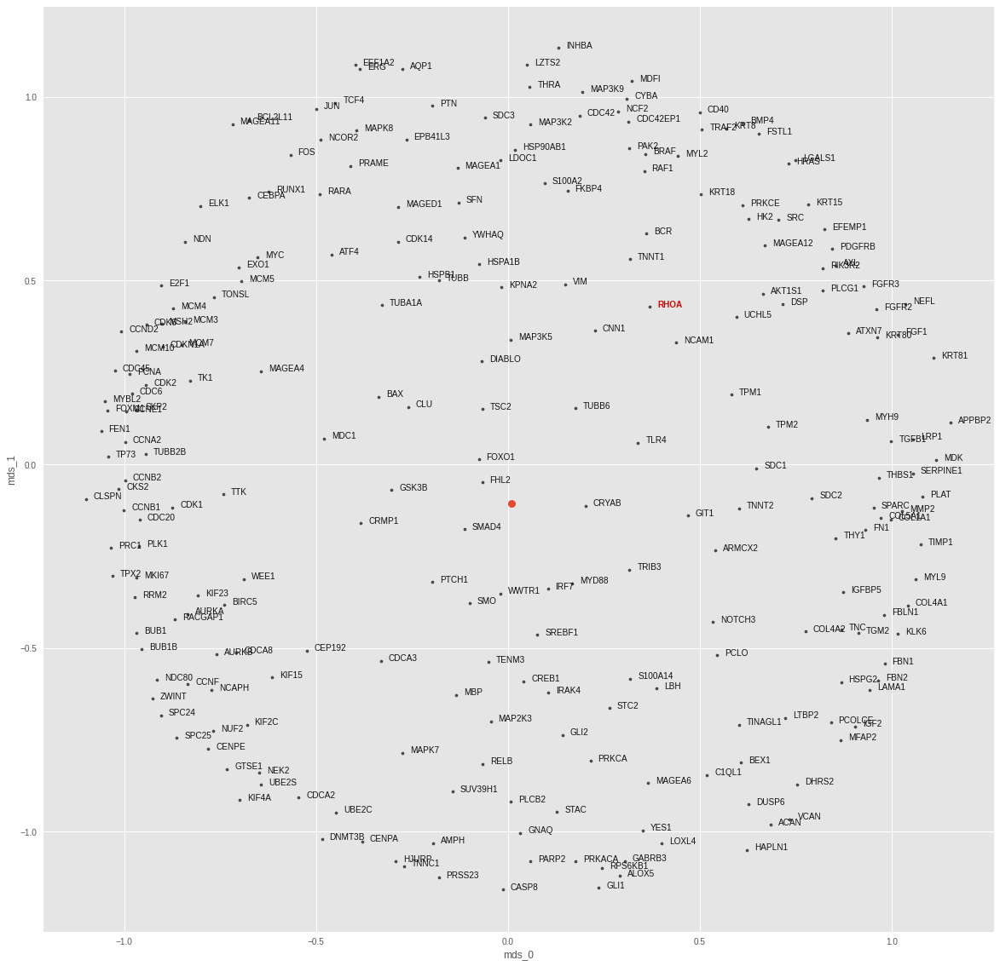

SMAD4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.525376709340459e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00159495510160923
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


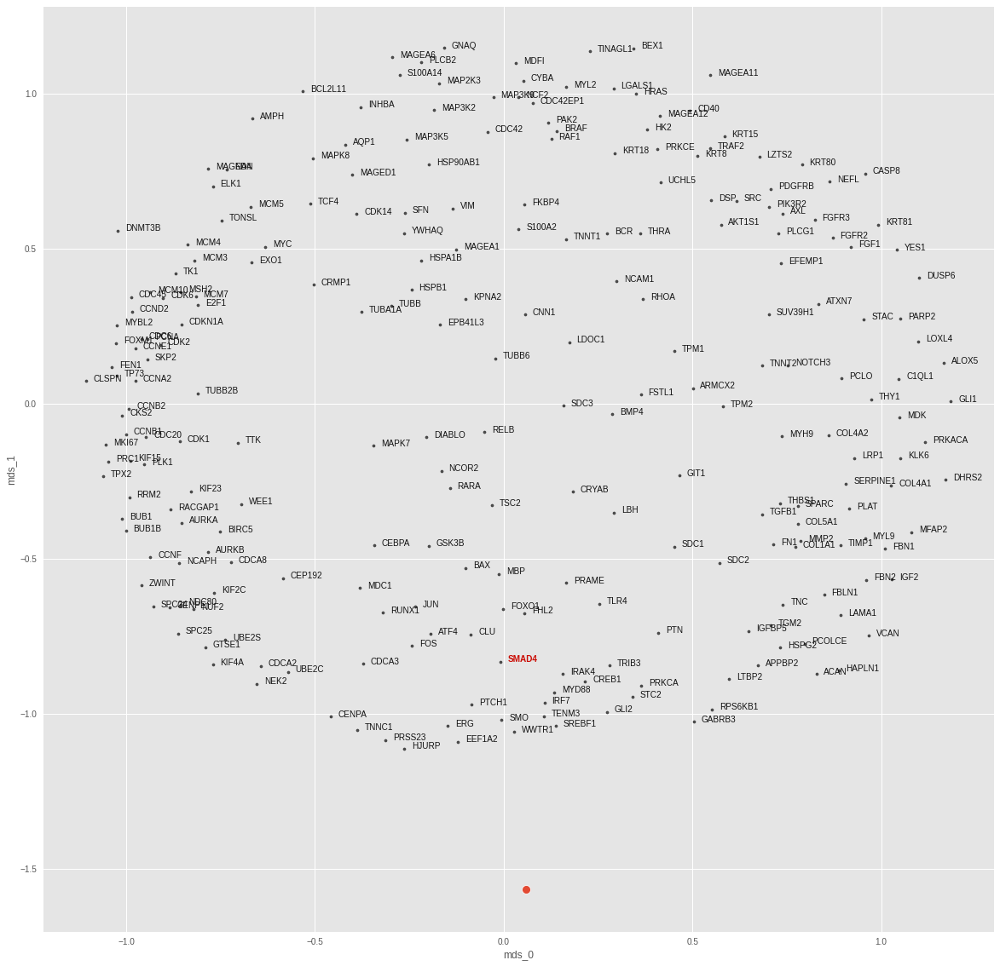

SMO
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.774969390740903e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0006118278251960874
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


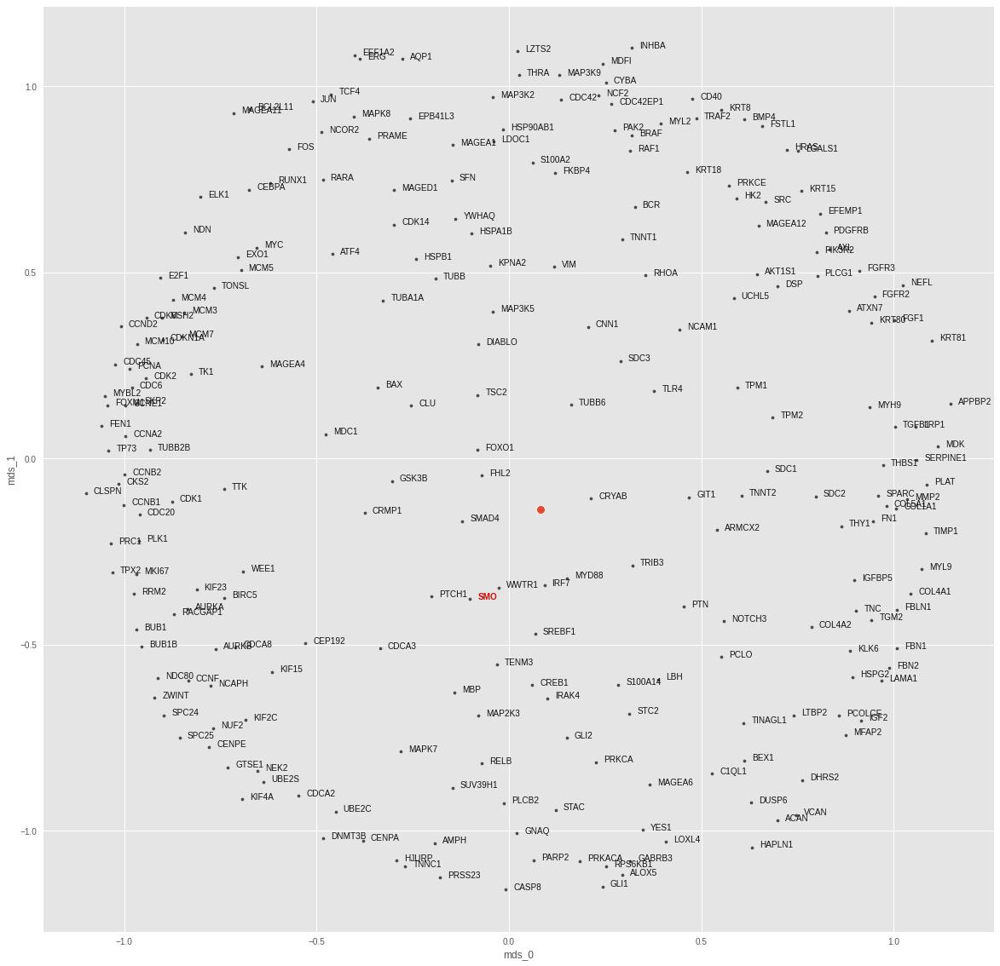

SRC
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.7778781437449844e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0007980710361152887
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


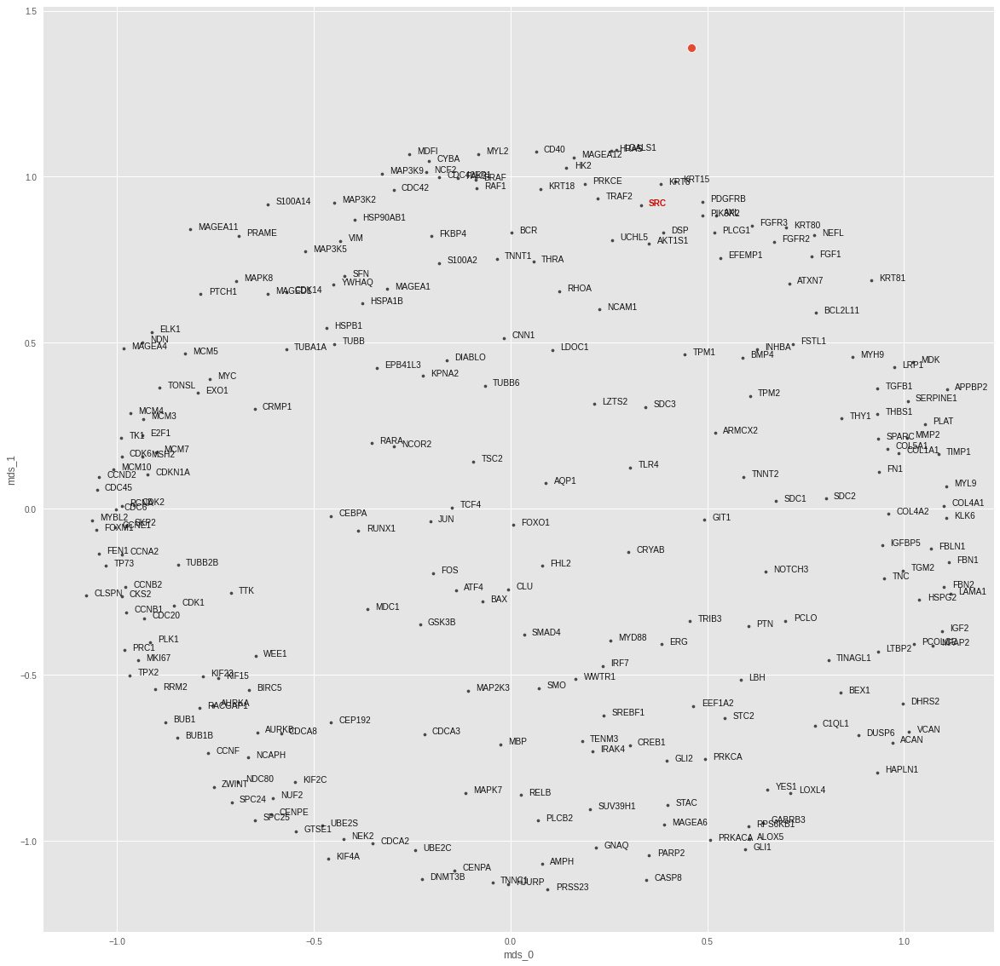

SREBF1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.4469293378887846e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0005839272052980959
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


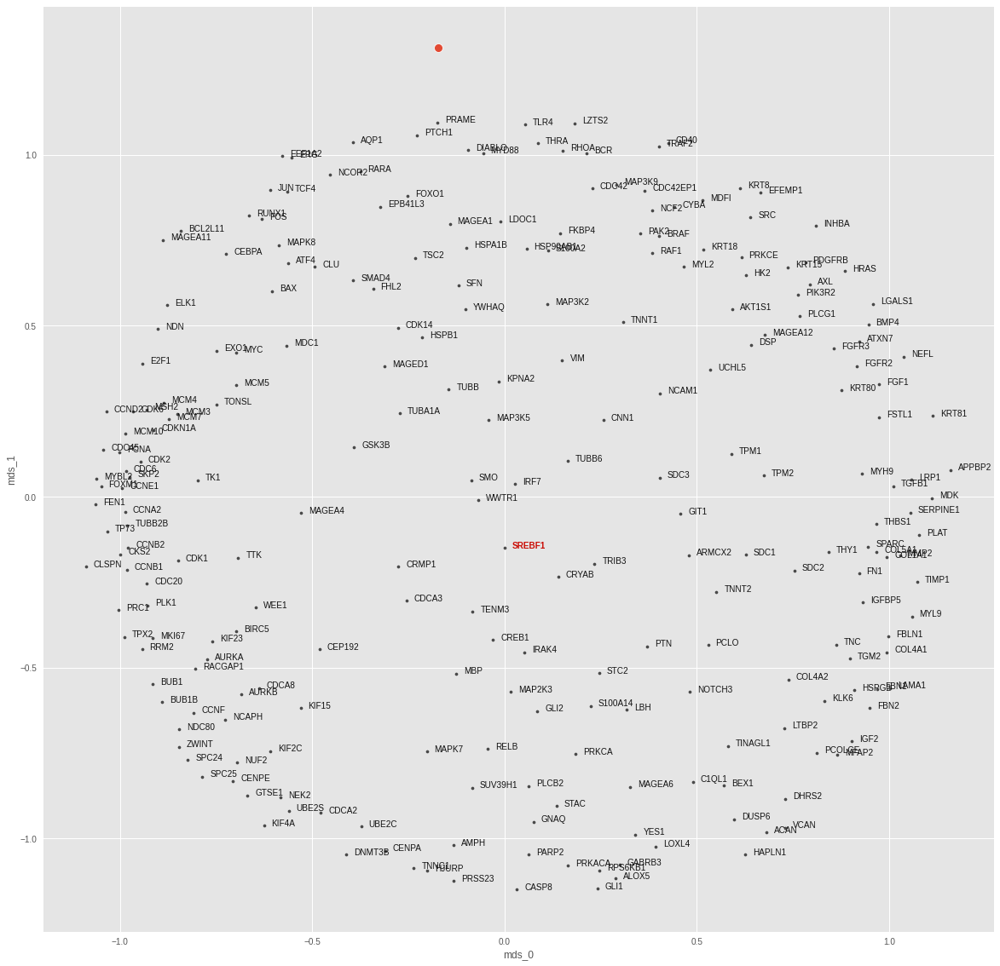

TRAF2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.875255132650062e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0013230221811681986
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


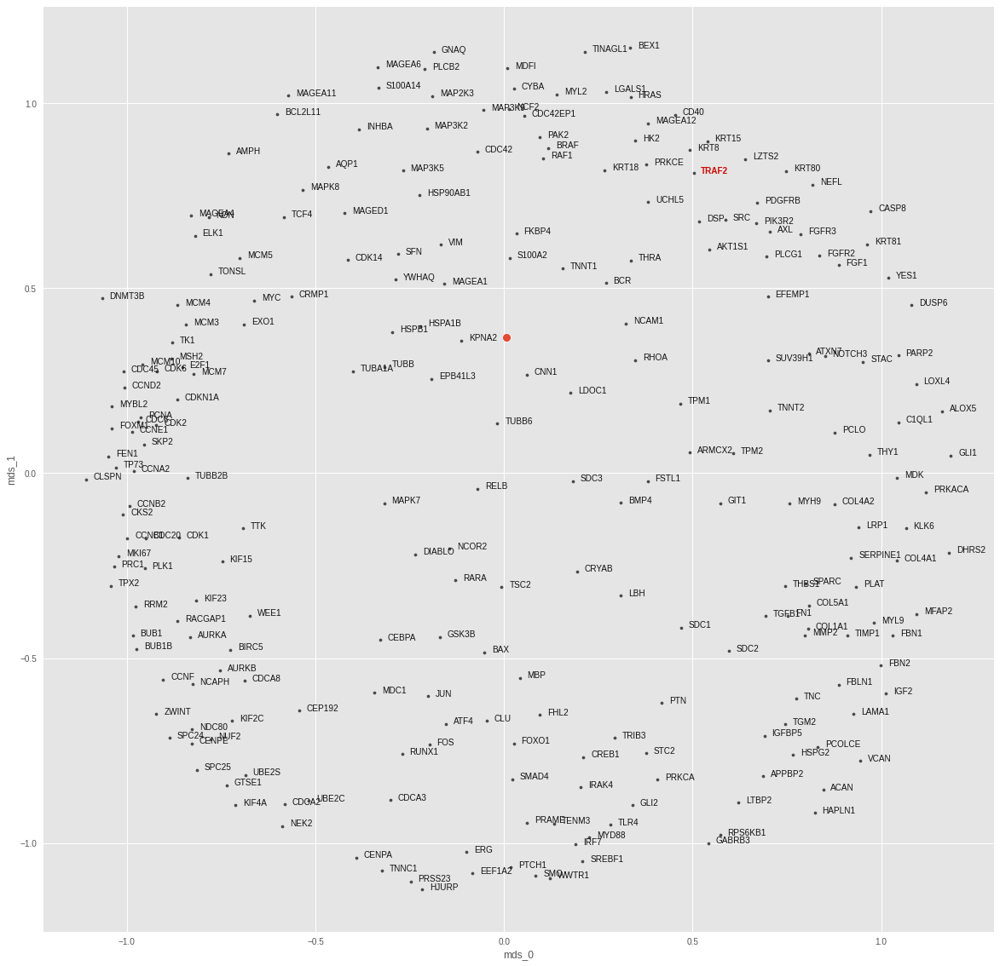

TSC2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.523434124393756e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0014279582537710667
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


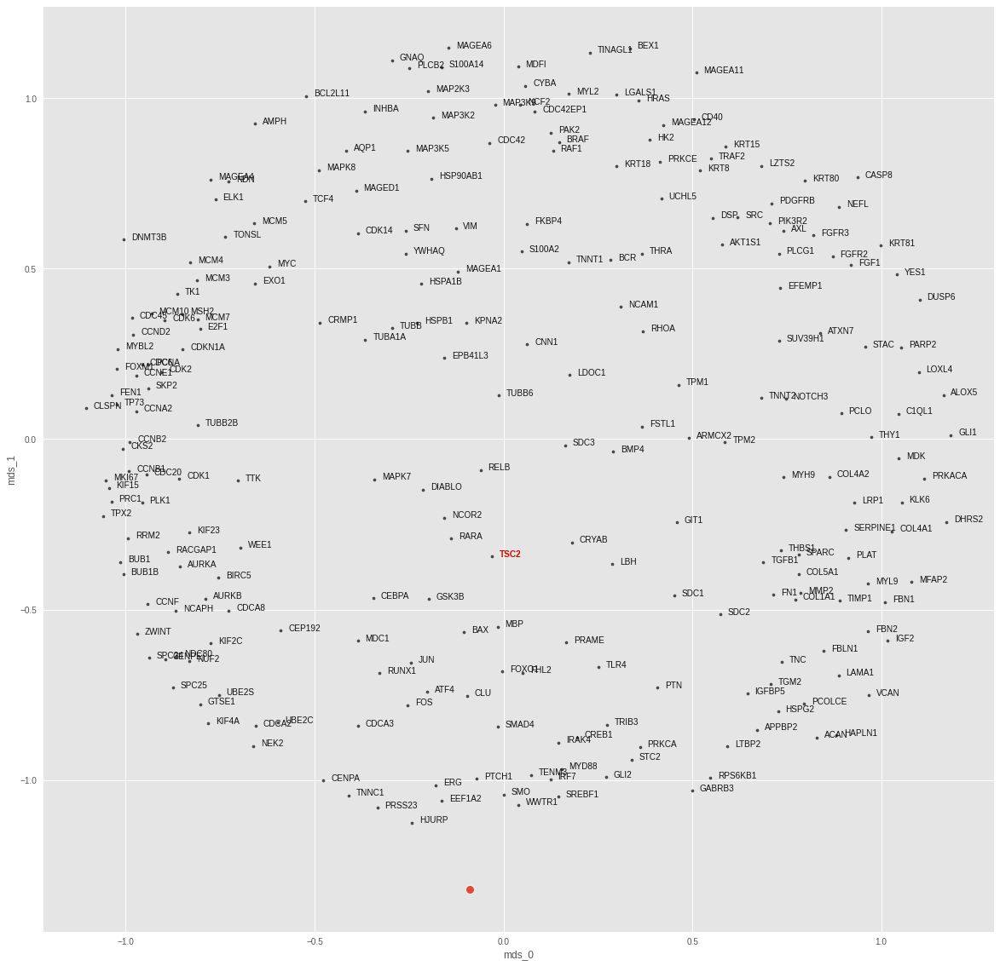

WWTR1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.7775092683824416e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0030103474855422974
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


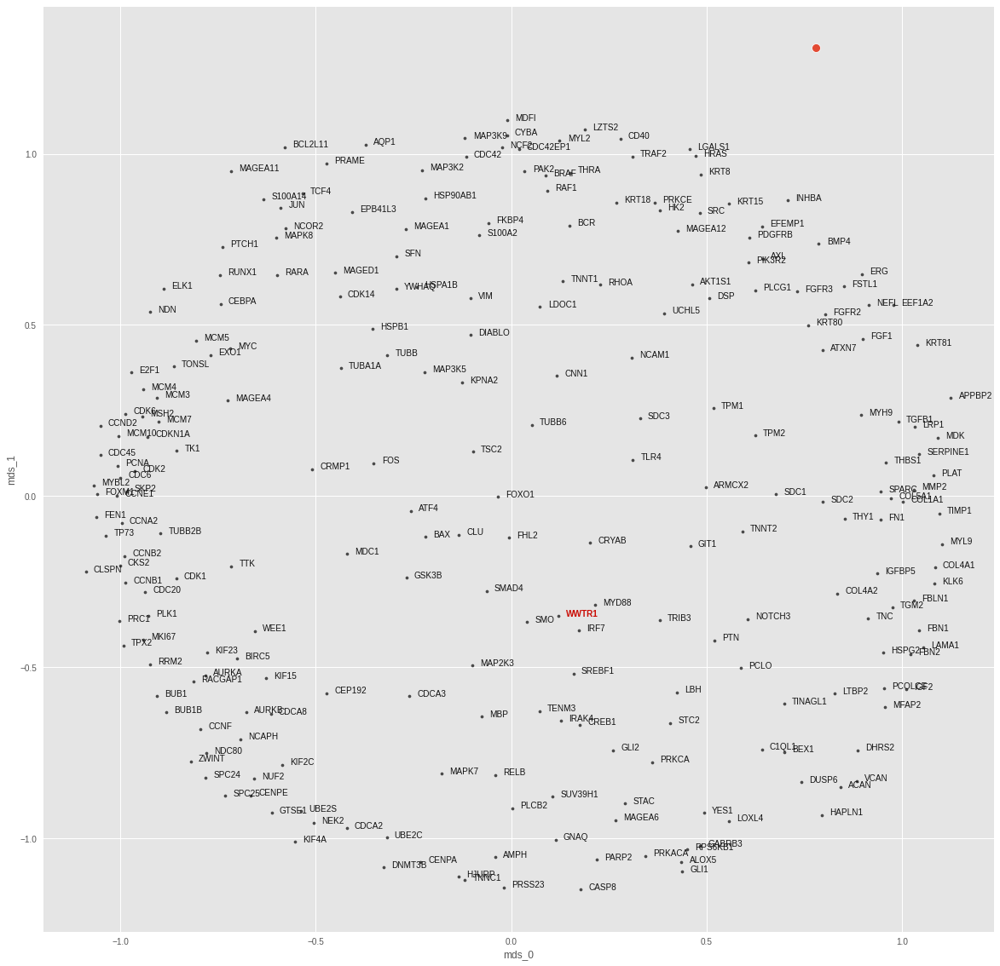

<IPython.core.display.Javascript object>

In [96]:
target_topk_accs = {}
mean_nonlin_nns = {}
for i in tqdm(range(len(data_dicts))):
    data_dict = data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, topk_acc, _, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=500,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = topk_acc
    mean_nonlin_nns[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [97]:
mean_nonlin_topk_df = pd.DataFrame(target_topk_accs).transpose()
mean_nonlin_topk_df.loc[mean_nonlin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
PIK3R2,1.0,1.0,1.0,1.0,1.0,1.0
BRAF,0.0,1.0,1.0,1.0,1.0,1.0
CASP8,0.0,1.0,1.0,1.0,1.0,1.0
MAP3K9,0.0,1.0,1.0,1.0,1.0,1.0
SMO,0.0,1.0,1.0,1.0,1.0,1.0
FOXO1,0.0,0.0,1.0,1.0,1.0,1.0
RAF1,0.0,0.0,1.0,1.0,1.0,1.0
AKT1S1,0.0,0.0,0.0,1.0,1.0,1.0
BCL2L11,0.0,0.0,0.0,1.0,1.0,1.0
DIABLO,0.0,0.0,0.0,1.0,1.0,1.0


<IPython.core.display.Javascript object>

In [98]:
mean_nonlin_topk_df.describe()

,1,3,5,10,20,50
count,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.025641,0.128205,0.179487,0.384615,0.564103,0.794872
std,0.160128,0.338688,0.388776,0.492864,0.502356,0.409074
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
75%,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

In [99]:
mean_nonlin_results = {"topk_acc": [], "k": []}
ks = list(range(50))
mean_nonlin_nn_topk = get_topk_acc_from_nn_dict(mean_nonlin_nns, ks=ks)
mean_nonlin_result = mean_nonlin_nn_topk.mean()
for k in ks:
    mean_nonlin_results["topk_acc"].append(mean_nonlin_result.loc["top-{}".format(k)])
    mean_nonlin_results["k"].append(k)
mean_nonlin_results = pd.DataFrame(mean_nonlin_results)

<IPython.core.display.Javascript object>

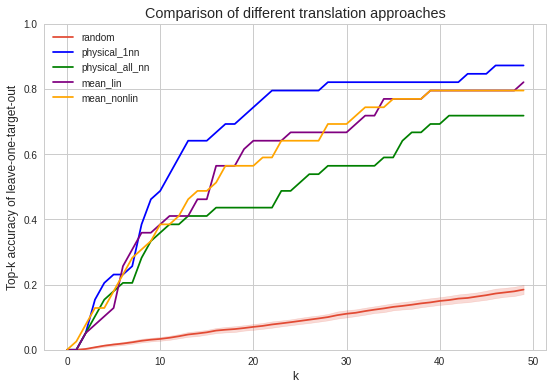

<IPython.core.display.Javascript object>

In [106]:
mpl.style.use("seaborn-whitegrid")
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.lineplot(
    data=random_lin_comb_results.loc[random_lin_comb_results.n == "1"],
    x="k",
    y="topk_acc",
    ax=ax,
    label="random",
)
ax.plot(
    np.array(lin_comb_results.loc[lin_comb_results.n == "1", "k"]),
    np.array(lin_comb_results.loc[lin_comb_results.n == "1", "topk_acc"]),
    label="physical_1nn",
    color="blue",
)
ax.plot(
    np.array(lin_comb_results.loc[lin_comb_results.n == "38", "k"]),
    np.array(lin_comb_results.loc[lin_comb_results.n == "38", "topk_acc"]),
    label="physical_all_nn",
    color="green",
)
ax.plot(
    np.array(mean_lin_results.loc[:, "k"]),
    np.array(mean_lin_results.loc[:, "topk_acc"]),
    label="mean_lin",
    color="purple",
)
ax.plot(
    np.array(mean_nonlin_results.loc[:, "k"]),
    np.array(mean_nonlin_results.loc[:, "topk_acc"]),
    label="mean_nonlin",
    color="orange",
)
ax.legend()
ax.set_ylabel("Top-k accuracy of leave-one-target-out")
ax.set_ylim([0, 1])
ax.set_title("Comparison of different translation approaches")
plt.show()

---

### 2.4. Structural NN centroid translation

Next, we will move away from representing the structural phenotype induced by a single gene overexpression by the population mean of the cellular embeddings. Instead we have identified four different structural phenotype clusters per condition using 4-means clustering. Using those we aim to establish the translation between the structural and regulatory space.

To this end, we will first identify the one nearest neighbor of each cluster centroid for each target that does not correspond to the same gene overexpression condition. Next, we compute the mean embedding in the regulatory space of the corresponding one-nearest neighbors for each of the four cluster centroids. Finally, we assess the local neighborhood of this latent space location in a similar setting as before.

In [ ]:
cl_img_embs_fold0, cl_node_embs_fold0, labels = cl_img_node_embs_dict["fold0"]

In [ ]:
struct_nn_centroid_pred_dict = get_struct_nn_centroid_translation_dict(
    cl_img_embs_fold0, node_embs
)
struct_nn_centroid_topk = get_topk_acc_from_nn_dict(struct_nn_centroid_pred_dict)
struct_nn_centroid_topk.describe()

---

### 3.5. Linear 4-centroids mapping

In [ ]:
cl_img_embs_fold0, cl_node_embs_fold0, labels = cl_img_node_embs_dict["fold0"]
cl_data_dicts = get_logo_data_dicts(
    data=cl_img_embs_fold0,
    labels=cl_node_embs_fold0,
    val_size=0,
    group_labels=np.array(labels),
    batch_size=32,
    balanced=False,
    scale_x=False,
    scale_y=False,
)

In [ ]:
target_topk_accs = {}
cl_lin_nns_dict = {}
for i in tqdm(range(len(cl_data_dicts))):
    data_dict = cl_data_dicts[i]
    model = torch.nn.Sequential(torch.nn.Linear(1024, 1024))
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, _, mean_topk_acc, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = mean_topk_acc
    cl_lin_nns_dict[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [ ]:
cl_lin_topk_df = pd.DataFrame(target_topk_accs).transpose()
cl_lin_topk_df.loc[cl_lin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

In [ ]:
cl_lin_topk_df.describe()

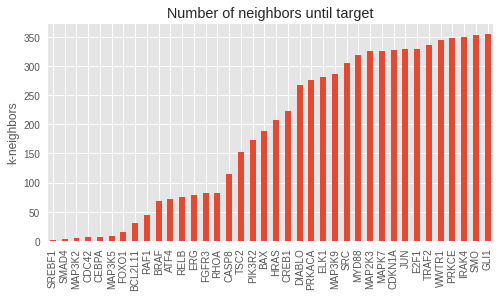

<IPython.core.display.Javascript object>

In [42]:
mpl.style.use("ggplot")
cl_lin_khits = get_knn_hit_data(cl_lin_nns_dict)
ax = cl_lin_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

In [43]:
cl_img_embs, _, cl_labels = cl_img_node_embs_dict["fold0"]
centroid_5nn_dict = get_centroid_knn_dict(cl_img_embs, cl_labels, k=5)
centroid_5nn_dict["ELK1"]

['MAP3K9', 'SMAD4', 'E2F1', 'PRKACA', 'ATF4']

<IPython.core.display.Javascript object>

In [44]:
cl_lin_nns_dict["ELK1"][:5]

array(['MYD88', 'PFKL', 'FAS', 'IRAK1', 'CASP8'], dtype='<U9')

<IPython.core.display.Javascript object>

In [45]:
cl_lin_results = {"topk_acc": [], "k": []}
ks = list(range(50))
cl_lin_nn_topk = get_topk_acc_from_nn_dict(cl_lin_nns_dict, ks=ks)
cl_lin_result = cl_lin_nn_topk.mean()
for k in ks:
    cl_lin_results["topk_acc"].append(cl_lin_result.loc["top-{}".format(k)])
    cl_lin_results["k"].append(k)
cl_lin_results = pd.DataFrame(cl_lin_results)

<IPython.core.display.Javascript object>

---

### 3.6. Non-linear 4-centroids mapping

  0%|          | 0/38 [00:00<?, ?it/s]

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.544011875897382e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0038803699426352978
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


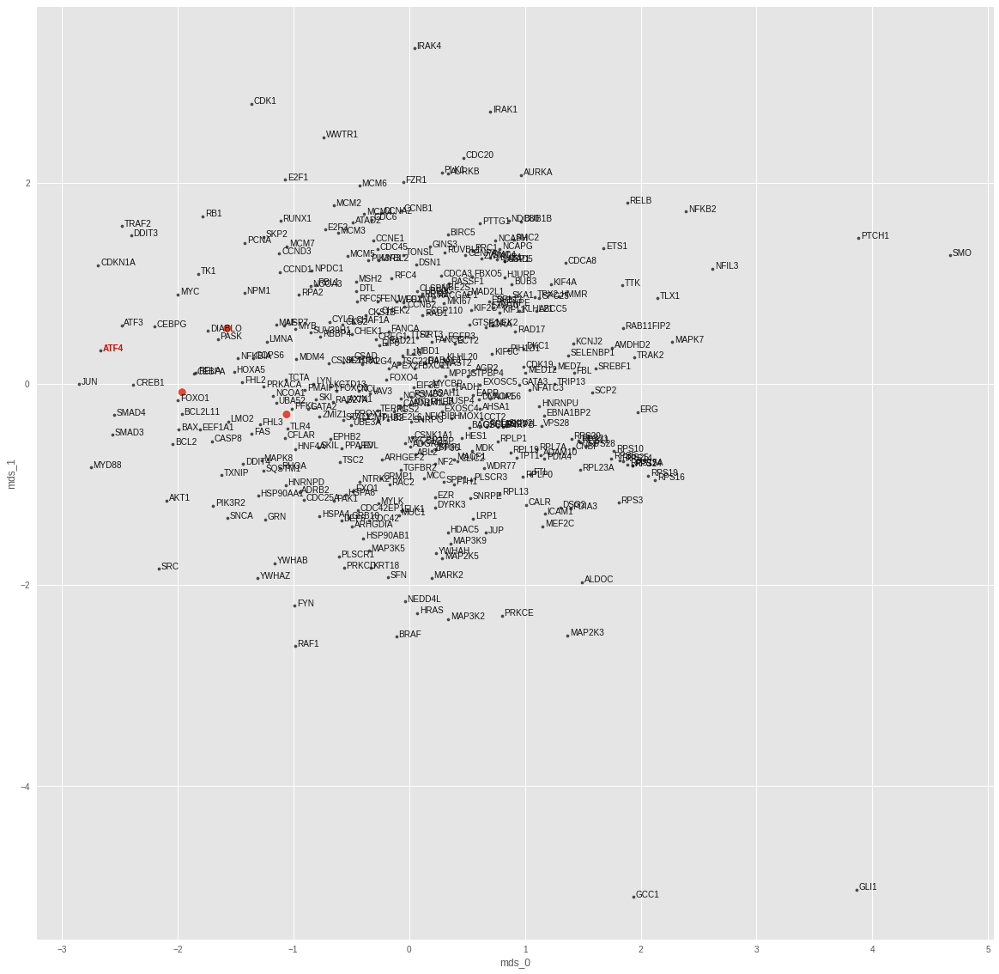

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 4.046680612543594e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0060691386461257935
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


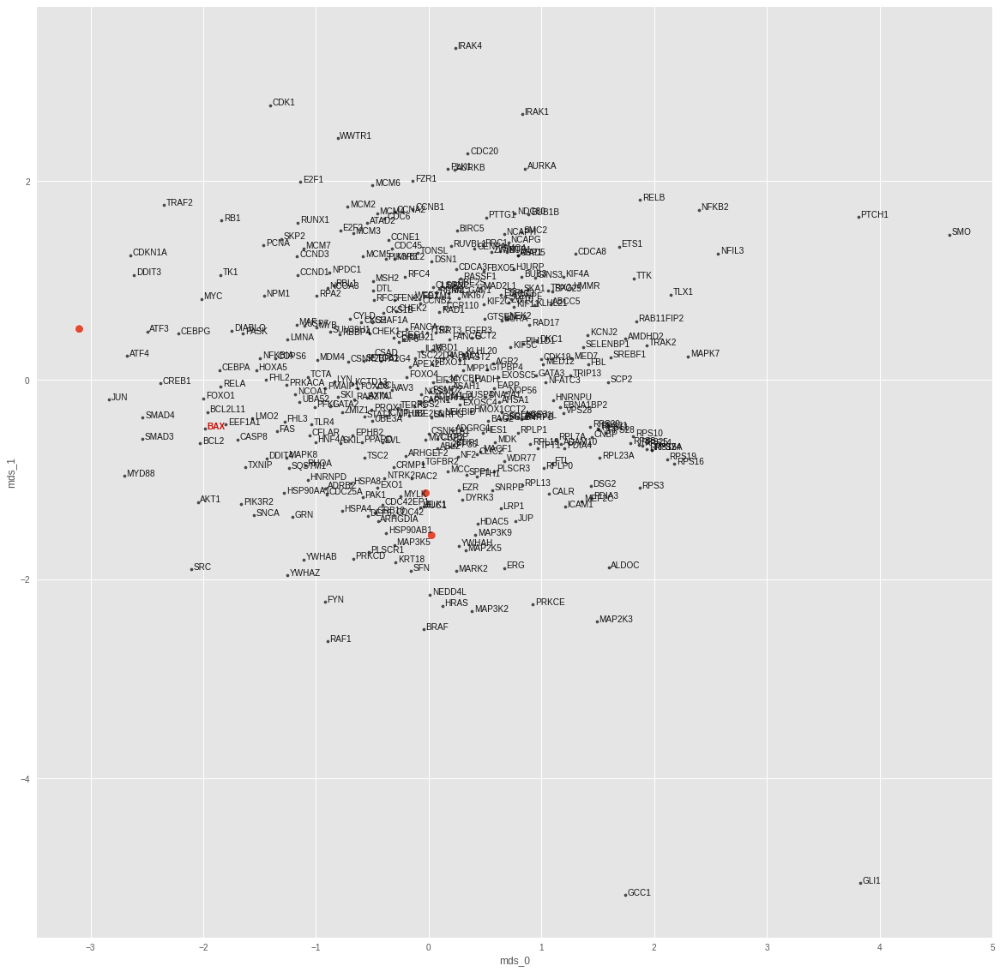

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.894970996053113e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006662684492766857
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.666667, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


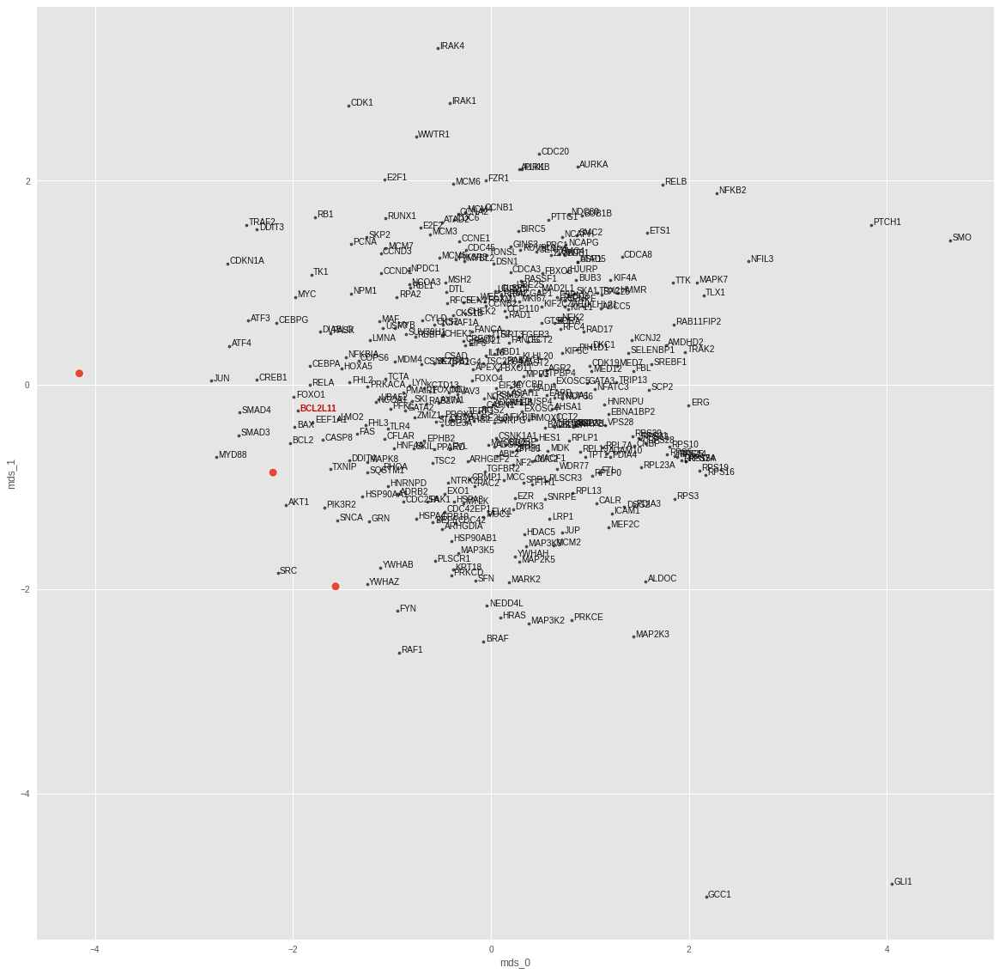

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.385546416264481e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004022106993943453
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


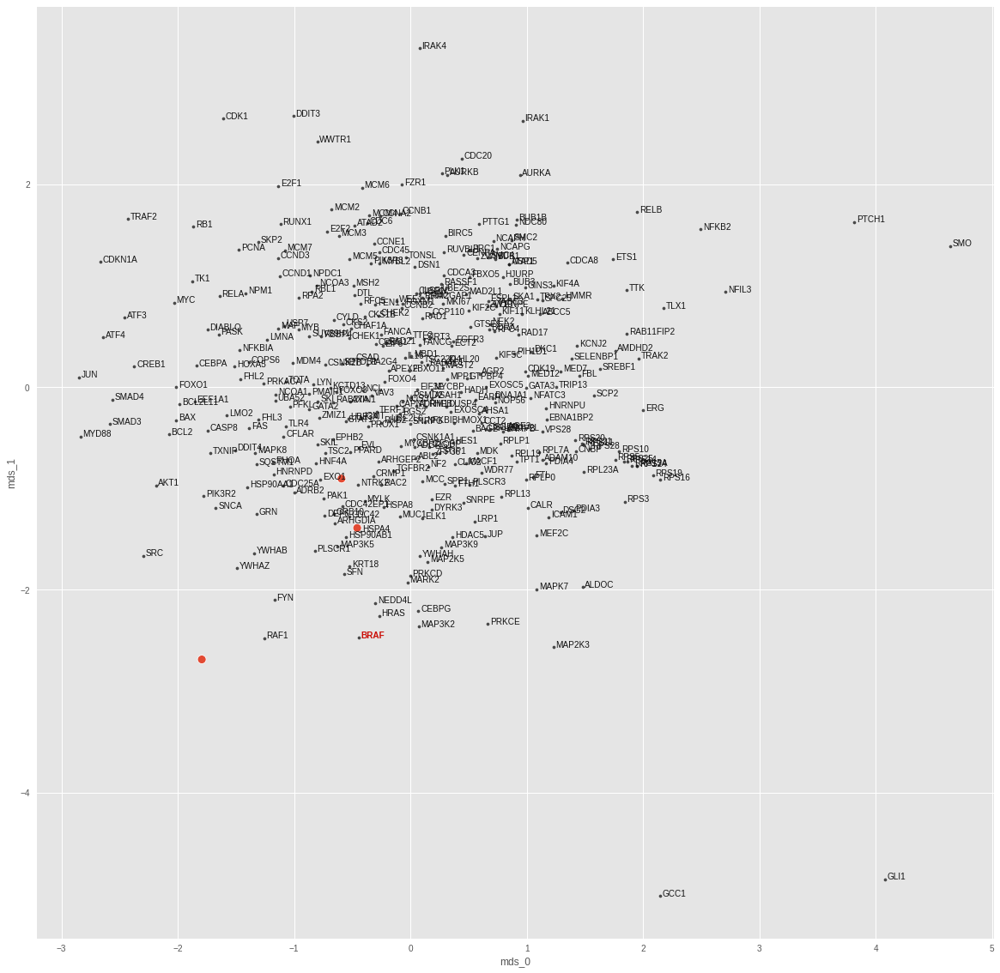

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.882687833246163e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005649722181260586
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


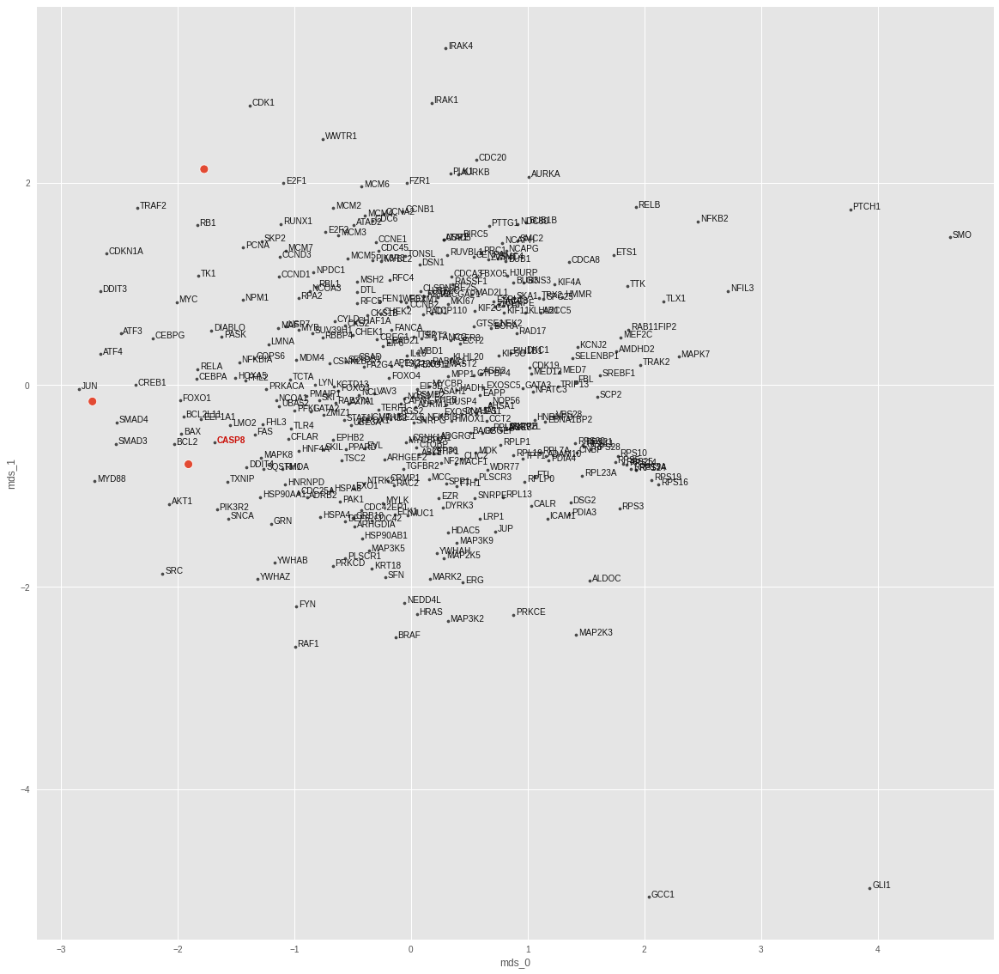

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.18709231091916e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0053036827594041824
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.666667, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


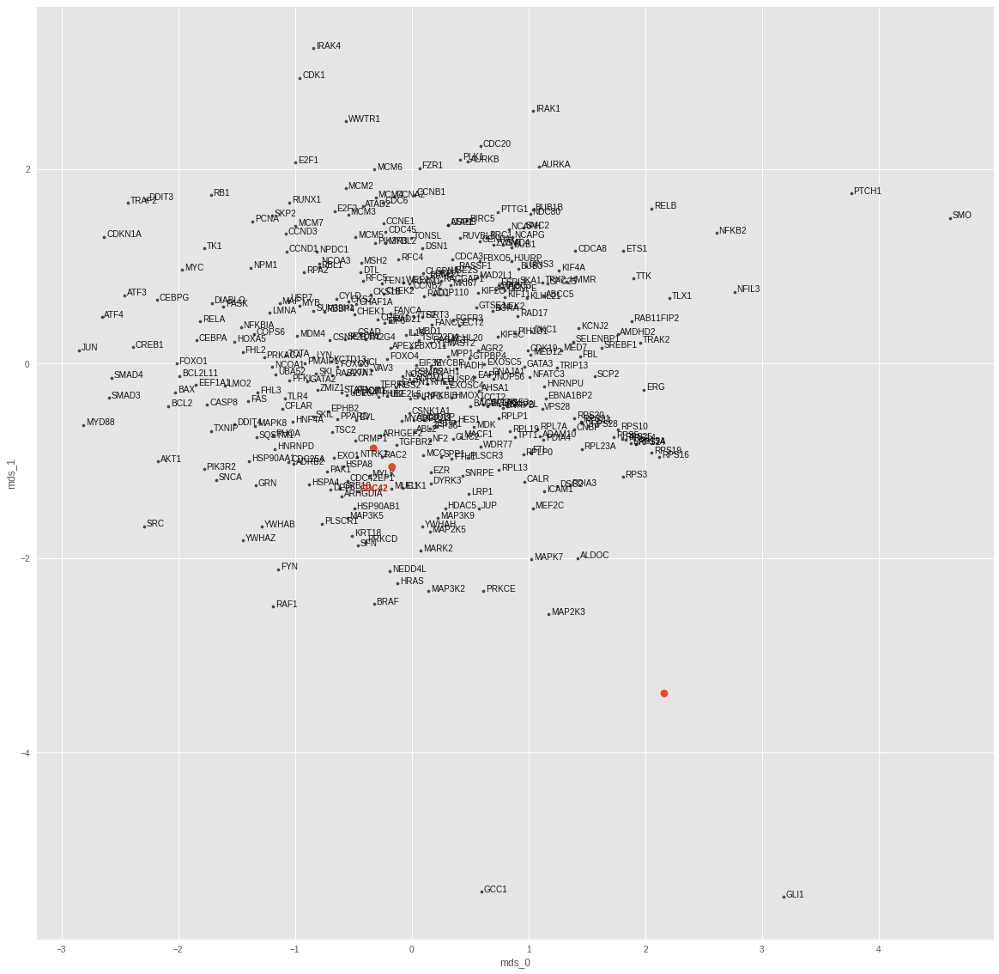

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.71229778892971e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.01081475056707859
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


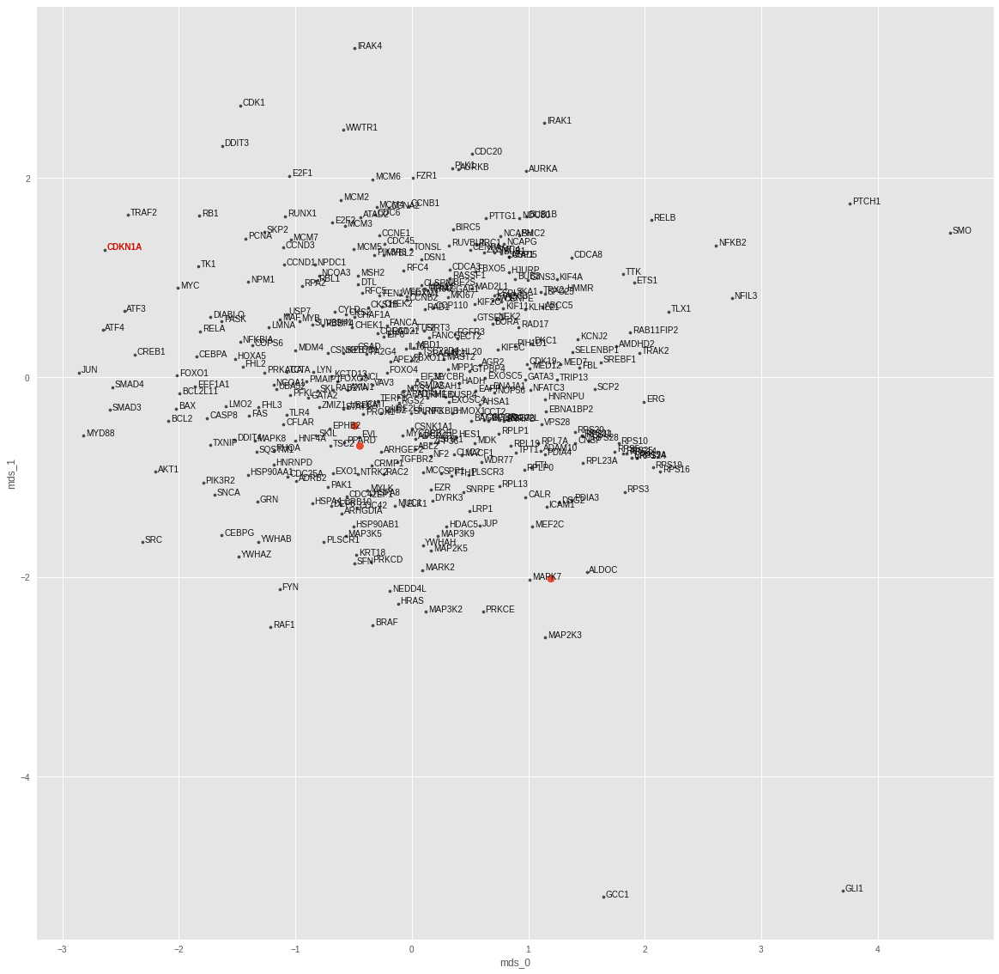

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.124797300527896e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0019734848756343126
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


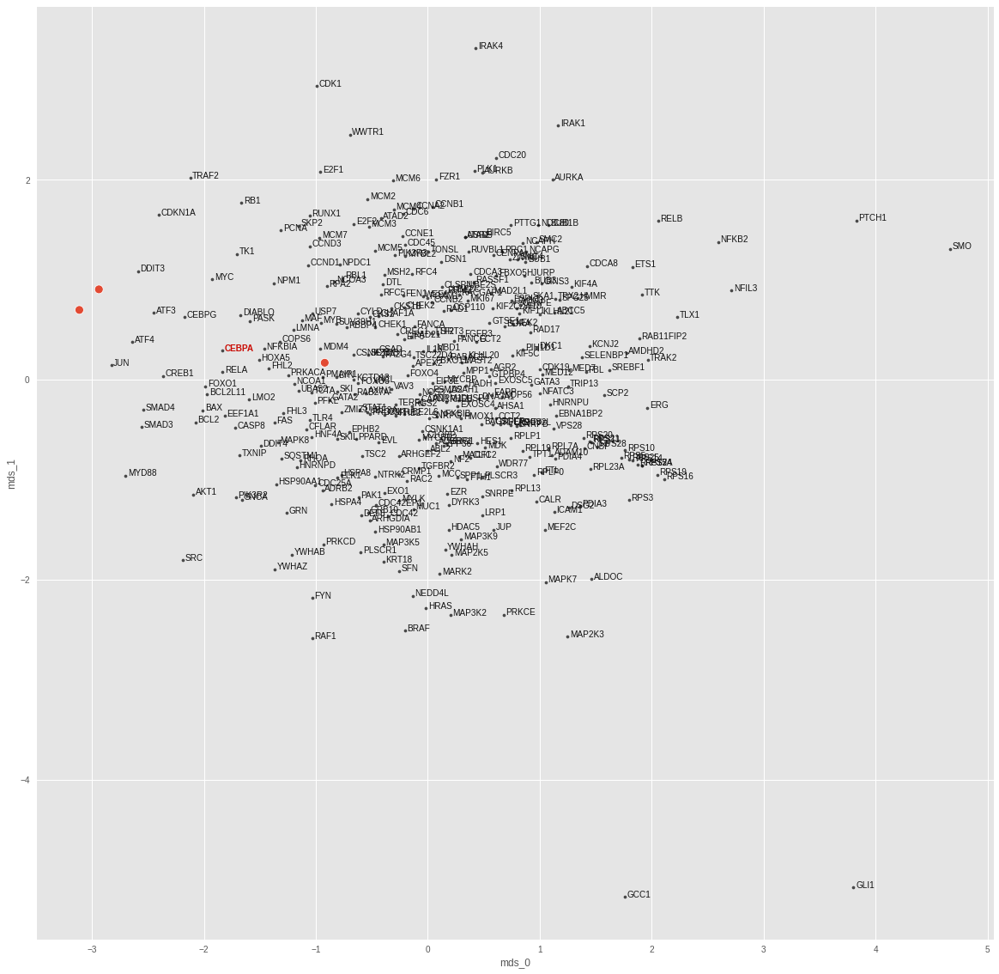

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.277363520925802e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0022026249207556248
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


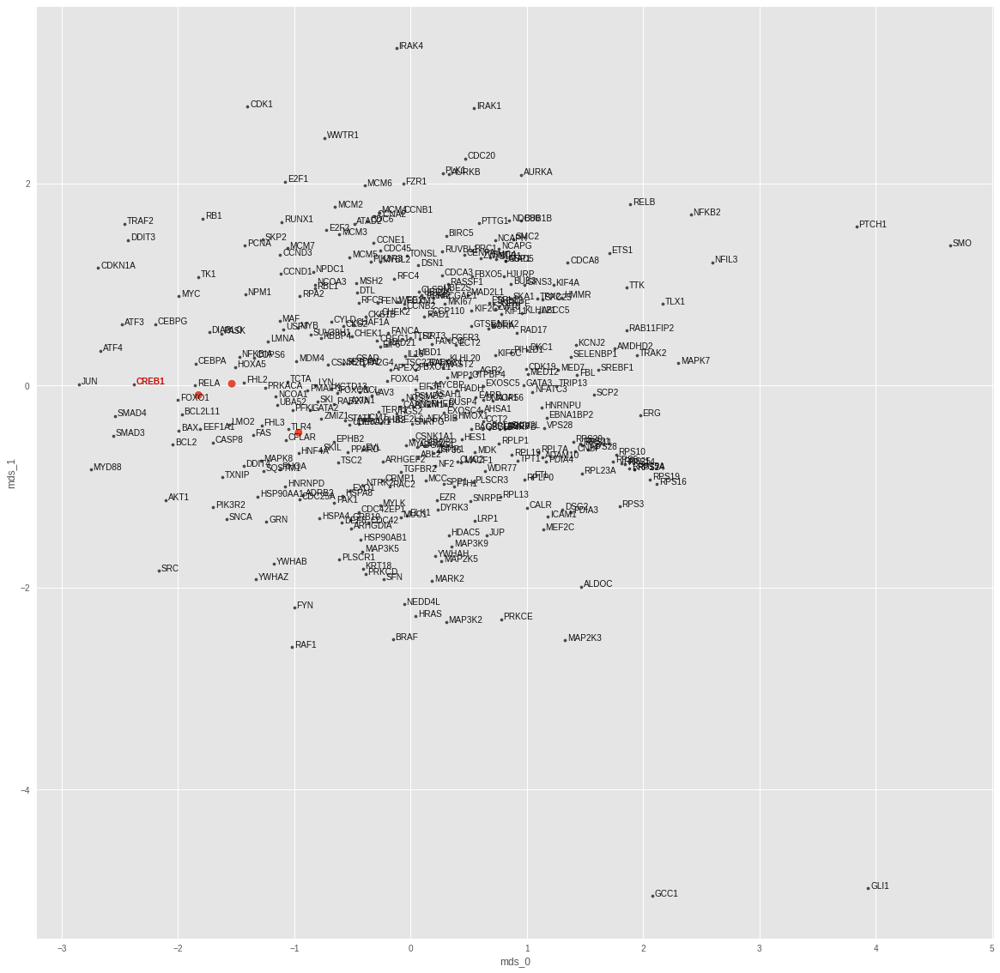

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.2827022449831324e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.058301299810409546
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


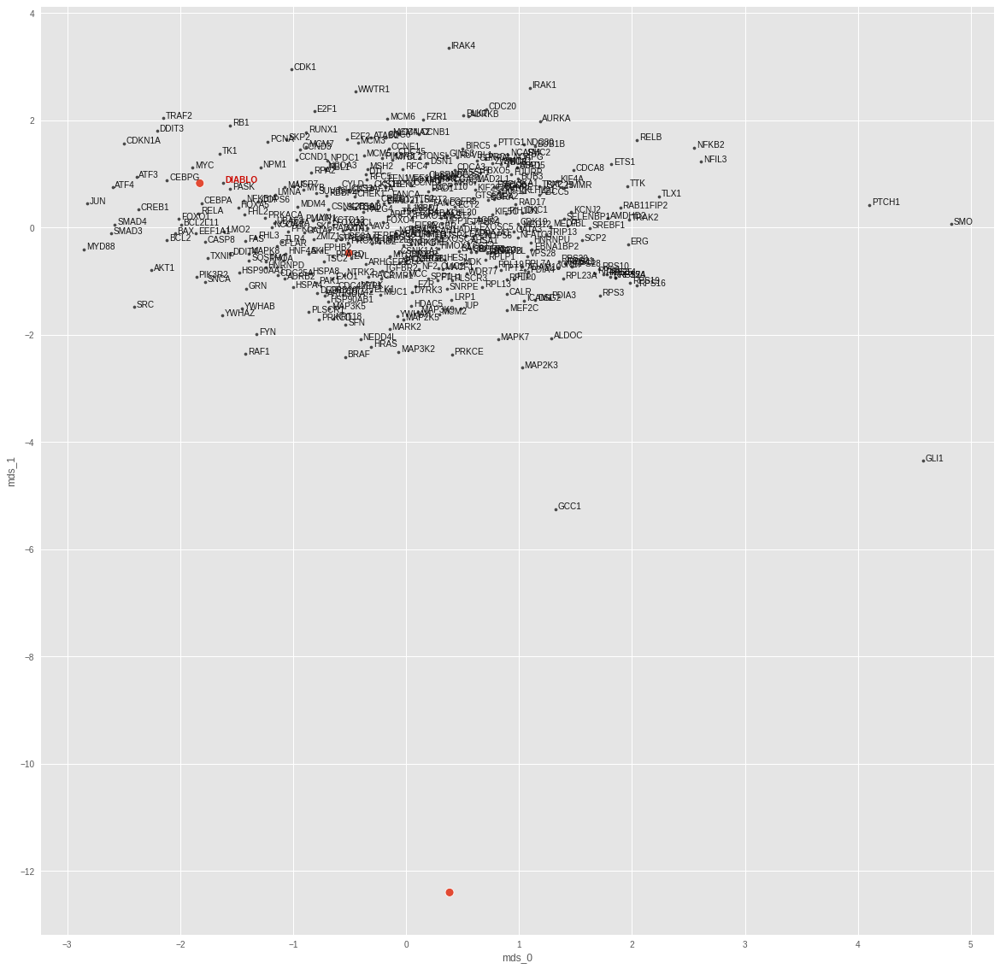

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 4.112902279876499e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.012950378470122814
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


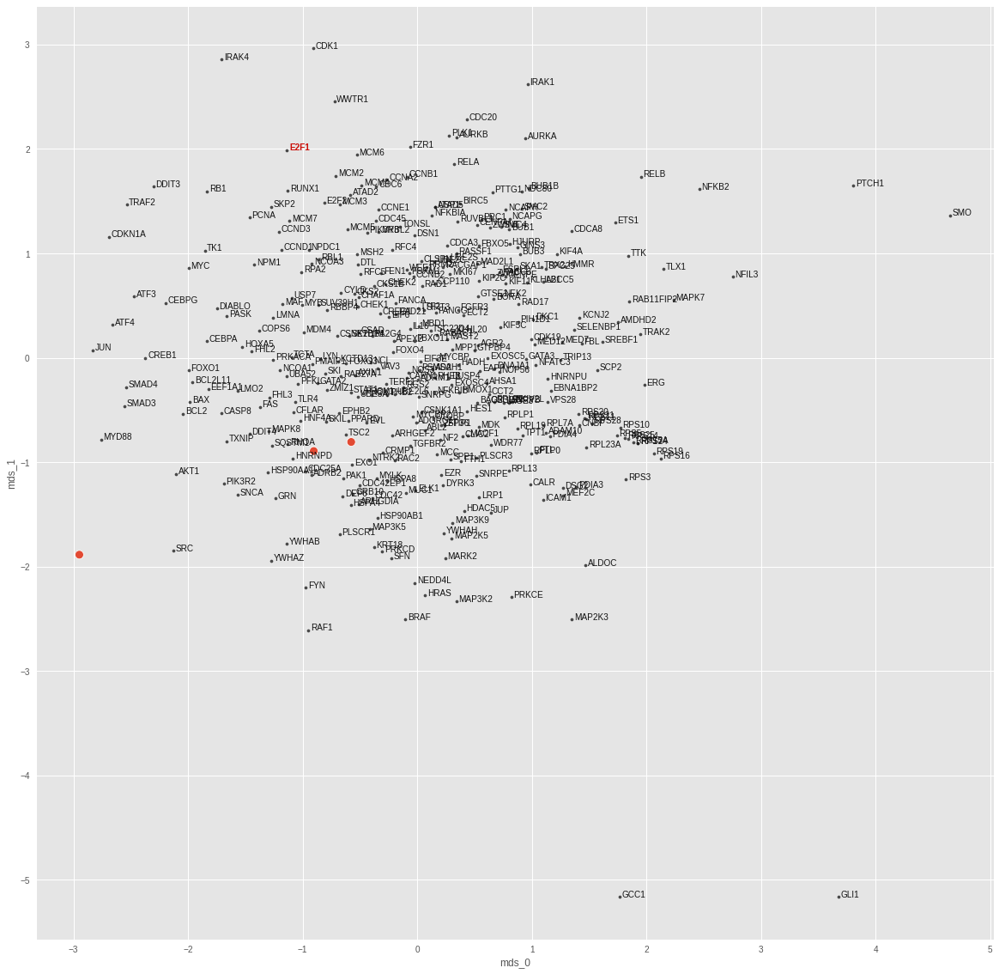

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.174598614975489e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0050033400766551495
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


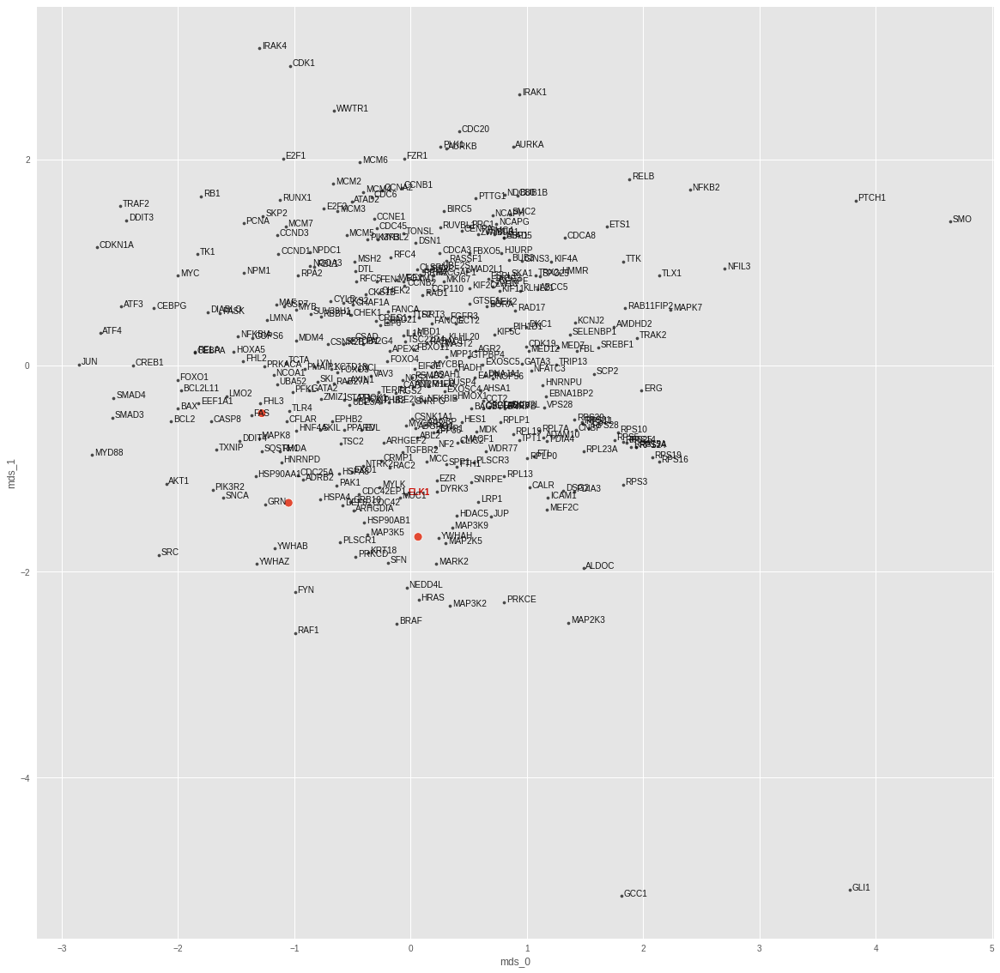

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0993883267007265e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006087770219892263
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


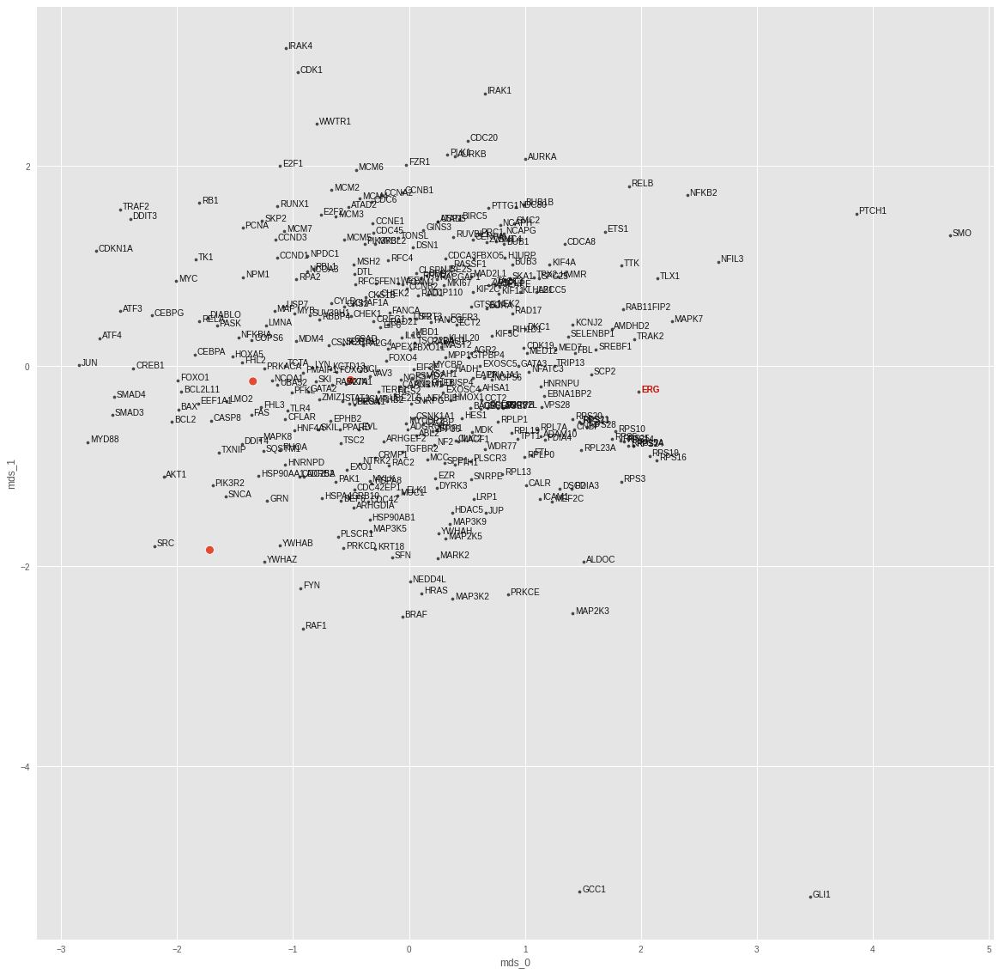

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.032671187014785e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003116513602435589
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


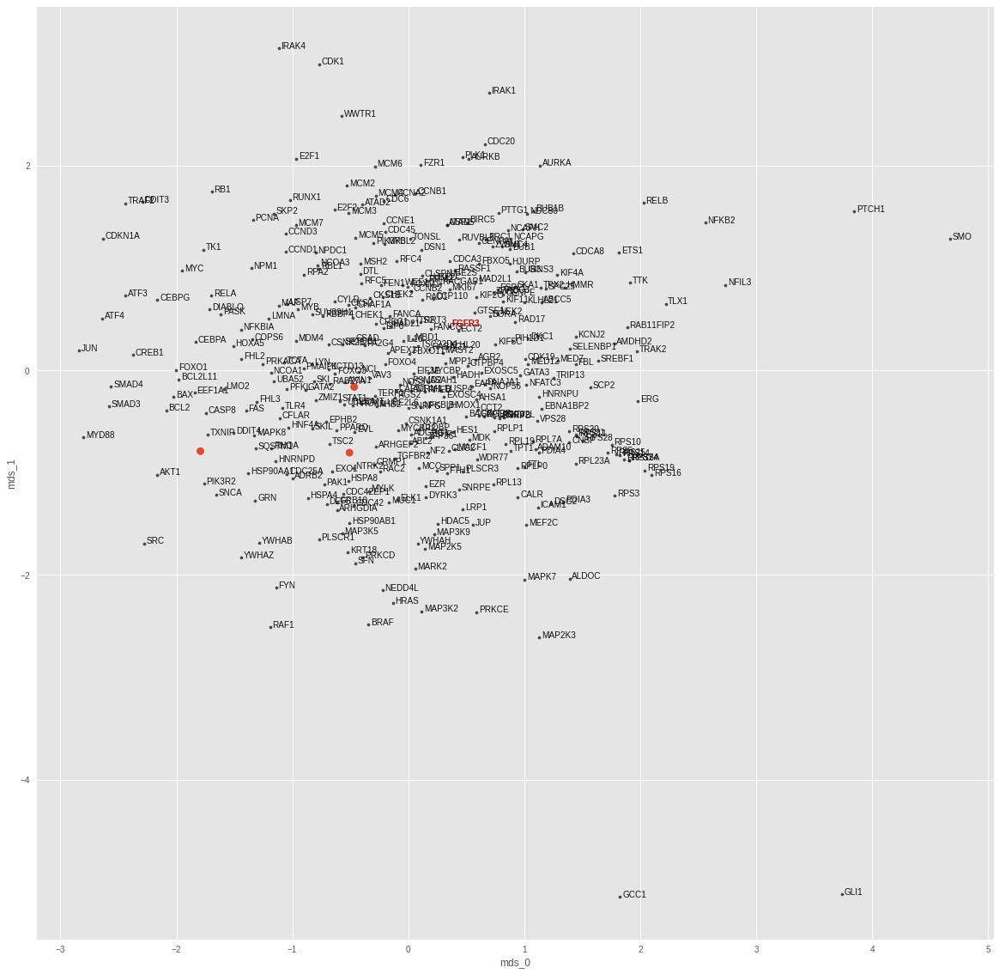

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0283775368038363e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.010036495514214039
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


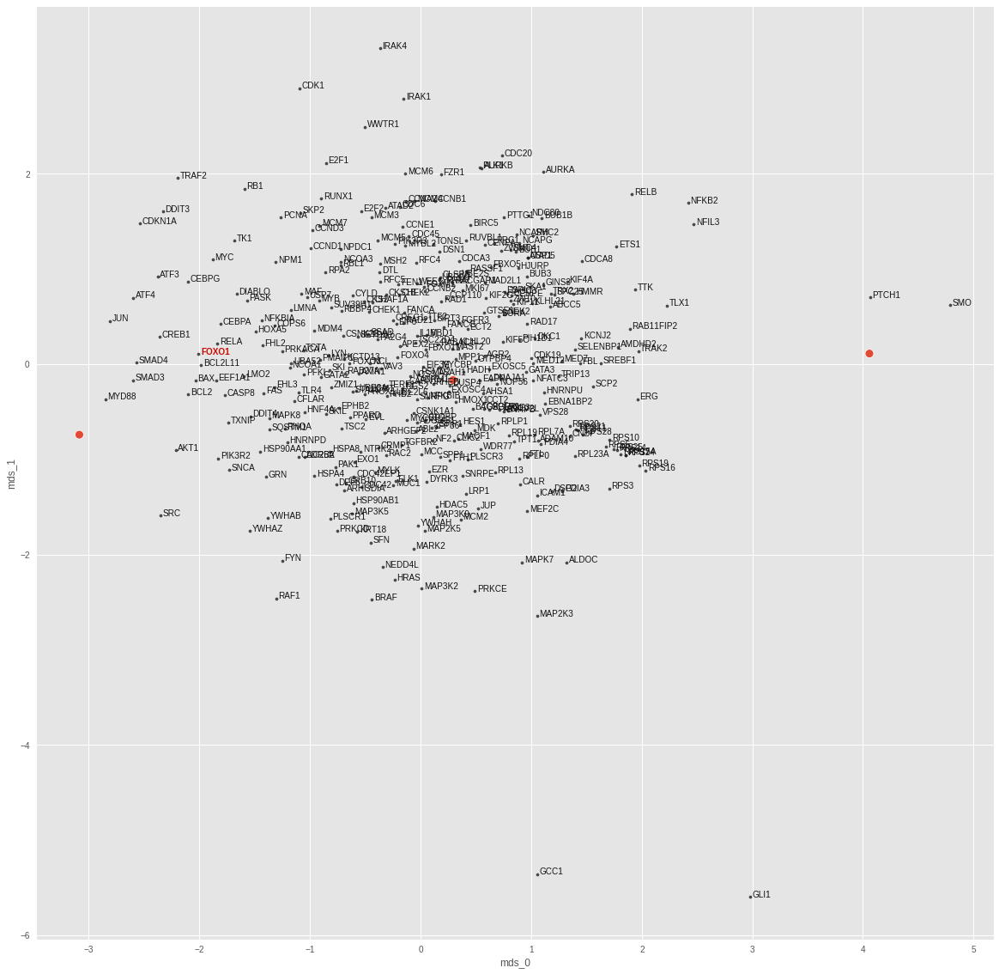

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.346604668747671e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.04604046791791916
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


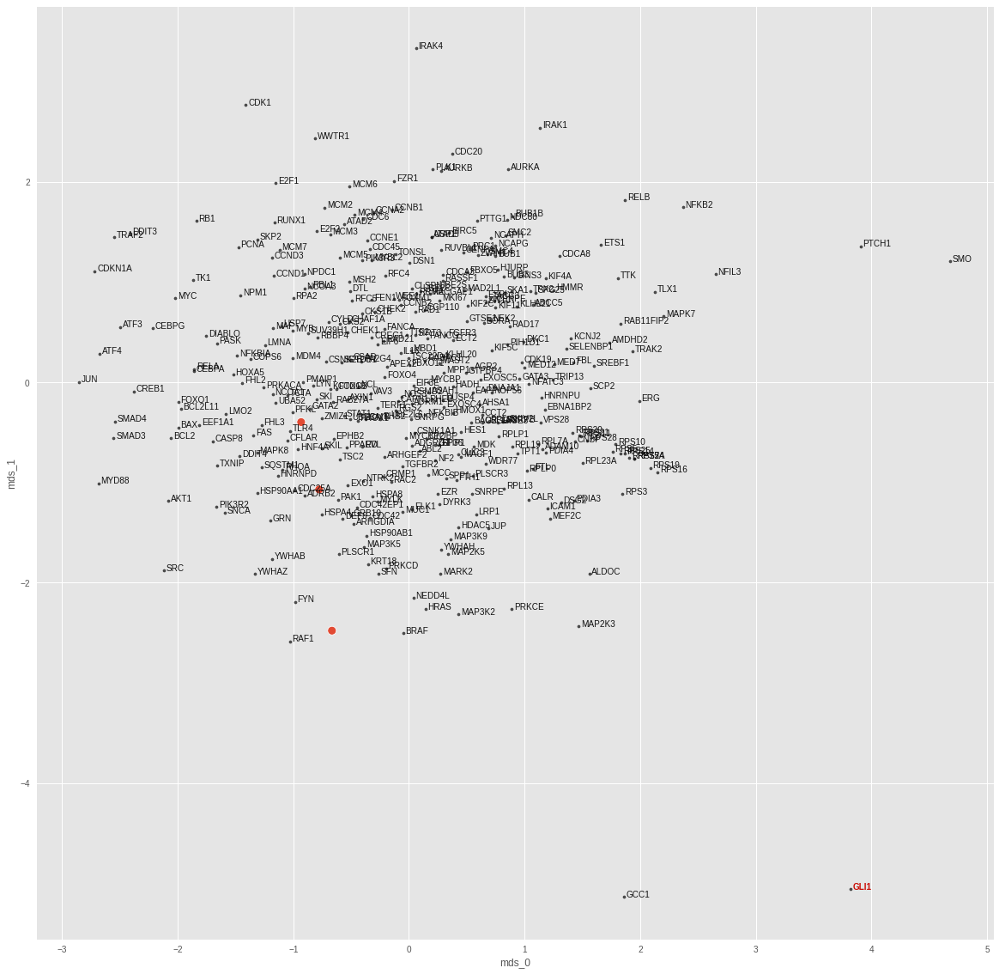

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 4.7766045329128475e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0032243027817457914
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


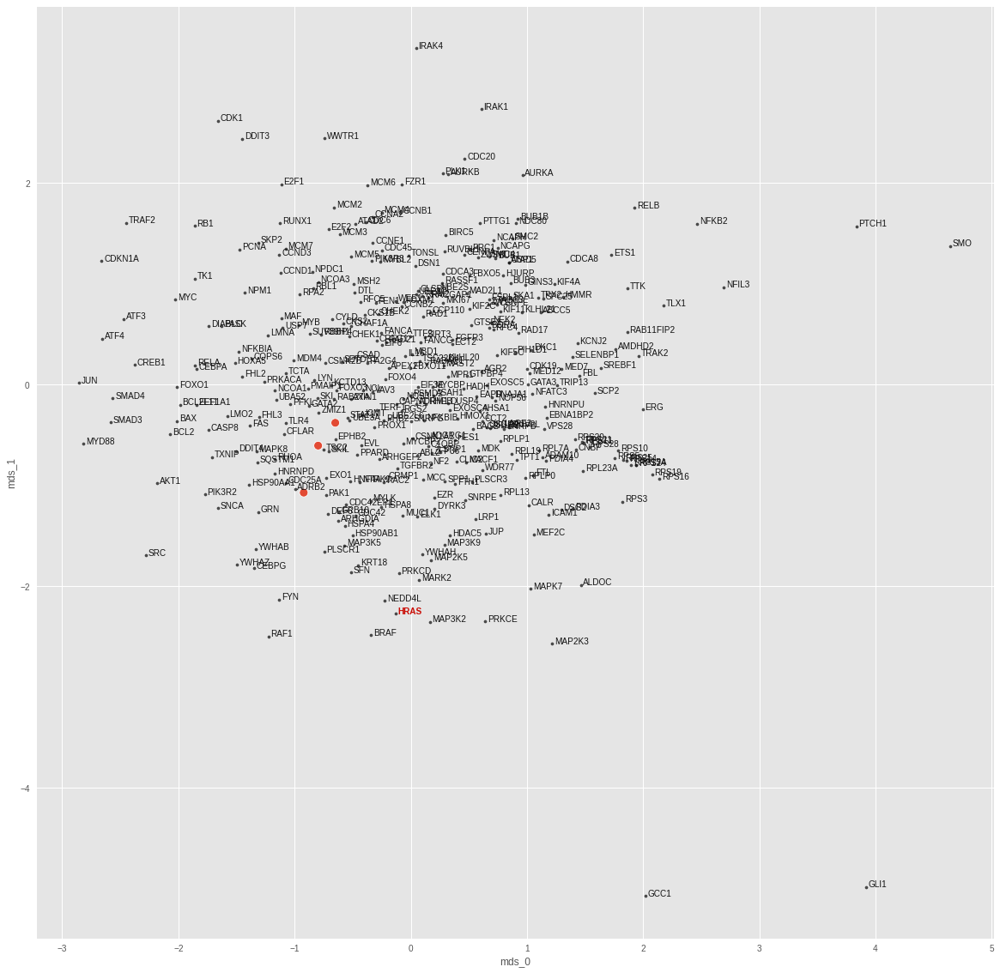

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.115285061911243e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.015191543847322464
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


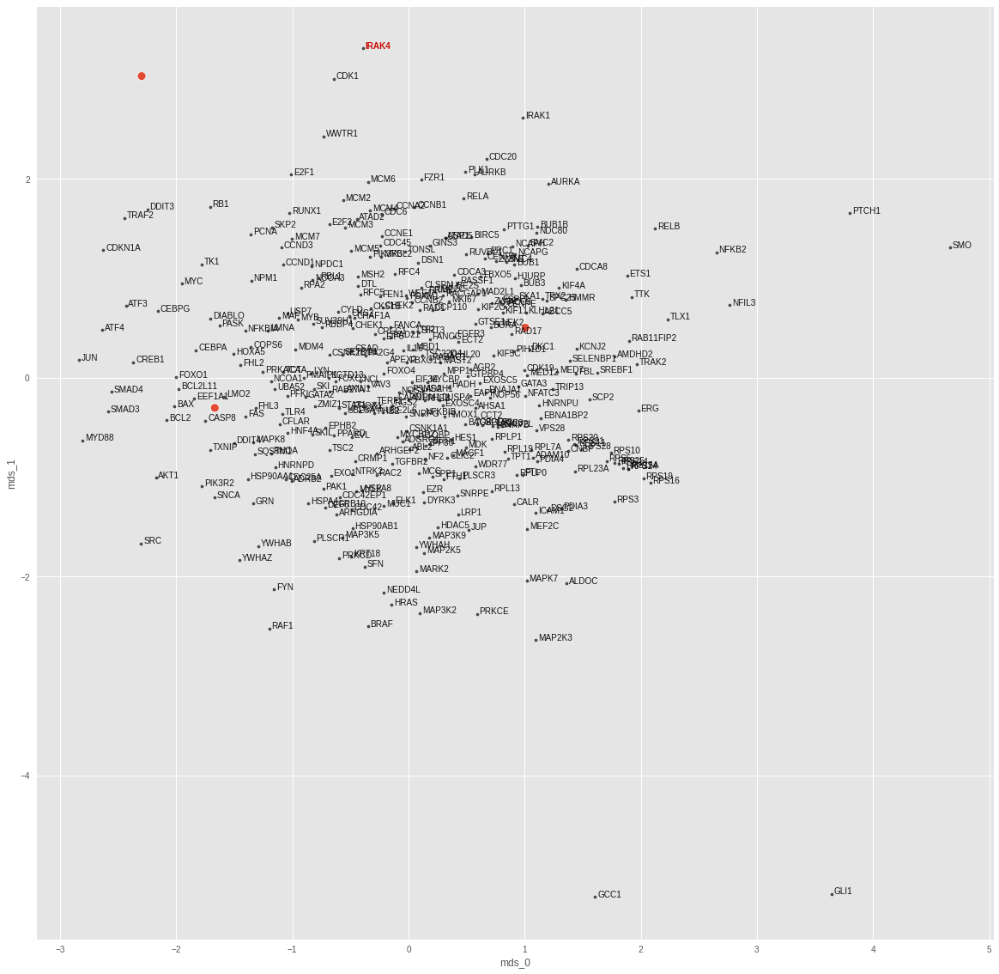

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.8800346395863443e-05
train top-k accuracies: {1: 0.990991, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.007067187689244747
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


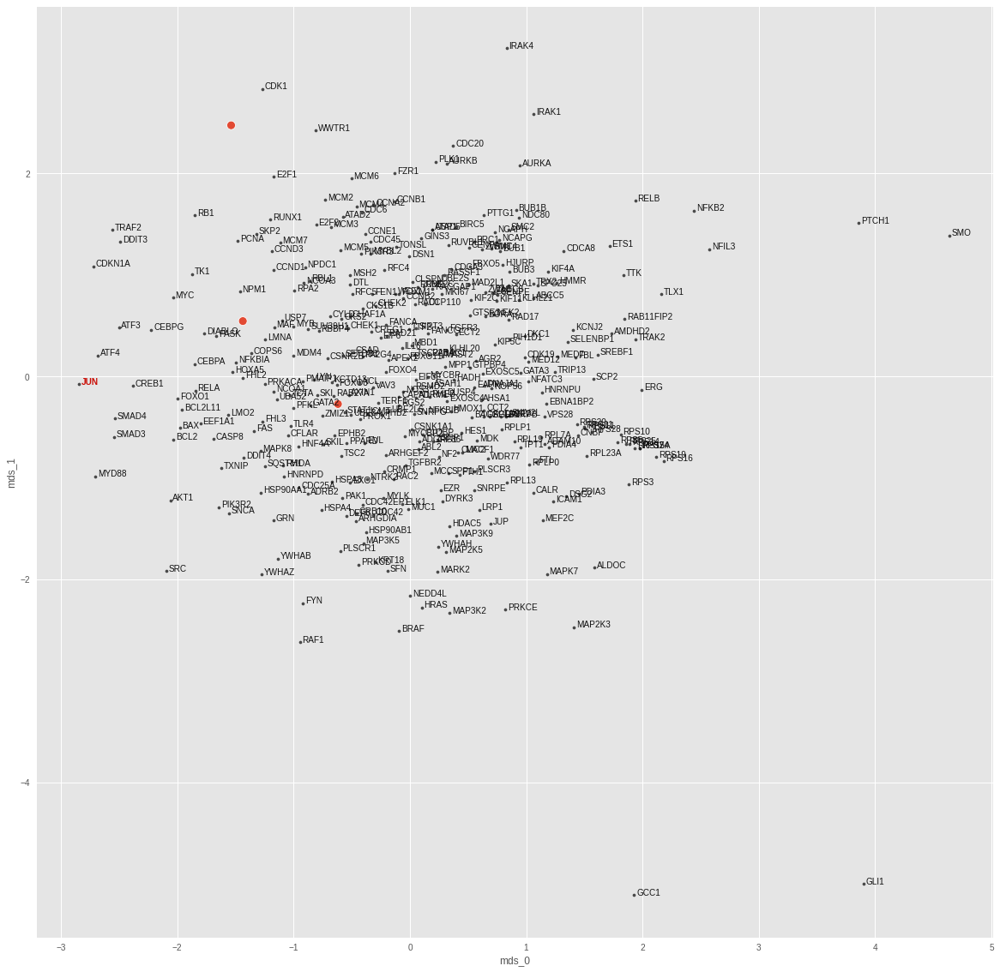

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0625717116020062e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.007903519086539745
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


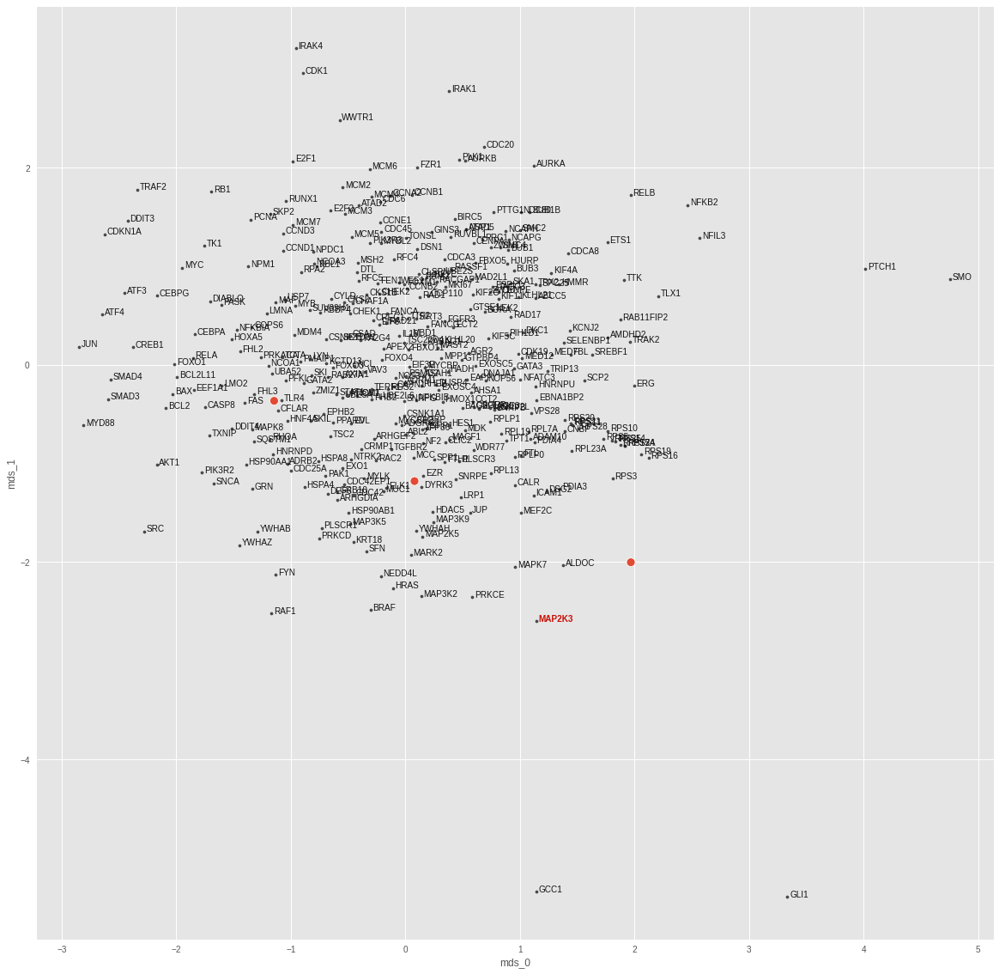

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 3.884795770883667e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0032725378405302763
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


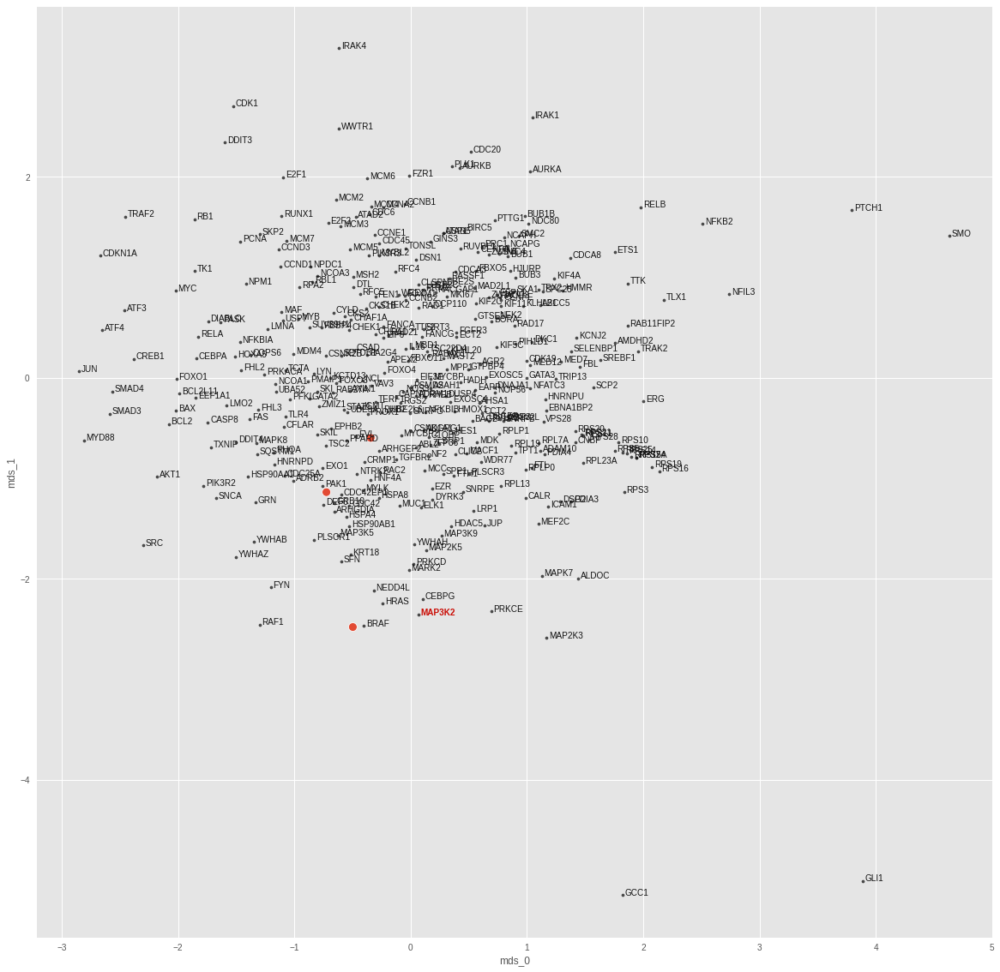

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 4.152778331502361e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004188411869108677
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


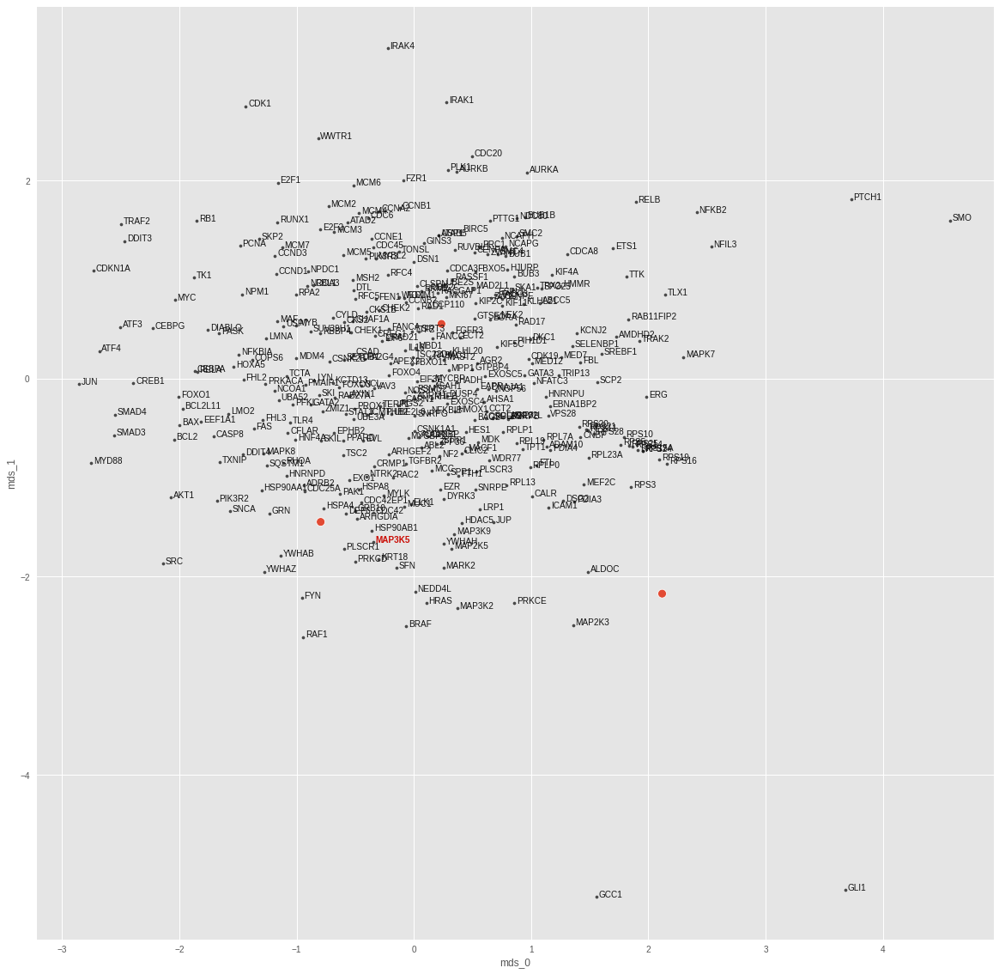

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.3890707950767964e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0032076488714665174
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


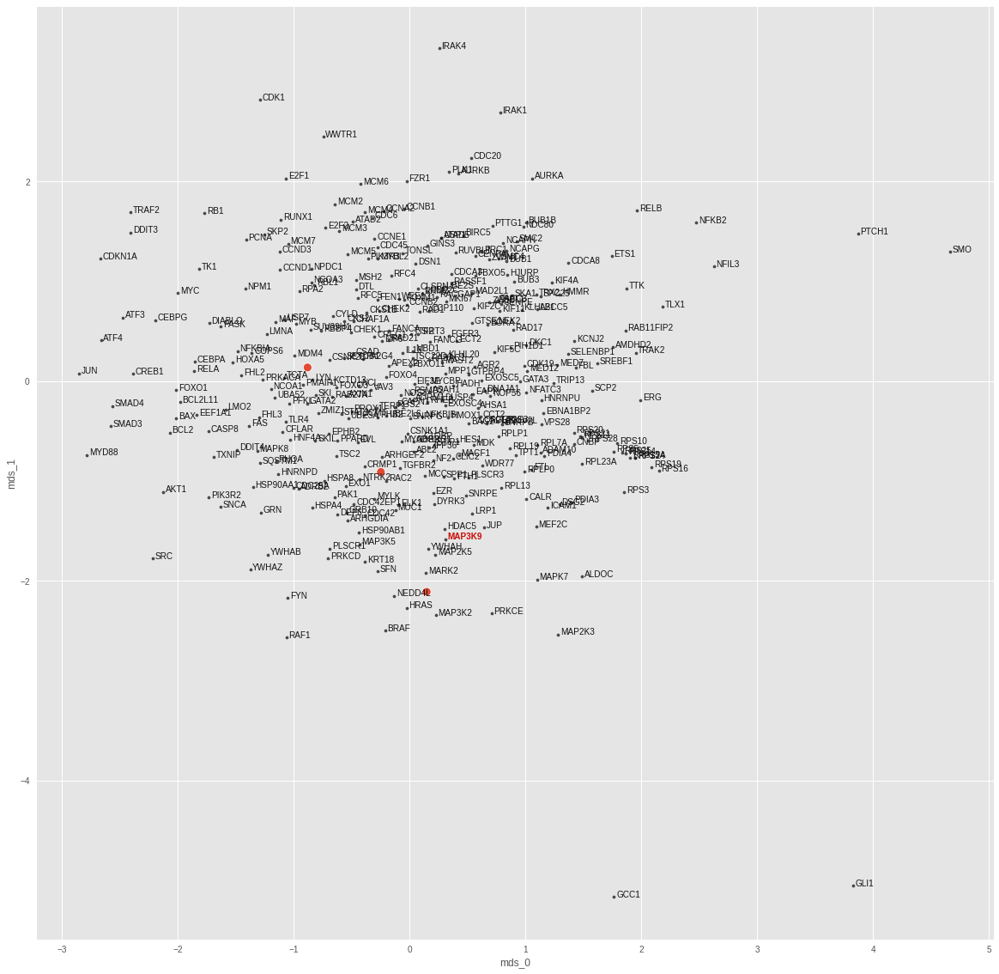

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.421737756075648e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005597766488790512
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


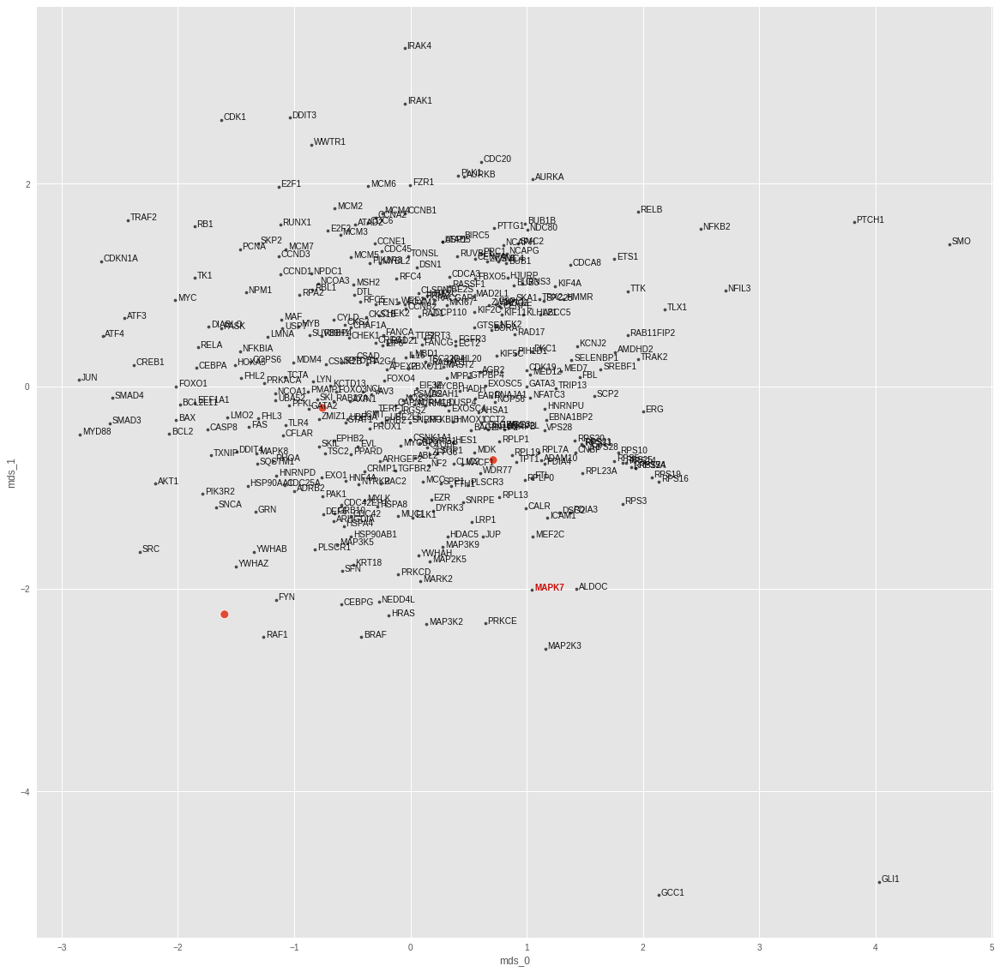

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.88588967547345e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.013800837099552155
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


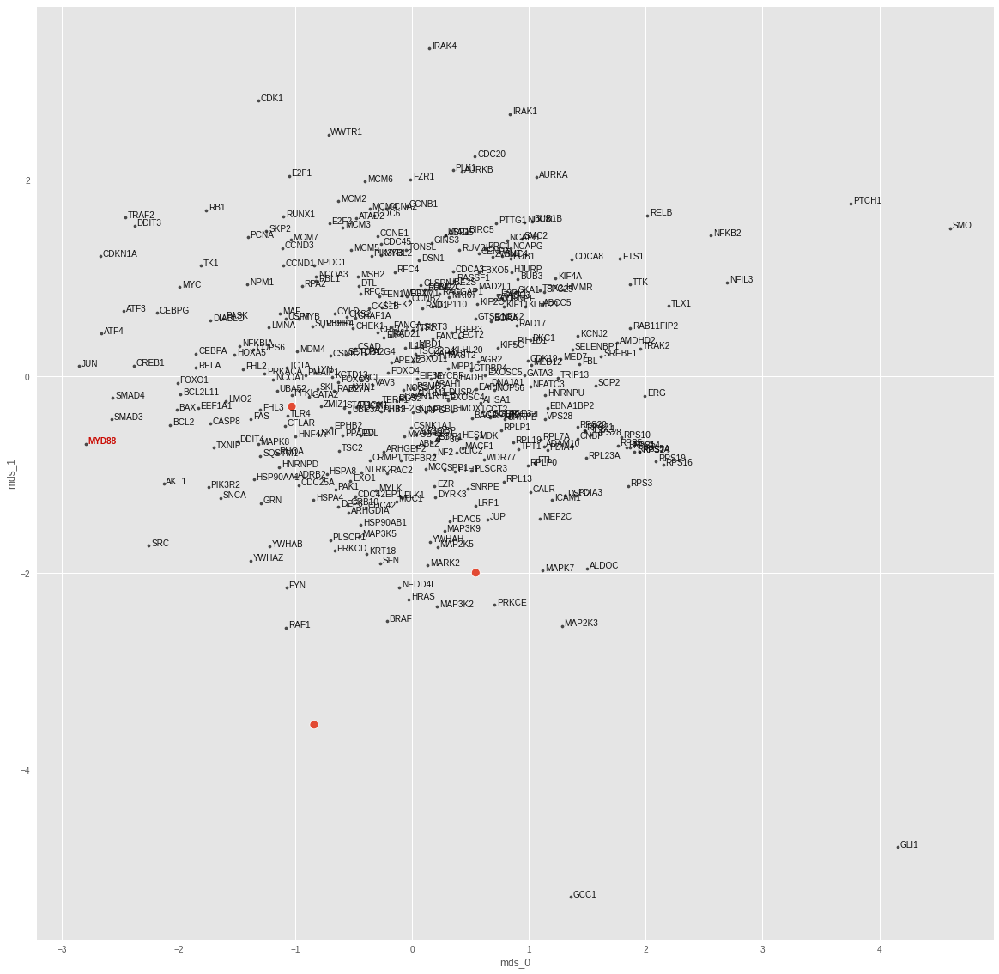

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

<IPython.core.display.Javascript object>

In [46]:
target_topk_accs = {}
cl_nonlin_nns_dict = {}
for i in tqdm(range(len(cl_data_dicts))):
    data_dict = cl_data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, _, mean_topk_acc, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = mean_topk_acc
    cl_nonlin_nns_dict[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [ ]:
cl_nonlin_topk_df = pd.DataFrame(target_topk_accs).transpose()
cl_nonlin_topk_df.loc[cl_nonlin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

In [ ]:
cl_nonlin_topk_df.describe()

In [ ]:
cl_nonlin_results = {"topk_acc": [], "k": []}
ks = list(range(50))
cl_nonlin_nn_topk = get_topk_acc_from_nn_dict(cl_nonlin_nns_dict, ks=ks)
cl_nonlin_result = cl_nonlin_nn_topk.mean()
for k in ks:
    cl_nonlin_results["topk_acc"].append(cl_nonlin_result.loc["top-{}".format(k)])
    cl_nonlin_results["k"].append(k)
cl_nonlin_results = pd.DataFrame(cl_nonlin_results)

In [ ]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.lineplot(
    data=random_lin_comb_results.loc[random_lin_comb_results.n == "1"],
    x="k",
    y="topk_acc",
    ax=ax,
    label="random",
)
ax.plot(
    np.array(lin_comb_results.loc[lin_comb_results.n == "1", "k"]),
    np.array(lin_comb_results.loc[lin_comb_results.n == "1", "topk_acc"]),
    label="physical_1nn",
    color="blue",
)
ax.plot(
    np.array(lin_comb_results.loc[lin_comb_results.n == "37", "k"]),
    np.array(lin_comb_results.loc[lin_comb_results.n == "37", "topk_acc"]),
    label="physical_all_nn",
    color="green",
)
ax.plot(
    np.array(mean_lin_results.loc[:, "k"]),
    np.array(mean_lin_results.loc[:, "topk_acc"]),
    label="mean_lin",
    color="purple",
)
ax.plot(
    np.array(mean_nonlin_results.loc[:, "k"]),
    np.array(mean_nonlin_results.loc[:, "topk_acc"]),
    label="mean_nonlin",
    color="orange",
)
ax.plot(
    np.array(cl_lin_results.loc[:, "k"]),
    np.array(cl_lin_results.loc[:, "topk_acc"]),
    label="cl_lin",
    color="pink",
)
ax.plot(
    np.array(cl_nonlin_results.loc[:, "k"]),
    np.array(cl_nonlin_results.loc[:, "topk_acc"]),
    label="cl_nonlin",
    color="brown",
)
ax.legend()
ax.set_ylim([0, 0.725])
plt.show()